## Figure 2 A,B,C: correlation between RNA and ATAC

- last updated: 10/3/2024
- Author: Yang-Joon Kim

- (1) aggregating the count matrices using Metacells (SEACells) - for both RNA and ATAC (gene.activity)
- (2) computing the "gene-level" correlation between RNA and ATAC (gene.activity) across metacells - for each gene. So, we'll have correlation coeff. for each gene, and can get a distribution (histogram) of the correlation coeff., at each timepoint, and monitor how that correlation changes over time - this is a metacell level measure of how RNA/ATAC changes over time.




# Imports

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
from scipy.stats import pearsonr

import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
# Some plotting aesthetics
%matplotlib inline

sns.set_style('ticks')
matplotlib.rcParams['figure.figsize'] = [4, 4]
matplotlib.rcParams['figure.dpi'] = 100

In [3]:
import logging

# Set the logging level to WARN, filtering out informational messages
logging.getLogger().setLevel(logging.WARNING)

import matplotlib as mpl
mpl.rcParams.update(mpl.rcParamsDefault) #Reset rcParams to default

# Set the default font to Arial
mpl.rcParams['font.family'] = 'Arial'

# If Arial is not available on your system, you might need to specify an alternative or ensure Arial is installed.
# On some systems, you might need to use 'font.sans-serif' as a fallback option:
# mpl.rcParams['font.sans-serif'] = 'Arial'

# Editable text and proper LaTeX fonts in illustrator
# matplotlib.rcParams['ps.useafm'] = True
# Editable fonts. 42 is the magic number for editable text in PDFs
mpl.rcParams['pdf.fonttype'] = 42
sns.set(style='whitegrid', context='paper')

# Plotting style function (run this before plotting the final figure)
def set_plotting_style():
    plt.style.use('seaborn-paper')
    plt.rc('axes', labelsize=12)
    plt.rc('axes', titlesize=12)
    plt.rc('xtick', labelsize=10)
    plt.rc('ytick', labelsize=10)
    plt.rc('legend', fontsize=10)
    plt.rc('text.latex', preamble=r'\usepackage{sfmath}')
    plt.rc('xtick.major', pad=2)
    plt.rc('ytick.major', pad=2)
    plt.rc('mathtext', fontset='stixsans', sf='sansserif')
    plt.rc('figure', figsize=[10,9])
    plt.rc('svg', fonttype='none')

    # Override any previously set font settings to ensure Arial is used
    plt.rc('font', family='Arial')

## NOTES

The correlation between RNA and ATAC (gene.activity) was computed by the following steps:

- 1) import integrated RNA/ATAC objects, respectively (ATAC has gene.activity)
- 2) subset for each timepoint, import the SEACell information (metacells), then aggregate the counts (RNA/gene.activity)
- 3) compute the pearson correlation coefficients between RNA and gene.activity for each gene, then save as dataframes

## Step 1. Load the datasets

In [4]:
figpath = "/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/zebrahub-multiome-analysis/figures/RNA_ATAC_corr_seacells/"

In [5]:
# Load the RNA and ATAC(gene.activity) master object, then subset for each timepoint/dataset
filepath = '/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/01_Signac_processed/'

# RNA master object (all timepoints/datasets)
adata_RNA = sc.read_h5ad(filepath + "integrated_RNA_ATAC_counts_RNA_master_filtered.h5ad")
print(adata_RNA)

# ATAC (gene.acitivitiy) master object (all timepoints/datasets)
adata_ATAC = sc.read_h5ad(filepath + "integrated_RNA_ATAC_counts_gene_activity_raw_counts_master_filtered.h5ad")
print(adata_ATAC)

AnnData object with n_obs × n_vars = 94562 × 32057
    obs: 'orig_ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS_enrichment', 'TSS_percentile', 'nCount_SCT', 'nFeature_SCT', 'global_annotation', 'nCount_peaks_bulk', 'nFeature_peaks_bulk', 'nCount_peaks_celltype', 'nFeature_peaks_celltype', 'nCount_peaks_merged', 'nFeature_peaks_merged', 'SCT_weight', 'peaks_merged_weight', 'nCount_Gene_Activity', 'nFeature_Gene_Activity', 'nCount_peaks_integrated', 'nFeature_peaks_integrated', 'dataset', 'integrated_weight', 'peaks_integrated_weight', 'wsnn_res_0_8', 'seurat_clusters', 'data_source', 'annotation_ML', 'scANVI_zscape', 'annotation_ML_coarse', 'dev_stage'
    var: 'features'
    uns: 'annotation_ML_coarse_colors', 'annotation_ML_colors', 'dataset_colors', 'global_annotation_colors', 'log1p', 'scANVI_zscape_colors'
    obsm: 'X_umap.atac', 'X_umap.rna', 'X_wnn.umap'
    layers: 'counts'
AnnData object with n_obs × n_

### NOTE. summarized anndata objects for RNA and ATAC were generated by compute_seacells_atac.py script for each dataset

### generate a UMAP highlighting SEACells along with single-cells colored by the celltypes

- TDR126 (10hpf)

In [10]:
adata = sc.read_h5ad("/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/05_SEACells_processed/TDR126_seacells_annotation_ML_coarse.h5ad")
adata

AnnData object with n_obs × n_vars = 14970 × 491782
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS.enrichment', 'TSS.percentile', 'nCount_SCT', 'nFeature_SCT', 'global_annotation', 'nCount_peaks_bulk', 'nFeature_peaks_bulk', 'nCount_peaks_celltype', 'nFeature_peaks_celltype', 'nCount_peaks_merged', 'nFeature_peaks_merged', 'SCT.weight', 'peaks_merged.weight', 'nCount_Gene.Activity', 'nFeature_Gene.Activity', 'annotation_ML', 'scANVI_zscape', 'annotation_ML_coarse', 'dev_stage', 'SEACell'
    var: 'count', 'percentile'
    uns: 'neighbors'
    obsm: 'X_lsi', 'X_umap.atac', 'X_umap.joint', 'X_umap.rna'
    varm: 'LSI'
    obsp: 'connectivities', 'distances'

In [14]:
# reset the colors
# a color palette for the "coarse" grained celltype annotation ("annotation_ML_coarse")
cell_type_color_dict = {
    'NMPs': '#8dd3c7',
    'PSM': '#008080',
    'differentiating_neurons': '#bebada',
    'endocrine_pancreas': '#fb8072',
    'endoderm': '#80b1d3',
    'enteric_neurons': '#fdb462',
    'epidermis': '#b3de69',
    'fast_muscle': '#df4b9b',
    'floor_plate': '#d9d9d9',
    'hatching_gland': '#bc80bd',
    'heart_myocardium': '#ccebc5',
    'hemangioblasts': '#ffed6f',
    'hematopoietic_vasculature': '#e41a1c',
    'hindbrain': '#377eb8',
    'lateral_plate_mesoderm': '#4daf4a',
    'midbrain_hindbrain_boundary': '#984ea3',
    'muscle': '#ff7f00',
    'neural': '#e6ab02',
    'neural_crest': '#a65628',
    'neural_floor_plate': '#66a61e',
    'neural_optic': '#999999',
    'neural_posterior': '#393b7f',
    'neural_telencephalon': '#fdcdac',
    'neurons': '#cbd5e8',
    'notochord': '#f4cae4',
    'optic_cup': '#c0c000',
    'pharyngeal_arches': '#fff2ae',
    'primordial_germ_cells': '#f1e2cc',
    'pronephros': '#cccccc',
    'somites': '#1b9e77',
    'spinal_cord': '#d95f02',
    'tail_bud': '#7570b3'
}

/home/yang-joon.kim/.local/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


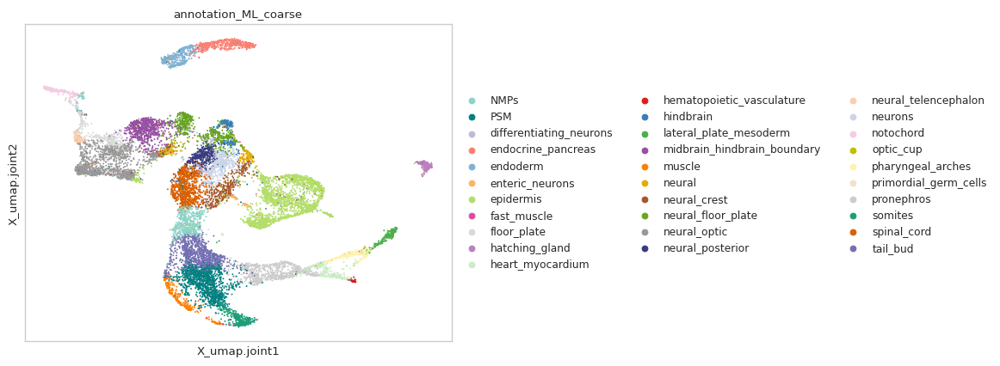

In [15]:
sc.pl.embedding(adata, basis="X_umap.joint", color="annotation_ML_coarse", palette=cell_type_color_dict)

### plot the metacells on top of the single-cells

In [36]:
def compute_prevalent_celltype_per_metacell(adata, celltype_key="annotation_ML_coarse", metacell_key="SEACell"):
    """
    Compute the most prevalent cell type in each metacell.
    
    :param adata: AnnData object containing the cell type and metacell information in .obs.
    :param celltype_key: (str) Key in adata.obs for cell types (e.g., 'annotation_ML_coarse').
    :param metacell_key: (str) Key in adata.obs for metacells (e.g., 'SEACell').
    :return: A pandas Series where the index is the metacell and the value is the most prevalent cell type.
    """
    
    # Extract the relevant columns from adata.obs
    df = adata.obs[[celltype_key, metacell_key]].copy()

    # Group by metacell and count occurrences of each cell type
    prevalent_celltypes = df.groupby(metacell_key)[celltype_key] \
                            .apply(lambda x: x.value_counts().idxmax())
    
    return prevalent_celltypes

def plot_2D_with_metacells(
    ad,
    key="X_umap.joint",  # Adjusted to your embedding
    hue="annotation_ML_coarse",  # Categorical variable for cell type
    metacell_key="SEACell",  # Key for metacells
    title="UMAP with Metacells",
    palette=None,  # Custom palette
    SEACell_size=50,  # Adjusted size for metacells
    cell_size=10,  # Size for cells
):
    """Plot 2D visualization of cells colored by their type and overlay metacells.
    
    :param ad: AnnData object
    :param key: (str) 2D embedding of data. Default: 'X_umap.joint'
    :param hue: (str) Categorical variable in .obs for coloring cells
    :param metacell_key: (str) Categorical variable for metacell assignment in .obs
    :param title: (str) Title for the plot
    :param palette: (dict or str) Color palette for cell types
    :param SEACell_size: (int) Size for metacell points
    :param cell_size: (int) Size for cell points
    """

    # Prepare data
    umap = pd.DataFrame(ad.obsm[key]).set_index(ad.obs_names).join(ad.obs[[hue, metacell_key]])
    umap[hue] = umap[hue].astype("category")
    umap[metacell_key] = umap[metacell_key].astype("category")

    # Get metacell centroids
    mcs = umap.groupby(metacell_key).mean().reset_index()

    # Compute the most prevalent cell type for each metacell
    prevalent_celltypes = compute_prevalent_celltype_per_metacell(ad, celltype_key=hue, metacell_key=metacell_key)

    # Add the most prevalent cell type to the metacell dataframe
    mcs[hue] = mcs[metacell_key].map(prevalent_celltypes)

    # Create figure
    fig, ax = plt.subplots(figsize=(8, 8))

    # Plot cells by annotation_ML_coarse (cell types)
    sns.scatterplot(
        x=0, y=1, hue=hue, data=umap, s=cell_size, 
        palette=palette, legend=None, ax=ax
    )

    # Overlay metacells on top of the UMAP plot
    sns.scatterplot(
        x=0, y=1, hue=hue, data=mcs, s=SEACell_size, 
        palette=palette, edgecolor="black", linewidth=1.25, legend=None, ax=ax
    )

    # Adjust plot
    ax.set_xlabel(f"{key}-0")
    ax.set_ylabel(f"{key}-1")
    # ax.set_title(title)
    ax.set_axis_off()

    return fig

/tmp/ipykernel_2173805/187543744.py:48: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  mcs = umap.groupby(metacell_key).mean().reset_index()


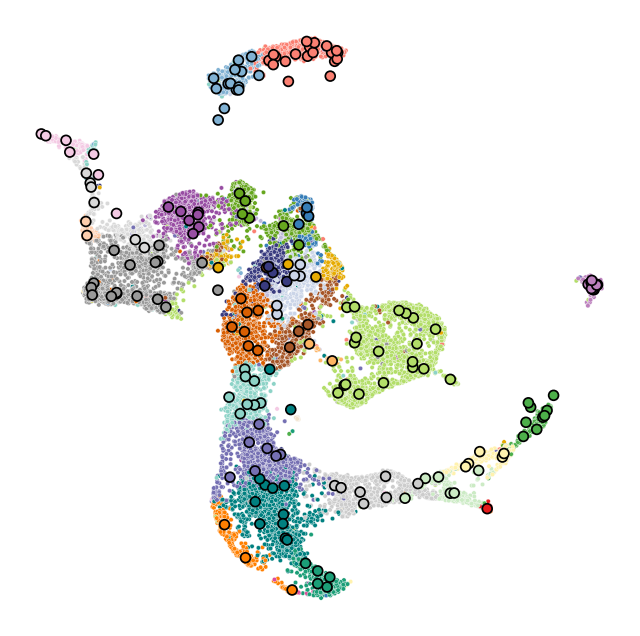

In [40]:
fig = plot_2D_with_metacells(adata, key="X_umap.joint", hue="annotation_ML_coarse", palette=cell_type_color_dict)
plt.savefig(figpath + "umap_TDR126_metacells.png")
plt.show()

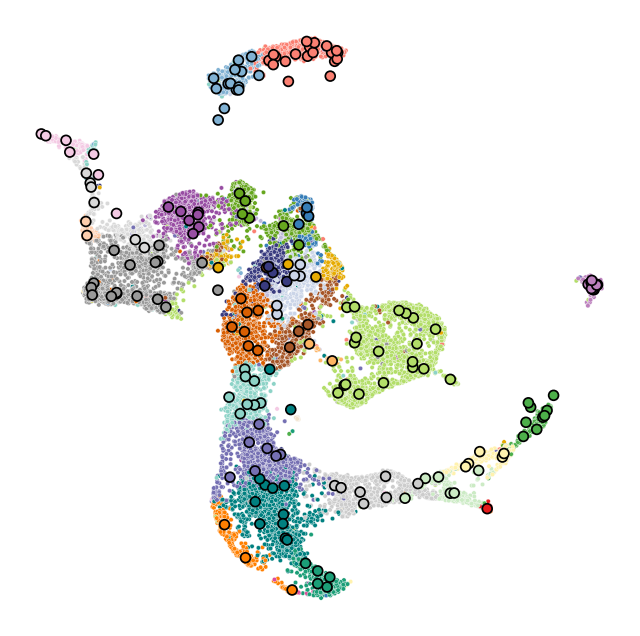

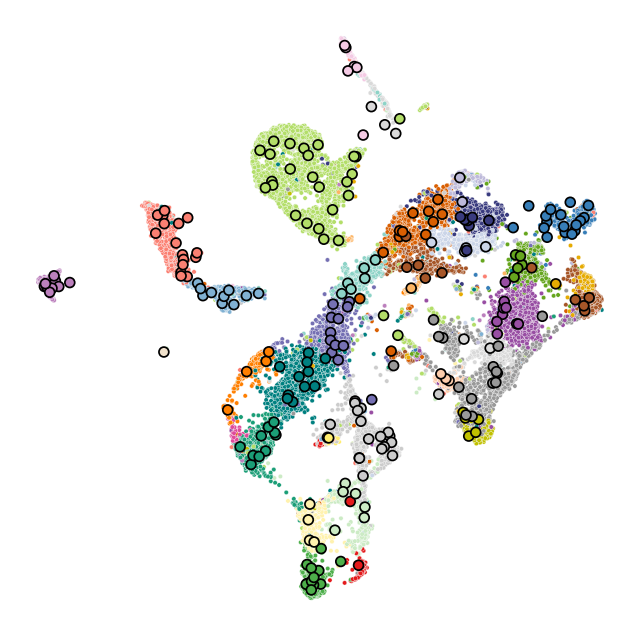

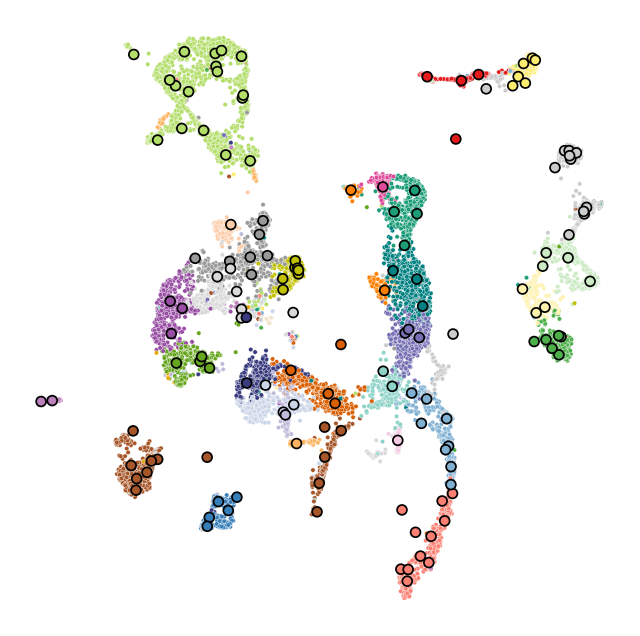

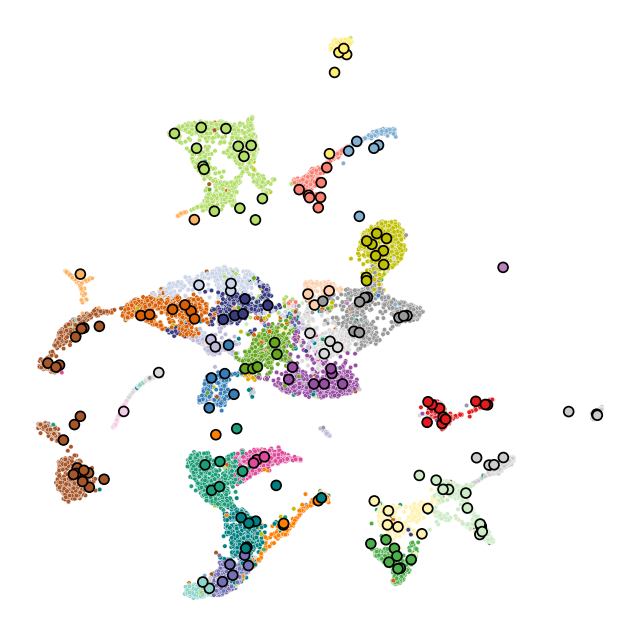

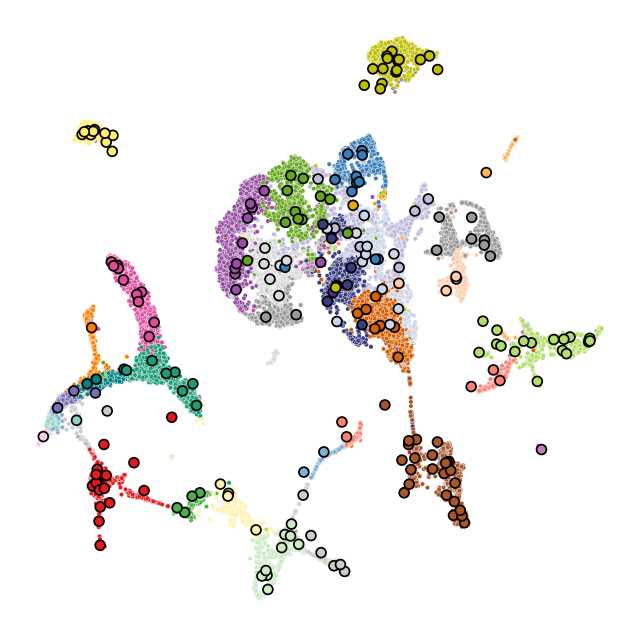

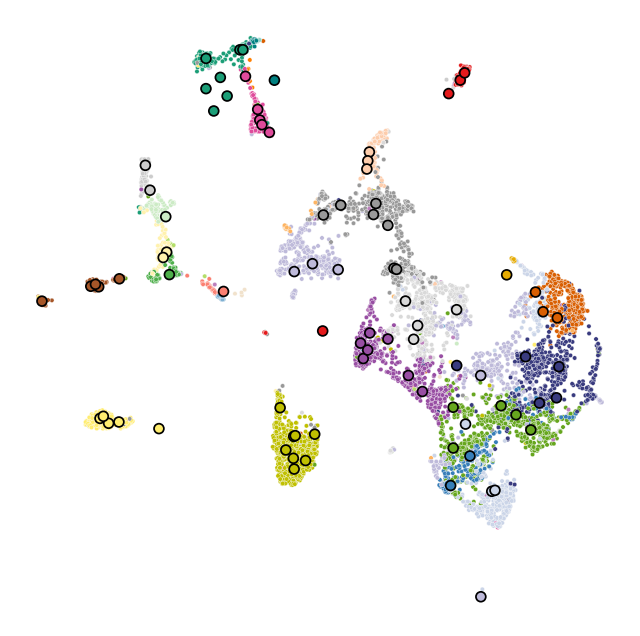

In [372]:
# generate these UMAPs for all datasets
filepath = "/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/05_SEACells_processed/"

# for loop to go through all datasets, then generate these plots
for data_id in list_data:
    adata = sc.read_h5ad(filepath + f"{data_id}_seacells_annotation_ML_coarse.h5ad")
    
    fig = plot_2D_with_metacells(adata, key="X_umap.joint", hue="annotation_ML_coarse", palette=cell_type_color_dict)
    plt.savefig(figpath + f"umap_{data_id}_metacells.png")
    plt.show()
    

## Step 2. visualize the ATAC/RNA (mean/median over metacells) over time

In [54]:
metacell_path = "/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/05_SEACells_processed/" 
data_id = "TDR126"
rna_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_id}_RNA_seacells_aggre.h5ad")
atac_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_id}_ATAC_seacells_aggre.h5ad")

In [46]:
rna_meta_ad

AnnData object with n_obs × n_vars = 199 × 32057
    obs: 'n_counts'
    uns: 'log1p'
    layers: 'raw'

In [56]:
# First, we'll subset the features that are shared between RNA and ATAC (gene names)
shared_genes = np.intersect1d(rna_meta_ad.var_names, atac_meta_ad.var_names)
print(f"Number of shared genes: {len(shared_genes)}")

# subset the RNA and ATAC objects for the shared genes
rna_meta_ad = rna_meta_ad[:, shared_genes]
atac_meta_ad = atac_meta_ad[:, shared_genes]

Number of shared genes: 24942


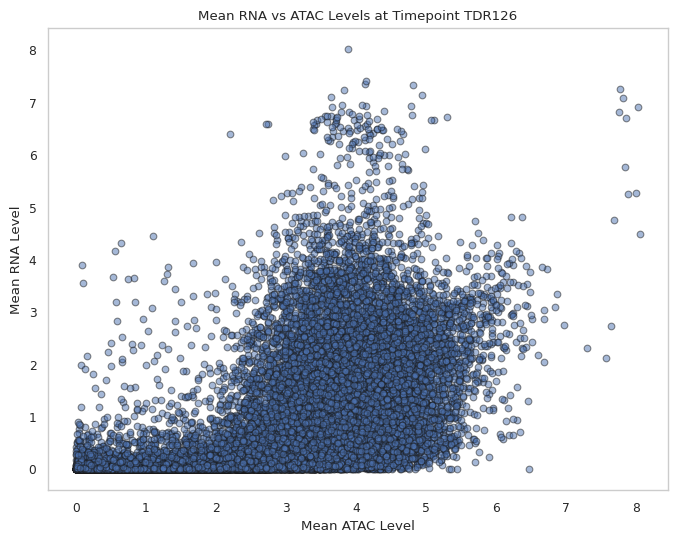

In [75]:
import scipy as sci

metacell_path = "/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/05_SEACells_processed/" 
data_id = "TDR126"
rna_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_id}_RNA_seacells_aggre.h5ad")
atac_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_id}_ATAC_seacells_aggre.h5ad")

# First, we'll subset the features that are shared between RNA and ATAC (gene names)
shared_genes = np.intersect1d(rna_meta_ad.var_names, atac_meta_ad.var_names)
print(f"Number of shared genes: {len(shared_genes)}")

# subset the RNA and ATAC objects for the shared genes
rna_meta_ad = rna_meta_ad[:, shared_genes]
atac_meta_ad = atac_meta_ad[:, shared_genes]

if sci.sparse.issparse(rna_meta_ad.X):
    rna_mean = pd.DataFrame(
        rna_meta_ad.X.toarray(),
        columns=rna_meta_ad.var_names
    ).mean(axis=0)
else:
    rna_mean = pd.DataFrame(
        rna_meta_ad.X,
        columns=rna_meta_ad.var_names
    ).mean(axis=0)

# Similarly compute mean accessibility for ATAC
if sci.sparse.issparse(atac_meta_ad.X):
    atac_mean = pd.DataFrame(
        atac_meta_ad.X.toarray(),
        columns=atac_meta_ad.var_names
    ).mean(axis=0)
else:
    atac_mean = pd.DataFrame(
        atac_meta_ad.X,
        columns=atac_meta_ad.var_names
    ).mean(axis=0)

# Create DataFrames for RNA and ATAC means
rna_means_df = pd.DataFrame({
    'gene': rna_mean.index,
    'mean_RNA': rna_mean.values
})

atac_means_df = pd.DataFrame({
    'gene': atac_mean.index,
    'mean_ATAC': atac_mean.values
})

# Merge the two DataFrames on gene names
merged_means = pd.merge(rna_means_df, atac_means_df, on='gene', how='inner')

# Remove genes with zero mean in both datasets to avoid plotting unnecessary points
merged_means = merged_means[(merged_means['mean_RNA'] > 0) | (merged_means['mean_ATAC'] > 0)]

# Plot the scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(
    merged_means['mean_ATAC'],
    merged_means['mean_RNA'],
    alpha=0.5,
    edgecolor='k'
)
plt.xlabel('Mean ATAC Level')
plt.ylabel('Mean RNA Level')
plt.title(f'Mean RNA vs ATAC Levels at Timepoint {data_id}')
plt.grid(False)
plt.show()

Number of shared genes: 24942
Number of shared genes: 24943
Number of shared genes: 24936
Number of shared genes: 24923
Number of shared genes: 24940
Number of shared genes: 24889


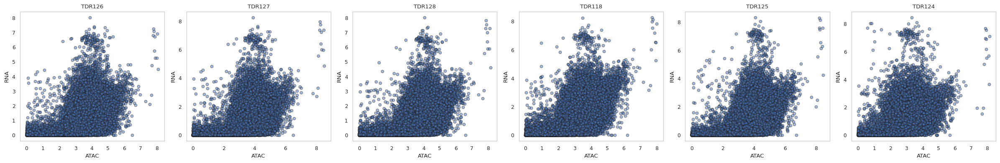

In [206]:
metacell_path = "/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/05_SEACells_processed/" 
list_data

# for data_id in list_data:
#     # import the rna and atac adata objects (aggregated over metacells)
#     data_name = data_id.strip("reseq")
#     rna_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_name}_RNA_seacells_aggre.h5ad")
#     atac_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_name}_ATAC_seacells_aggre.h5ad")

#     # First, we'll subset the features that are shared between RNA and ATAC (gene names)
#     shared_genes = np.intersect1d(rna_meta_ad.var_names, atac_meta_ad.var_names)
#     print(f"Number of shared genes: {len(shared_genes)}")

#     # subset the RNA and ATAC objects for the shared genes
#     rna_meta_ad = rna_meta_ad[:, shared_genes]
#     atac_meta_ad = atac_meta_ad[:, shared_genes]

#     if sci.sparse.issparse(rna_meta_ad.X):
#         rna_mean = pd.DataFrame(
#             rna_meta_ad.X.toarray(),
#             columns=rna_meta_ad.var_names
#         ).mean(axis=0)
#     else:
#         rna_mean = pd.DataFrame(
#             rna_meta_ad.X,
#             columns=rna_meta_ad.var_names
#         ).mean(axis=0)

#     # Similarly compute mean accessibility for ATAC
#     if sci.sparse.issparse(atac_meta_ad.X):
#         atac_mean = pd.DataFrame(
#             atac_meta_ad.X.toarray(),
#             columns=atac_meta_ad.var_names
#         ).mean(axis=0)
#     else:
#         atac_mean = pd.DataFrame(
#             atac_meta_ad.X,
#             columns=atac_meta_ad.var_names
#         ).mean(axis=0)

#     # Create DataFrames for RNA and ATAC means
#     rna_means_df = pd.DataFrame({
#         'gene': rna_mean.index,
#         'mean_RNA': rna_mean.values
#     })

#     atac_means_df = pd.DataFrame({
#         'gene': atac_mean.index,
#         'mean_ATAC': atac_mean.values
#     })

#     # Merge the two DataFrames on gene names
#     merged_means = pd.merge(rna_means_df, atac_means_df, on='gene', how='inner')

#     # Remove genes with zero mean in both datasets to avoid plotting unnecessary points
#     merged_means = merged_means[(merged_means['mean_RNA'] > 0) | (merged_means['mean_ATAC'] > 0)]

#     # Plot the scatter plot
#     plt.figure(figsize=(8, 6))
#     plt.scatter(
#         merged_means['mean_ATAC'],
#         merged_means['mean_RNA'],
#         alpha=0.5,
#         edgecolor='k'
#     )
#     plt.xlabel('averaged gene activity (ATAC)')
#     plt.ylabel('averaged gene expression (RNA)')
#     plt.title(f'mean ATAC vs RNA levels per gene at {data_name}')
#     plt.grid(False)
#     plt.show()
# Create a 1x6 subplot layout
fig, axes = plt.subplots(1, 6, figsize=(24, 4))  # (1 row, 6 columns)

for i, data_id in enumerate(list_data):
    # Import the RNA and ATAC adata objects (aggregated over metacells)
    data_name = data_id.strip("reseq")
    rna_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_name}_RNA_seacells_aggre.h5ad")
    atac_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_name}_ATAC_seacells_aggre.h5ad")

    # Subset the features that are shared between RNA and ATAC (gene names)
    shared_genes = np.intersect1d(rna_meta_ad.var_names, atac_meta_ad.var_names)
    print(f"Number of shared genes: {len(shared_genes)}")

    # Subset the RNA and ATAC objects for the shared genes
    rna_meta_ad = rna_meta_ad[:, shared_genes]
    atac_meta_ad = atac_meta_ad[:, shared_genes]

    # Compute mean RNA and ATAC levels per gene (across all metacells)
    if sci.sparse.issparse(rna_meta_ad.X):
        rna_mean = pd.DataFrame(
            rna_meta_ad.X.toarray(),
            columns=rna_meta_ad.var_names
        ).mean(axis=0)
    else:
        rna_mean = pd.DataFrame(
            rna_meta_ad.X,
            columns=rna_meta_ad.var_names
        ).mean(axis=0)

    if sci.sparse.issparse(atac_meta_ad.X):
        atac_mean = pd.DataFrame(
            atac_meta_ad.X.toarray(),
            columns=atac_meta_ad.var_names
        ).mean(axis=0)
    else:
        atac_mean = pd.DataFrame(
            atac_meta_ad.X,
            columns=atac_meta_ad.var_names
        ).mean(axis=0)

    # Create DataFrames for RNA and ATAC means
    rna_means_df = pd.DataFrame({
        'gene': rna_mean.index,
        'mean_RNA': rna_mean.values
    })

    atac_means_df = pd.DataFrame({
        'gene': atac_mean.index,
        'mean_ATAC': atac_mean.values
    })

    # Merge the two DataFrames on gene names
    merged_means = pd.merge(rna_means_df, atac_means_df, on='gene', how='inner')

    # Remove genes with zero mean in both datasets to avoid plotting unnecessary points
    merged_means = merged_means[(merged_means['mean_RNA'] > 0) | (merged_means['mean_ATAC'] > 0)]

    # Plot the scatter plot on the corresponding subplot axis
    ax = axes[i]  # Select the current subplot axis
    ax.scatter(
        merged_means['mean_ATAC'],
        merged_means['mean_RNA'],
        alpha=0.5,
        edgecolor='k'
    )
    ax.set_xlabel('ATAC')
    ax.set_ylabel('RNA')
    ax.set_title(f'{data_name}')
    ax.grid(False)

# Adjust layout and show the plots
plt.tight_layout()
plt.show()

Number of shared genes: 24942
Number of shared genes: 24943
Number of shared genes: 24936
Number of shared genes: 24923
Number of shared genes: 24940
Number of shared genes: 24889


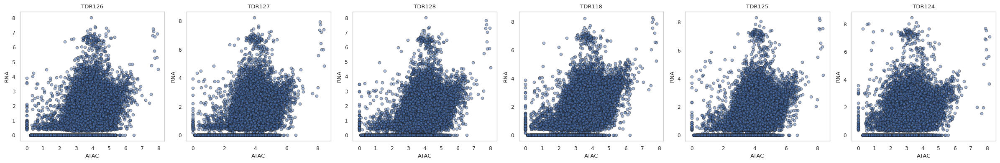

In [208]:
# Create a 1x6 subplot layout
fig, axes = plt.subplots(1, 6, figsize=(24, 4))  # (1 row, 6 columns)

for i, data_id in enumerate(list_data):
    # Import the RNA and ATAC adata objects (aggregated over metacells)
    data_name = data_id.strip("reseq")
    rna_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_name}_RNA_seacells_aggre.h5ad")
    atac_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_name}_ATAC_seacells_aggre.h5ad")

    # Subset the features that are shared between RNA and ATAC (gene names)
    shared_genes = np.intersect1d(rna_meta_ad.var_names, atac_meta_ad.var_names)
    print(f"Number of shared genes: {len(shared_genes)}")

    # Subset the RNA and ATAC objects for the shared genes
    rna_meta_ad = rna_meta_ad[:, shared_genes]
    atac_meta_ad = atac_meta_ad[:, shared_genes]

    # Compute median RNA and ATAC levels per gene (across all metacells)
    if sci.sparse.issparse(rna_meta_ad.X):
        rna_median = pd.DataFrame(
            rna_meta_ad.X.toarray(),
            columns=rna_meta_ad.var_names
        ).median(axis=0)
    else:
        rna_median = pd.DataFrame(
            rna_meta_ad.X,
            columns=rna_meta_ad.var_names
        ).median(axis=0)

    if sci.sparse.issparse(atac_meta_ad.X):
        atac_median = pd.DataFrame(
            atac_meta_ad.X.toarray(),
            columns=atac_meta_ad.var_names
        ).median(axis=0)
    else:
        atac_median = pd.DataFrame(
            atac_meta_ad.X,
            columns=atac_meta_ad.var_names
        ).median(axis=0)

    # Create DataFrames for RNA and ATAC medians
    rna_medians_df = pd.DataFrame({
        'gene': rna_median.index,
        'median_RNA': rna_median.values
    })

    atac_medians_df = pd.DataFrame({
        'gene': atac_median.index,
        'median_ATAC': atac_median.values
    })

    # Merge the two DataFrames on gene names
    merged_medians = pd.merge(rna_medians_df, atac_medians_df, on='gene', how='inner')

    # Remove genes with zero median in both datasets to avoid plotting unnecessary points
    merged_medians = merged_medians[(merged_medians['median_RNA'] > 0) | (merged_medians['median_ATAC'] > 0)]

    # Plot the scatter plot on the corresponding subplot axis
    ax = axes[i]  # Select the current subplot axis
    ax.scatter(
        merged_medians['median_ATAC'],
        merged_medians['median_RNA'],
        alpha=0.5,
        edgecolor='k'
    )
    ax.set_xlabel('ATAC')
    ax.set_ylabel('RNA')
    ax.set_title(f'{data_name}')
    ax.grid(False)

# Adjust layout and show the plots
plt.tight_layout()
plt.show()


## Step 3. average ATAC/RNA per metacell (over all genes) per timepoint

Number of shared genes: 24942
Number of shared genes: 24943
Number of shared genes: 24936
Number of shared genes: 24923
Number of shared genes: 24940
Number of shared genes: 24889


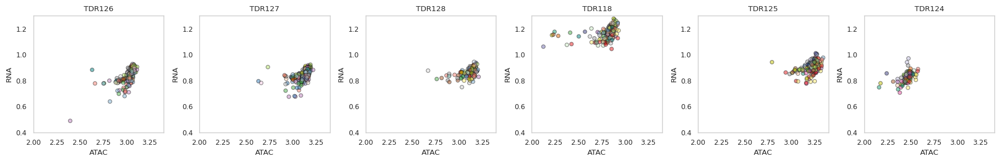

In [209]:
# Create a 1x6 subplot layout
fig, axes = plt.subplots(1, 6, figsize=(18, 3))  # (1 row, 6 columns)

for i, data_id in enumerate(list_data):
    # Import the RNA and ATAC adata objects (aggregated over metacells)
    data_name = data_id.strip("reseq")
    rna_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_name}_RNA_seacells_aggre.h5ad")
    atac_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_name}_ATAC_seacells_aggre.h5ad")
    
    # import the RNA adata (not aggregated)
    rna_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_name}_RNA_seacells.h5ad")
    # Compute the most prevalent cell type for each metacell
    prevalent_celltypes = compute_prevalent_celltype_per_metacell(rna_ad, celltype_key="annotation_ML_coarse", metacell_key="SEACell")
    # Map the prevalent cell types to the colors
    colors = prevalent_celltypes.map(cell_type_color_dict)

    # Subset the features that are shared between RNA and ATAC (gene names)
    shared_genes = np.intersect1d(rna_meta_ad.var_names, atac_meta_ad.var_names)
    print(f"Number of shared genes: {len(shared_genes)}")

    # Subset the RNA and ATAC objects for the shared genes
    rna_meta_ad = rna_meta_ad[:, shared_genes]
    atac_meta_ad = atac_meta_ad[:, shared_genes]

    # Compute mean RNA and ATAC levels per metacell (average across all shared genes)
    if sci.sparse.issparse(rna_meta_ad.X):
        rna_mean_per_metacell = pd.DataFrame(
            rna_meta_ad.X.toarray(),
            columns=rna_meta_ad.var_names
        ).mean(axis=1)
    else:
        rna_mean_per_metacell = pd.DataFrame(
            rna_meta_ad.X,
            columns=rna_meta_ad.var_names
        ).mean(axis=1)

    # Similarly, compute mean accessibility for ATAC per metacell
    if sci.sparse.issparse(atac_meta_ad.X):
        atac_mean_per_metacell = pd.DataFrame(
            atac_meta_ad.X.toarray(),
            columns=atac_meta_ad.var_names
        ).mean(axis=1)
    else:
        atac_mean_per_metacell = pd.DataFrame(
            atac_meta_ad.X,
            columns=atac_meta_ad.var_names
        ).mean(axis=1)

    # Create DataFrames for RNA and ATAC means per metacell
    rna_means_per_metacell_df = pd.DataFrame({
        'metacell': rna_meta_ad.obs.index,
        'mean_RNA_per_metacell': rna_mean_per_metacell.values
    })

    atac_means_per_metacell_df = pd.DataFrame({
        'metacell': atac_meta_ad.obs.index,
        'mean_ATAC_per_metacell': atac_mean_per_metacell.values
    })

    # Merge the two DataFrames on metacell names
    merged_means_per_metacell = pd.merge(rna_means_per_metacell_df, atac_means_per_metacell_df, on='metacell', how='inner')

    # Plot the scatter plot for metacells on the corresponding axis
    ax = axes[i]  # Select the current subplot axis
    ax.scatter(
        merged_means_per_metacell['mean_ATAC_per_metacell'],
        merged_means_per_metacell['mean_RNA_per_metacell'],
        alpha=0.5,
        edgecolor='k',
        c=colors.loc[merged_means_per_metacell['metacell']],
    )
    ax.set_xlim([2, 3.4])
    ax.set_ylim([0.4, 1.3])
    ax.set_xlabel('ATAC')
    ax.set_ylabel('RNA')
    ax.set_title(f'{data_name}')
    ax.grid(False)

# Adjust layout and show the plots
plt.tight_layout()
plt.savefig(figpath + "rna_atac_mean_per_metacell_all_timepoints_colored_celltypes.png")
plt.savefig(figpath + "rna_atac_mean_per_metacell_all_timepoints_colored_celltypes.pdf")
plt.show()

### median ATAC/RNA per metacell (over all genes) per timepoint

Number of shared genes: 24942
Number of shared genes: 24943
Number of shared genes: 24936
Number of shared genes: 24923
Number of shared genes: 24940
Number of shared genes: 24889


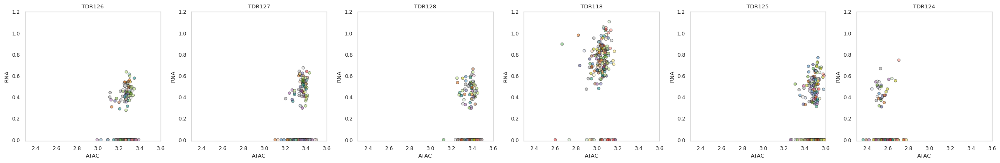

In [193]:
# Create a 1x6 subplot layout
fig, axes = plt.subplots(1, 6, figsize=(18, 3))  # (1 row, 6 columns)

for i, data_id in enumerate(list_data):
    # Import the RNA and ATAC adata objects (aggregated over metacells)
    data_name = data_id.strip("reseq")
    rna_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_name}_RNA_seacells_aggre.h5ad")
    atac_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_name}_ATAC_seacells_aggre.h5ad")
    
    # import the RNA adata (not aggregated)
    rna_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_name}_RNA_seacells.h5ad")
    # Compute the most prevalent cell type for each metacell
    prevalent_celltypes = compute_prevalent_celltype_per_metacell(rna_ad, celltype_key="annotation_ML_coarse", metacell_key="SEACell")
    # Map the prevalent cell types to the colors
    colors = prevalent_celltypes.map(cell_type_color_dict)

    # Subset the features that are shared between RNA and ATAC (gene names)
    shared_genes = np.intersect1d(rna_meta_ad.var_names, atac_meta_ad.var_names)
    print(f"Number of shared genes: {len(shared_genes)}")

    # Subset the RNA and ATAC objects for the shared genes
    rna_meta_ad = rna_meta_ad[:, shared_genes]
    atac_meta_ad = atac_meta_ad[:, shared_genes]

    # Compute median RNA and ATAC levels per metacell (across all shared genes)
    if sci.sparse.issparse(rna_meta_ad.X):
        rna_median_per_metacell = pd.DataFrame(
            rna_meta_ad.X.toarray(),
            columns=rna_meta_ad.var_names
        ).median(axis=1)
    else:
        rna_median_per_metacell = pd.DataFrame(
            rna_meta_ad.X,
            columns=rna_meta_ad.var_names
        ).median(axis=1)

    # Similarly, compute median accessibility for ATAC per metacell
    if sci.sparse.issparse(atac_meta_ad.X):
        atac_median_per_metacell = pd.DataFrame(
            atac_meta_ad.X.toarray(),
            columns=atac_meta_ad.var_names
        ).median(axis=1)
    else:
        atac_median_per_metacell = pd.DataFrame(
            atac_meta_ad.X,
            columns=atac_meta_ad.var_names
        ).median(axis=1)

    # Create DataFrames for RNA and ATAC medians per metacell
    rna_medians_per_metacell_df = pd.DataFrame({
        'metacell': rna_meta_ad.obs.index,
        'median_RNA_per_metacell': rna_median_per_metacell.values
    })

    atac_medians_per_metacell_df = pd.DataFrame({
        'metacell': atac_meta_ad.obs.index,
        'median_ATAC_per_metacell': atac_median_per_metacell.values
    })

    # Merge the two DataFrames on metacell names
    merged_medians_per_metacell = pd.merge(rna_medians_per_metacell_df, atac_medians_per_metacell_df, on='metacell', how='inner')

    # Plot the scatter plot for metacells using median values on the corresponding axis
    ax = axes[i]  # Select the current subplot axis
    ax.scatter(
        merged_medians_per_metacell['median_ATAC_per_metacell'],
        merged_medians_per_metacell['median_RNA_per_metacell'],
        alpha=0.5,
        edgecolor='k',
        c=colors.loc[merged_medians_per_metacell['metacell']],
    )
    ax.set_xlim([2.3, 3.6])
    ax.set_ylim([-0.01, 1.2])
    ax.set_xlabel('ATAC')
    ax.set_ylabel('RNA')
    ax.set_title(f'{data_name}')
    ax.grid(False)

# Adjust layout and show the plots
plt.tight_layout()
plt.savefig(figpath + "rna_atac_median_per_metacell_all_timepoints_colored_celltypes.png")
plt.savefig(figpath + "rna_atac_median_per_metacell_all_timepoints_colored_celltypes.pdf")
plt.show()

## computing the mean/median ATAC/RNA per gene over time and plot heatmaps (genes-by-time)

In [ ]:
metacell_path = "/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/05_SEACells_processed/" 
list_data = ["TDR126","TDR127","TDR128","TDR118reseq","TDR125","TDR124"]

for data_id in list_data:
    # import the adata objects for RNA and ATAC
    rna_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_id}_RNA_seacells_aggre.h5ad")
    atac_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_id}_ATAC_seacells_aggre.h5ad")

In [168]:
import os
# list of datasets
list_data = ["TDR126","TDR127","TDR128","TDR118reseq","TDR125reseq","TDR124reseq"]

# Initialize an empty list to store results
results_list = []
results_dict = {}

# Loop over each data ID (timepoint)
for data_id in list_data:
    print(f"Processing data ID: {data_id}")
    
    # Define the file paths
    data_name = data_id.strip("reseq")
    rna_file = os.path.join(metacell_path, f"{data_id}/{data_name}_RNA_seacells_aggre.h5ad")
    atac_file = os.path.join(metacell_path, f"{data_id}/{data_name}_ATAC_seacells_aggre.h5ad")
    
    # Check if files exist
    if not os.path.isfile(rna_file):
        print(f"RNA file not found for {data_id}: {rna_file}")
        continue
    if not os.path.isfile(atac_file):
        print(f"ATAC file not found for {data_id}: {atac_file}")
        continue
    
    # Import the AnnData objects for RNA and ATAC
    rna_meta_ad = sc.read_h5ad(rna_file)
    atac_meta_ad = sc.read_h5ad(atac_file)
    
    # Ensure that gene names (var_names) are consistent between RNA and ATAC data
    common_genes = np.intersect1d(rna_meta_ad.var_names, atac_meta_ad.var_names)
    print(f"Number of common genes: {len(common_genes)}")
    
    # Subset the AnnData objects to include only common genes
    rna_meta_ad = rna_meta_ad[:, common_genes]
    atac_meta_ad = atac_meta_ad[:, common_genes]
    
    # Compute the mean and median expression per gene across metacells for RNA
    # Convert sparse matrices to dense if necessary
    if sci.sparse.issparse(rna_meta_ad.X):
        rna_data = rna_meta_ad.X.toarray()
    else:
        rna_data = rna_meta_ad.X
    
    # Create a DataFrame with genes as columns
    rna_df = pd.DataFrame(rna_data, columns=rna_meta_ad.var_names)
    
    # Compute mean and median
    rna_mean = rna_df.mean(axis=0)
    rna_std = rna_df.std(axis=0)
    
    # Repeat the process for ATAC
    if sci.sparse.issparse(atac_meta_ad.X):
        atac_data = atac_meta_ad.X.toarray()
    else:
        atac_data = atac_meta_ad.X
    
    atac_df = pd.DataFrame(atac_data, columns=atac_meta_ad.var_names)
    
    atac_mean = atac_df.mean(axis=0)
    atac_std = atac_df.std(axis=0)
    
    # Combine the results into a single DataFrame
    result_df = pd.DataFrame({
        'gene': common_genes,
        'rna_mean': rna_mean.values,
        'rna_std': rna_std.values,
        'atac_mean': atac_mean.values,
        'atac_std': atac_std.values
    })
    
    # Add a column for the data ID (timepoint)
    result_df['data_id'] = data_id
    
    # Append the result to the list
    results_list.append(result_df)
    # Add the df to the dictionary (master)
    results_dict[data_id] = result_df

# # Concatenate all results into a single DataFrame
# final_results = pd.concat(results_list, ignore_index=True)

# Save the final results to a CSV file if desired
# final_results.to_csv('rna_atac_mean_median_timepoints.csv', index=True)

print("Processing complete.")

Processing data ID: TDR126
Number of common genes: 24942
Processing data ID: TDR127
Number of common genes: 24943
Processing data ID: TDR128
Number of common genes: 24936
Processing data ID: TDR118reseq
Number of common genes: 24923
Processing data ID: TDR125reseq
Number of common genes: 24940
Processing data ID: TDR124reseq
Number of common genes: 24889
Processing complete.


### pivot the dataframes for plotting

In [169]:
def pivot_from_results(results_dict, col_name):
    # Step 1: Concatenate all the dataframes in the dictionary into one large dataframe
    combined_df = pd.concat(results_dict.values())
    
    # Step 2: Pivot the dataframe to get 'gene' as the index and 'rna_mean' values for each 'data_id' as columns
    pivot_df = combined_df.pivot_table(index='gene', columns='data_id', values=col_name)
    
    # Optionally, you can rename the columns to be more descriptive
    pivot_df.columns.name = None  # Removes 'data_id' from being the name of columns
    pivot_df.reset_index(inplace=True)  # Reset index if you want to keep 'gene' as a regular column

    return pivot_df

In [170]:
# Use the function to create the pivoted dataframe
pivoted_rna_mean_df = pivot_from_results(results_dict, col_name="rna_mean")
pivoted_rna_mean_df.set_index('gene', inplace=True)
# Reorder the columns in the pivoted DataFrame
pivoted_rna_mean_df = pivoted_rna_mean_df[list_data]
pivoted_rna_mean_df

,TDR126,TDR127,TDR128,TDR118reseq,TDR125reseq,TDR124reseq
gene,,,,,,
ABCA7,0.261614,0.311110,0.358027,0.751380,0.260217,0.141243
ABCC5,0.354684,0.396217,0.353193,0.843181,0.425553,0.329012
ACAP2,0.675993,0.574100,0.679121,1.201227,0.592933,0.416399
ACBD3,0.349450,0.286452,0.263040,0.518126,0.262898,0.044463
ACKR2,0.002448,0.001885,0.000000,0.000000,0.003761,0.007967
...,...,...,...,...,...,...
zwilch,1.208759,1.284023,1.368706,1.791451,1.455168,1.165968
zyg11,0.861658,1.006178,1.131816,1.664347,1.183597,1.084464
zyx,1.455325,1.496795,1.776705,2.503547,1.604749,0.950229


In [171]:
# Use the function to create the pivoted dataframe
pivoted_rna_std_df = pivot_from_results(results_dict, col_name="rna_std")
pivoted_rna_std_df.set_index('gene', inplace=True)
# Reorder the columns in the pivoted DataFrame
pivoted_rna_std_df = pivoted_rna_std_df[list_data]
pivoted_rna_std_df

,TDR126,TDR127,TDR128,TDR118reseq,TDR125reseq,TDR124reseq
gene,,,,,,
ABCA7,0.416845,0.459273,0.455723,0.583271,0.398728,0.320025
ABCC5,0.561316,0.543157,0.549245,0.700208,0.617988,0.592995
ACAP2,0.593869,0.549214,0.577523,0.637180,0.557091,0.549700
ACBD3,0.601997,0.529805,0.437161,0.635979,0.477132,0.161044
ACKR2,0.034537,0.029918,0.000000,0.000000,0.056791,0.074313
...,...,...,...,...,...,...
zwilch,0.619065,0.594579,0.557394,0.517942,0.544440,0.582063
zyg11,0.612664,0.603727,0.561702,0.546318,0.531427,0.617647
zyx,0.714352,0.680057,0.795222,0.651485,0.687091,0.621289


In [172]:
pivoted_rna_std_df.loc["myl1"]

TDR126         0.067363
TDR127         0.204575
TDR128         0.313605
TDR118reseq    0.714107
TDR125reseq    0.625088
TDR124reseq    0.650633
Name: myl1, dtype: float64

In [98]:
# Step 1: Calculate the variance across the columns (timepoints) for each gene
pivoted_rna_mean_df['variance'] = pivoted_rna_mean_df.var(axis=1)

# Alternatively, you can calculate the standard deviation instead of variance
# pivoted_rna_mean_df['std_dev'] = pivoted_rna_mean_df.std(axis=1)

# Step 2: Sort the dataframe by variance in descending order to get the highly variable genes at the top
highly_variable_genes = pivoted_rna_mean_df.sort_values(by='variance', ascending=False)

# Step 3: Optionally, filter the top N highly variable genes (e.g., top 100)
df_hvgs = highly_variable_genes.head(3000)

# Display the top highly variable genes
print(df_hvgs)

                    TDR126    TDR127    TDR128  TDR118reseq  TDR125reseq  \
gene                                                                       
hbbe3             0.031293  0.080760  1.804007     4.128816     5.932602   
hbbe1.3           0.683075  0.762650  1.498641     2.764077     5.337285   
hbae1.3           0.723354  0.720987  1.280221     3.219033     5.277619   
si:dkey-151g10.6  8.021164  8.236604  8.021071     8.232709     8.309515   
mt-co2            7.246485  7.937354  7.814890     8.261821     8.293761   
...                    ...       ...       ...          ...          ...   
gtf2a1            2.521515  2.361343  2.320510     2.669721     2.425717   
ap1m1             2.044378  2.117400  2.227820     3.158361     2.399396   
map4k3a           2.070683  2.227153  2.358081     3.231598     2.338863   
fundc2            2.372526  2.448709  2.371340     2.571289     2.422011   
kif13ba           2.334666  2.097658  2.390547     3.196624     2.157367   

           

In [132]:
# Step 1: Calculate the variance across the columns (timepoints) for each gene
pivoted_rna_mean_df['variance'] = pivoted_rna_mean_df.var(axis=1)
pivoted_rna_mean_df['mean'] = pivoted_rna_mean_df.mean(axis=1)
pivoted_rna_mean_df['std_dev'] = pivoted_rna_mean_df.std(axis=1)

# Step 2: Compute the coefficient of variation (CV)
pivoted_rna_mean_df['CV'] = pivoted_rna_mean_df['std_dev'] / pivoted_rna_mean_df['mean']

# Step 3: Sort the dataframe by variance (or CV) in descending order to get the highly variable genes at the top
highly_variable_genes = pivoted_rna_mean_df.sort_values(by='variance', ascending=False)

# Step 3: Optionally, filter the top N highly variable genes (e.g., top 100)
df_hvgs = highly_variable_genes.head(4000)

# Display the top highly variable genes
print(df_hvgs)

                    TDR126    TDR127    TDR128  TDR118reseq  TDR125reseq  \
gene                                                                       
hbbe3             0.031293  0.080760  1.804007     4.128816     5.932602   
hbbe1.3           0.683075  0.762650  1.498641     2.764077     5.337285   
hbae1.3           0.723354  0.720987  1.280221     3.219033     5.277619   
si:dkey-151g10.6  8.021164  8.236604  8.021071     8.232709     8.309515   
rpl39             7.349553  7.548173  7.314063     7.586662     7.729462   
...                    ...       ...       ...          ...          ...   
si:dkey-100n23.3  2.168925  1.894901  2.045911     2.577493     1.784944   
snu13a            2.335566  2.079505  2.044774     2.249936     1.835344   
alas1             1.629462  2.083150  2.143549     2.405316     2.169295   
ywhah             1.412758  1.789671  2.005603     2.735569     2.382895   
lysmd2            2.193316  2.070977  1.913951     2.330577     1.917620   

           

In [166]:
pivoted_rna_mean_df.loc["myl1",:]

TDR126             0.008118
TDR127             0.051995
TDR128             0.112287
TDR118reseq        0.893931
TDR125reseq        2.382569
TDR124reseq        3.209236
variance           0.864288
mean               1.043626
deviation          1.136985
highly_variable        True
std_dev            0.929671
CV                 0.890808
Name: myl1, dtype: object

In [167]:
pivoted_atac_mean_df.loc["myl1",:]

TDR126         2.182401
TDR127         2.295184
TDR128         2.288306
TDR118reseq    2.163928
TDR125reseq    2.740058
TDR124reseq    2.029061
Name: myl1, dtype: float64

In [140]:
top_highly_variable_genes = df_hvgs.index
top_highly_variable_genes

Index(['hbbe3', 'hbbe1.3', 'hbae1.3', 'si:dkey-151g10.6', 'rpl39', 'rps12',
       'rpl37.1', 'mt-co1', 'mt-co2', 'mt-atp6',
       ...
       'micos13', 'actn1', 'gpr107', 'kif18a', 'tmod2', 'si:dkey-100n23.3',
       'snu13a', 'alas1', 'ywhah', 'lysmd2'],
      dtype='object', name='gene', length=4000)

/home/yang-joon.kim/.local/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


<Figure size 1000x1500 with 0 Axes>

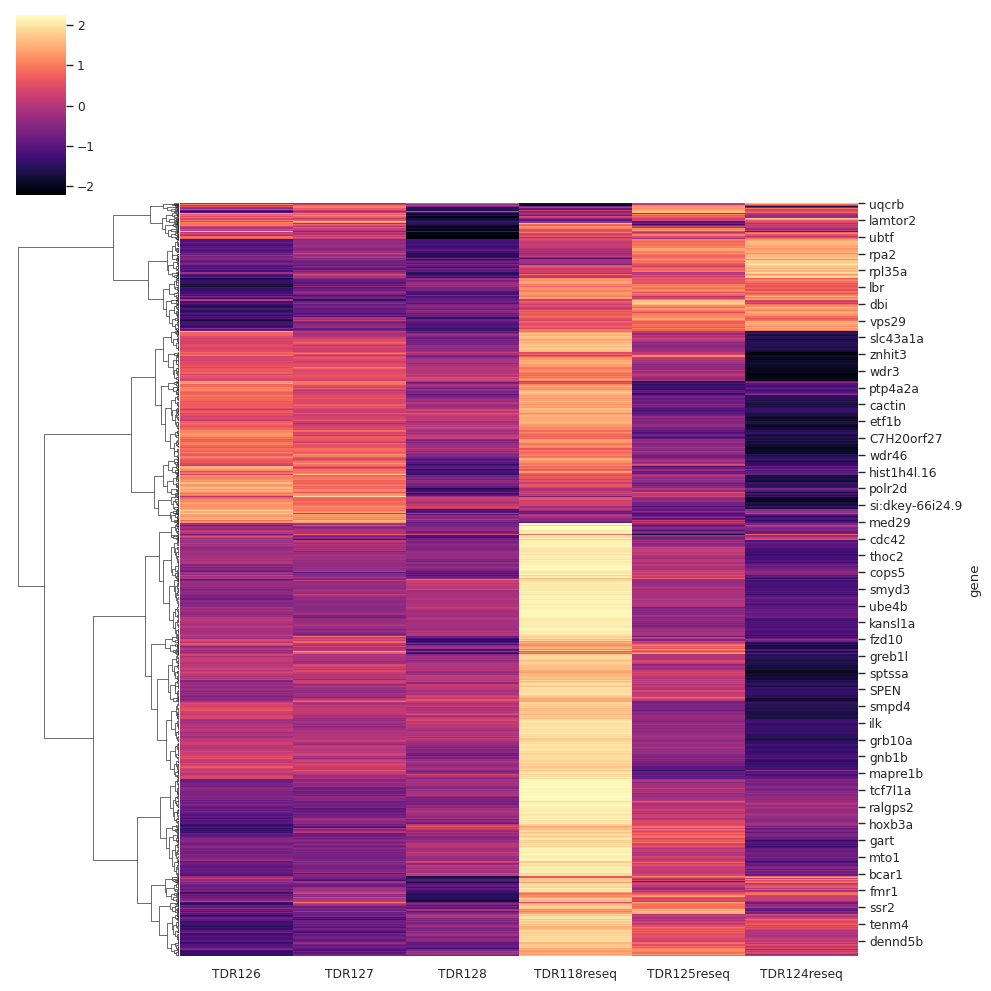

In [210]:
from scipy.stats import zscore

# Step 1: Drop the 'variance' column
heatmap_data = df_rna_mean_hvgs.drop(columns=['variance',"mean","deviation","highly_variable","std_dev","CV"])
heatmap_data.fillna(0, inplace=True)
# Step 2: Compute the z-score along the rows (axis=1)
zscore_data = heatmap_data.apply(zscore, axis=1)
# Keep the index (gene) intact
zscore_data.index = heatmap_data.index

# Step 3: Plot the heatmap
plt.figure(figsize=(10, 15))  # Adjust the figure size as necessary
g = sns.clustermap(zscore_data, cmap="magma", 
            method='ward',  # Use Ward's method for clustering
            metric='euclidean', col_cluster=False, # Use Euclidean distances)
           )
# Show the heatmap
# plt.savefig(figpath + "rna_mean_timepoints_4000hvgs.png")
# plt.savefig(figpath + "rna_mean_timepoints_4000hvgs.pdf")
plt.show()

# extract the row linkage
row_linkage = g.dendrogram_row.linkage

In [ ]:
row_linkage

/home/yang-joon.kim/.local/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


<Figure size 1000x1500 with 0 Axes>

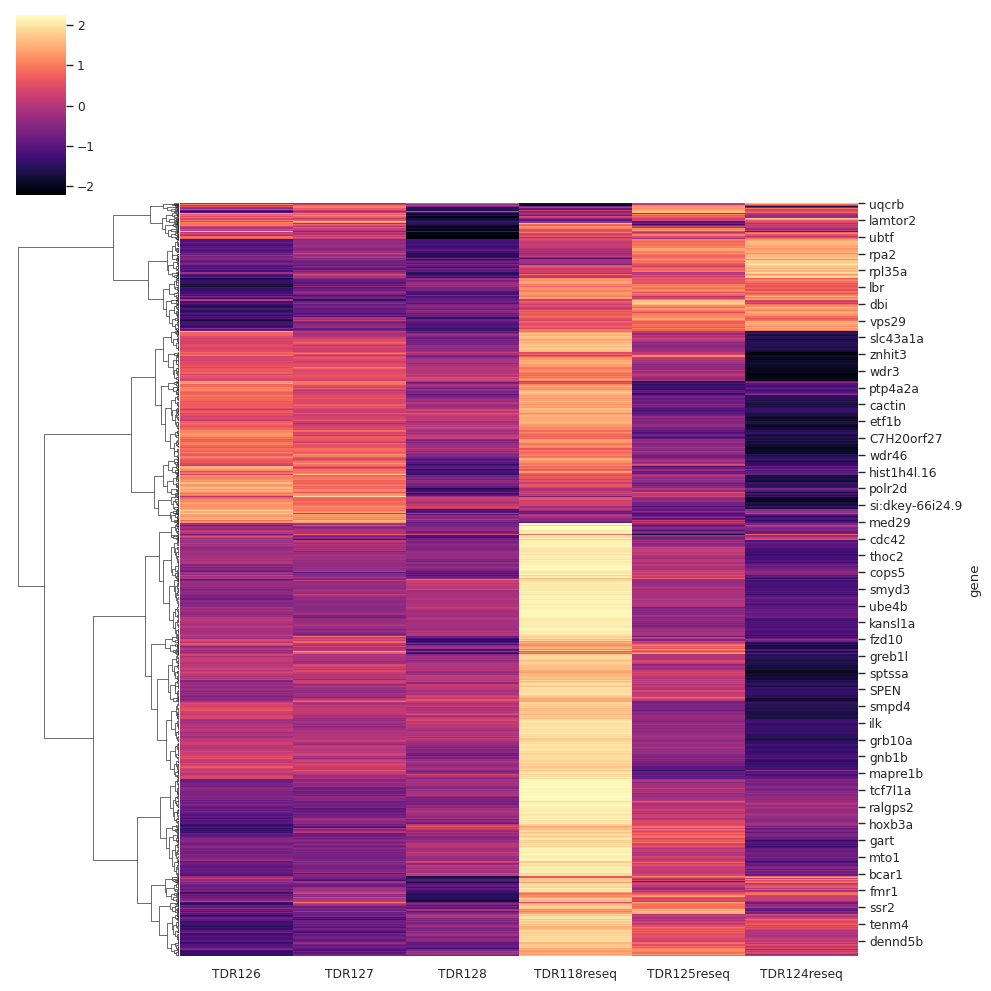

In [203]:
# Step 1: Drop the 'variance' column
heatmap_data = df_rna_mean_hvgs.drop(columns=['variance',"mean","deviation","highly_variable","std_dev","CV"])
heatmap_data.fillna(0, inplace=True)
# Step 2: Compute the z-score along the rows (axis=1)
zscore_data = heatmap_data.apply(zscore, axis=1)
# Keep the index (gene) intact
zscore_data.index = heatmap_data.index

# Step 3: Plot the heatmap
plt.figure(figsize=(10, 15))  # Adjust the figure size as necessary
g = sns.clustermap(zscore_data, cmap="magma", 
            method='ward',  # Use Ward's method for clustering
            metric='euclidean', col_cluster=False
           )
# Show the heatmap
# plt.savefig(figpath + "rna_mean_timepoints_4000hvgs.png")
# plt.savefig(figpath + "rna_mean_timepoints_4000hvgs.pdf")
plt.show()

# extract the row linkage
row_linkage = g.dendrogram_row.linkage

### repeat this for the atac_mean

In [153]:
# Use the function to create the pivoted dataframe
pivoted_atac_mean_df = pivot_from_results(results_dict, col_name="atac_mean")
pivoted_atac_mean_df.set_index('gene', inplace=True)
# Reorder the columns in the pivoted DataFrame
pivoted_atac_mean_df = pivoted_atac_mean_df[list_data]
pivoted_atac_mean_df

,TDR126,TDR127,TDR128,TDR118reseq,TDR125reseq,TDR124reseq
gene,,,,,,
ABCA7,2.948647,3.285304,3.006279,2.877065,3.115766,2.567594
ABCC5,4.309705,4.372230,4.355452,4.025622,4.383356,3.490812
ACAP2,3.685207,3.724536,3.812605,3.424350,3.806071,2.849595
ACBD3,2.442465,2.400062,2.443215,1.918021,2.309927,1.264759
ACKR2,0.459671,0.582908,0.540583,0.484909,0.837237,0.517219
...,...,...,...,...,...,...
zwilch,3.923852,4.004973,4.140978,3.524057,4.233369,3.008347
zyg11,3.522930,3.647805,3.825583,3.454462,3.940903,2.937144
zyx,4.383609,4.438601,4.435896,4.023880,4.356911,3.276952


In [98]:
# # Step 1: Calculate the variance across the columns (timepoints) for each gene
# pivoted_rna_mean_df['variance'] = pivoted_rna_mean_df.var(axis=1)

# # Alternatively, you can calculate the standard deviation instead of variance
# # pivoted_rna_mean_df['std_dev'] = pivoted_rna_mean_df.std(axis=1)

# # Step 2: Sort the dataframe by variance in descending order to get the highly variable genes at the top
# highly_variable_genes = pivoted_rna_mean_df.sort_values(by='variance', ascending=False)

# # Step 3: Optionally, filter the top N highly variable genes (e.g., top 100)
# df_hvgs = highly_variable_genes.head(3000)

# # Display the top highly variable genes
# print(df_hvgs)

                    TDR126    TDR127    TDR128  TDR118reseq  TDR125reseq  \
gene                                                                       
hbbe3             0.031293  0.080760  1.804007     4.128816     5.932602   
hbbe1.3           0.683075  0.762650  1.498641     2.764077     5.337285   
hbae1.3           0.723354  0.720987  1.280221     3.219033     5.277619   
si:dkey-151g10.6  8.021164  8.236604  8.021071     8.232709     8.309515   
mt-co2            7.246485  7.937354  7.814890     8.261821     8.293761   
...                    ...       ...       ...          ...          ...   
gtf2a1            2.521515  2.361343  2.320510     2.669721     2.425717   
ap1m1             2.044378  2.117400  2.227820     3.158361     2.399396   
map4k3a           2.070683  2.227153  2.358081     3.231598     2.338863   
fundc2            2.372526  2.448709  2.371340     2.571289     2.422011   
kif13ba           2.334666  2.097658  2.390547     3.196624     2.157367   

           

In [140]:
top_highly_variable_genes = df_hvgs.index
top_highly_variable_genes

Index(['hbbe3', 'hbbe1.3', 'hbae1.3', 'si:dkey-151g10.6', 'rpl39', 'rps12',
       'rpl37.1', 'mt-co1', 'mt-co2', 'mt-atp6',
       ...
       'micos13', 'actn1', 'gpr107', 'kif18a', 'tmod2', 'si:dkey-100n23.3',
       'snu13a', 'alas1', 'ywhah', 'lysmd2'],
      dtype='object', name='gene', length=4000)

In [159]:
df_atac_mean_hvgs = pivoted_atac_mean_df.loc[top_highly_variable_genes,:]
df_atac_mean_hvgs

,TDR126,TDR127,TDR128,TDR118reseq,TDR125reseq,TDR124reseq
gene,,,,,,
hbbe3,1.336585,1.339932,1.530387,1.015658,1.363563,0.848353
hbbe1.3,1.003909,1.076610,1.015034,0.657037,1.120298,0.754351
hbae1.3,0.970913,0.895462,0.906162,0.621146,0.947147,0.593844
si:dkey-151g10.6,3.879080,3.894442,4.052323,3.485410,4.080669,3.317651
rpl39,4.135665,4.194710,4.205876,3.780234,4.299535,3.525488
...,...,...,...,...,...,...
si:dkey-100n23.3,4.195671,4.220337,4.245203,3.967249,4.411984,3.492271
snu13a,3.559699,3.655691,3.711462,3.307226,3.826528,2.801069
alas1,2.629090,2.735730,2.568189,2.108097,2.632434,1.891554


<Figure size 1000x1500 with 0 Axes>

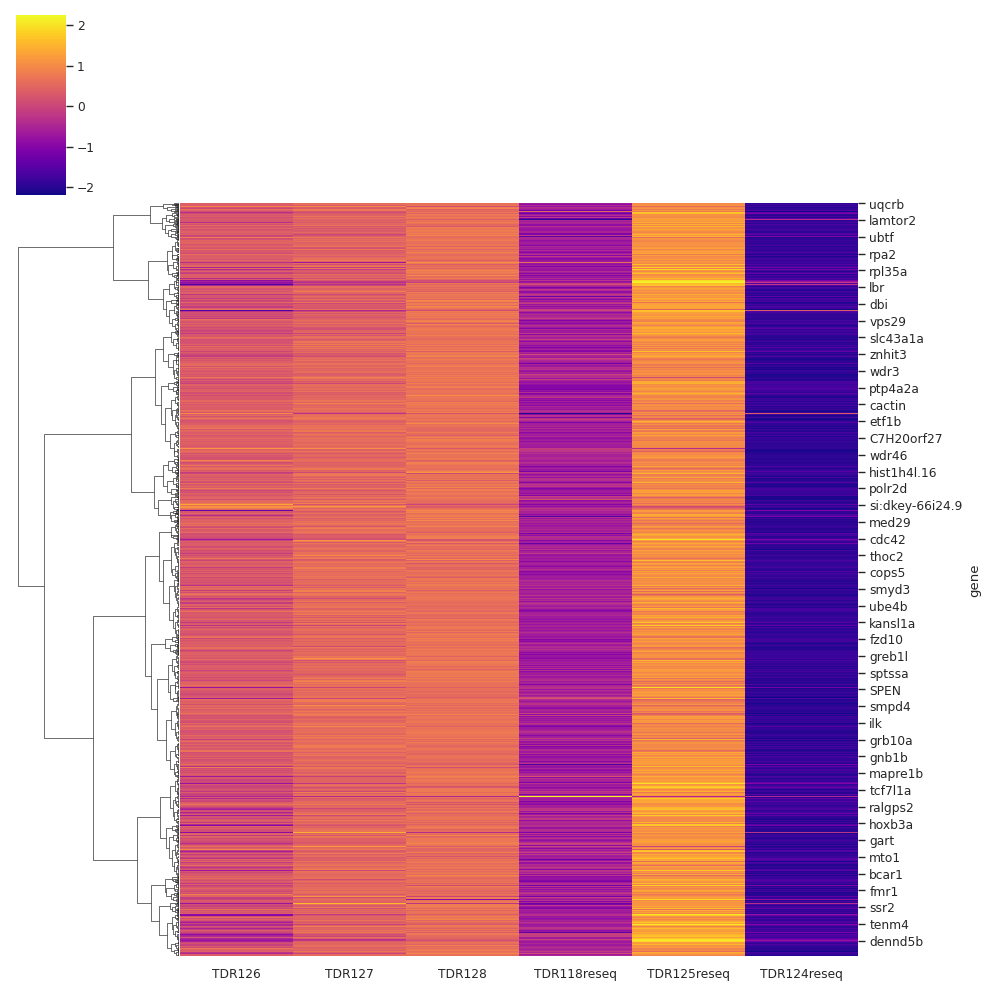

In [211]:
row_linkage = g.dendrogram_row.linkage

# Step 1: Drop the 'variance' column
heatmap_data = df_atac_mean_hvgs #.drop(columns=['variance',"mean","deviation","highly_variable","std_dev","CV"])
heatmap_data.fillna(0, inplace=True)
# Step 2: Compute the z-score along the rows (axis=1)
zscore_data = heatmap_data.apply(zscore, axis=1)
# Keep the index (gene) intact
zscore_data.index = heatmap_data.index

# Step 3: Plot the heatmap
plt.figure(figsize=(10, 15))  # Adjust the figure size as necessary
sns.clustermap(zscore_data, cmap="plasma", 
               row_linkage=row_linkage, 
               col_cluster=False, # Use Euclidean distances)
               )
# Show the heatmap
plt.savefig(figpath + "atac_mean_timepoints_4000hvgs.png")
plt.savefig(figpath + "atac_mean_timepoints_4000hvgs.pdf")
plt.show()

## Step 3. computing the RNA/ATAC(gene.activity) correlation per gene

- 1) sort the genes that are present in both RNA and ATAC objects
- 2) computing the correlation coefficient between RNA and ATAC (gene.activity) for each gene.
- 3) generate a dataframe of genes-by-corr.coefffs, then generate a histogram.

In [43]:
rna_meta_ad = sc.read_h5ad("/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/05_SEACells_processed/TDR126/TDR126_RNA_seacells_aggre.h5ad")
atac_meta_ad = sc.read_h5ad("/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/05_SEACells_processed/TDR126/TDR126_ATAC_seacells_aggre.h5ad")


0.8199403799014269


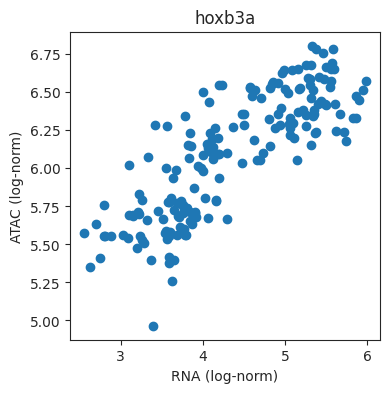

In [143]:
# gene = "hoxb3a"
    
# # Extract expression values for the current gene
# expr1 = rna_meta_ad_filtered[:, rna_meta_ad_filtered.var_names==gene].X.toarray().flatten()  # Ensure it's a 1D array
# expr2 = atac_meta_ad_filtered[:, atac_meta_ad_filtered.var_names==gene].X.toarray().flatten()  # Ensure it's a 1D array

# # Compute the Pearson correlation coefficient
# correlation, _ = pearsonr(expr1, expr2)

# # # Store the correlation coefficient in the dictionary
# # correlation_dict[gene] = correlation

# plt.scatter(expr1, expr2)
# plt.title(gene)
# plt.xlabel("RNA (log-norm)")
# plt.ylabel("ATAC (log-norm)")
# print(correlation)

## Step 4. Analysis on the dynamics of RNA/ATAC correlation (across metacells at each timepoint)

In [212]:
seacellpath = "/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/05_SEACells_processed/"

In [213]:
combined_corr_df = pd.read_csv(seacellpath + f"rna_gene_activity_corr_coeffs_per_gene.csv", index_col=0)
combined_corr_df

,TDR126,TDR127,TDR128,TDR118reseq,TDR119reseq,TDR125reseq,TDR124reseq
Gene,,,,,,,
ABCA7,-0.028654,-0.032221,0.133851,0.074747,0.030354,-0.003384,0.065046
ABCC5,0.336015,0.200692,0.176734,0.106647,0.354901,0.556975,0.625688
ACAP2,0.228901,0.187728,0.193508,0.149988,0.341075,0.447332,0.275948
ACBD3,0.270768,0.222053,0.324276,0.249215,0.329061,0.302815,0.030136
ACKR2,-0.001587,-0.069209,NaN,NaN,0.016819,0.157545,0.273560
...,...,...,...,...,...,...,...
zwilch,0.056113,0.015400,0.199666,-0.010747,0.245065,0.067298,0.143003
zyg11,0.211680,0.079188,0.158447,0.027212,-0.043702,0.041081,-0.095163
zyx,0.390007,0.393244,0.626416,0.529219,0.438269,0.458323,0.261019


In [214]:
# Fill NaN values with 0 (or any other value that makes sense in your context)
df_filled = combined_corr_df.fillna(0)

In [15]:
pearsonr(df_filled.loc[:,"TDR118reseq"].values, 
         df_filled.loc[:,"TDR119reseq"].values)

pearsonr(df_filled.loc[:,"TDR118reseq"].values, 
         df_filled.loc[:,"TDR124reseq"].values)

PearsonRResult(statistic=0.6208840745227905, pvalue=0.0)

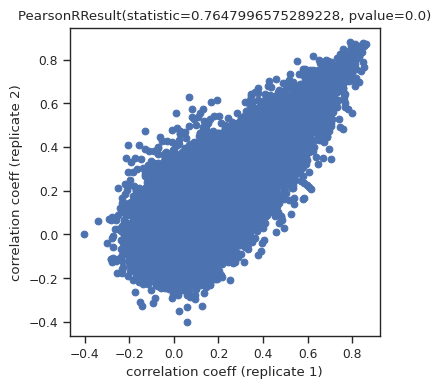

In [16]:
plt.scatter(df_filled.loc[:,"TDR118reseq"].values, 
         df_filled.loc[:,"TDR119reseq"].values)
plt.xlabel("correlation coeff (replicate 1)")
plt.ylabel("correlation coeff (replicate 2)")
plt.grid(False)
plt.title(pearsonr(df_filled.loc[:,"TDR118reseq"].values, 
         df_filled.loc[:,"TDR119reseq"].values))
plt.savefig(figpath+"corr_coeff_between_bio_replicates.pdf")
plt.savefig(figpath+"corr_coeff_between_bio_replicates.png")
plt.show()

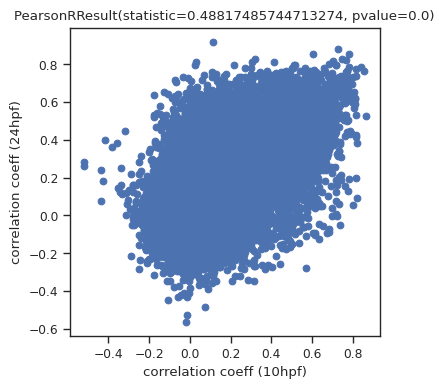

In [17]:
plt.scatter(df_filled.loc[:,"TDR126"].values, 
         df_filled.loc[:,"TDR124reseq"].values)
plt.xlabel("correlation coeff (10hpf)")
plt.ylabel("correlation coeff (24hpf)")
plt.grid(False)
plt.title(pearsonr(df_filled.loc[:,"TDR126"].values, 
         df_filled.loc[:,"TDR124reseq"].values))
plt.savefig(figpath+"corr_coeff_between_10_24hpf.pdf")
plt.savefig(figpath+"corr_coeff_between_10_24hpf.png")
plt.show()

In [216]:
# drop the "TDR119reseq" and only keep "TDR118reseq" for 15-somites stage
df_corr = df_filled.drop("TDR119reseq", axis=1)
df_corr

,TDR126,TDR127,TDR128,TDR118reseq,TDR125reseq,TDR124reseq
Gene,,,,,,
ABCA7,-0.028654,-0.032221,0.133851,0.074747,-0.003384,0.065046
ABCC5,0.336015,0.200692,0.176734,0.106647,0.556975,0.625688
ACAP2,0.228901,0.187728,0.193508,0.149988,0.447332,0.275948
ACBD3,0.270768,0.222053,0.324276,0.249215,0.302815,0.030136
ACKR2,-0.001587,-0.069209,0.000000,0.000000,0.157545,0.273560
...,...,...,...,...,...,...
zwilch,0.056113,0.015400,0.199666,-0.010747,0.067298,0.143003
zyg11,0.211680,0.079188,0.158447,0.027212,0.041081,-0.095163
zyx,0.390007,0.393244,0.626416,0.529219,0.458323,0.261019


In [9]:
df_corr.sort_values(["TDR124reseq","TDR127"], ascending=False)

,TDR126,TDR127,TDR128,TDR118reseq,TDR125reseq,TDR124reseq
Gene,,,,,,
znf1100,0.115207,-0.020278,-0.017647,-0.030520,-0.007304,0.917850
pleca,0.727948,0.521523,0.718979,0.694619,0.724850,0.882515
msi1,0.604246,0.781310,0.816230,0.789709,0.915710,0.852349
tox,0.779706,0.794493,0.777728,0.810744,0.858100,0.851587
anks1b,0.318304,0.468007,0.627118,0.752579,0.763785,0.827724
...,...,...,...,...,...,...
rpl17,-0.057984,-0.135005,-0.157702,-0.238198,-0.191126,-0.433469
alg5,-0.107880,-0.011133,0.089541,0.002960,-0.153915,-0.449995
si:ch73-303b9.1,0.073592,0.031575,0.029303,0.003555,0.069748,-0.486495


In [42]:
df_corr_exp["delta"] = df_corr_exp["TDR125reseq"] - df_corr_exp["TDR126"]
df_corr_exp["mean"] = df_corr_exp.mean(axis=1)
df_corr_exp

,TDR126,TDR127,TDR128,TDR118reseq,TDR125reseq,TDR124reseq,class,last_timepoint,delta,mean
Gene,,,,,,,,,,
ABCA7,-0.028654,-0.032221,0.133851,0.074747,-0.003384,0.065046,1,3,0.025270,0.470517
ABCC5,0.336015,0.200692,0.176734,0.106647,0.556975,0.625688,1,1,0.220960,0.469301
ACAP2,0.228901,0.187728,0.193508,0.149988,0.447332,0.275948,1,4,0.218431,0.744649
ACBD3,0.270768,0.222053,0.324276,0.249215,0.302815,0.030136,1,4,0.032047,0.714590
ACKR2,-0.001587,-0.069209,0.000000,0.000000,0.157545,0.273560,1,1,0.159132,0.279938
...,...,...,...,...,...,...,...,...,...,...
zwilch,0.056113,0.015400,0.199666,-0.010747,0.067298,0.143003,1,3,0.011184,0.497991
zyg11,0.211680,0.079188,0.158447,0.027212,0.041081,-0.095163,1,2,-0.170599,0.361316
zyx,0.390007,0.393244,0.626416,0.529219,0.458323,0.261019,1,4,0.068316,0.858505


In [43]:
df_corr_exp.sort_values(["delta","mean"], ascending=False)

,TDR126,TDR127,TDR128,TDR118reseq,TDR125reseq,TDR124reseq,class,last_timepoint,delta,mean
Gene,,,,,,,,,,
usp10,-0.317835,0.018573,0.152192,0.132084,0.504430,0.446867,1,1,0.822264,0.417620
rasip1,-0.129869,0.061748,0.454675,0.445793,0.687741,0.525571,1,1,0.817610,0.540363
susd1,-0.162186,0.153773,0.629385,0.455048,0.642442,0.540858,1,1,0.804628,0.562661
tafa5b,-0.434596,0.013191,0.208411,0.117059,0.360143,0.076465,1,1,0.794739,0.348379
sdk2b,0.000021,0.479720,0.783728,0.729063,0.784744,0.406658,1,1,0.784722,0.663184
...,...,...,...,...,...,...,...,...,...,...
six7,0.698977,0.666876,0.597476,0.445022,0.120861,-0.005521,1,2,-0.578115,0.549508
srsf5b,0.573742,-0.026371,0.084551,0.191771,-0.004496,0.074689,1,2,-0.578238,0.368405
samd7,0.537775,0.408052,0.191417,0.117234,-0.053261,0.095003,1,2,-0.591036,0.411687


In [24]:
df_corr_exp = df_corr

<Axes: >

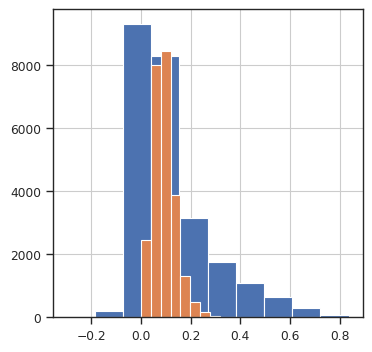

In [25]:
df_corr.mean(axis=1).hist()
df_corr.std(axis=1).hist()

In [49]:
# df_corr_exp = df_corr_exp.drop("class", axis=1)
df_corr_exp = df_corr_exp.drop("last_timepoint", axis=1)

In [51]:
df_corr_exp["std"] = df_corr_exp.std(axis=1)
df_corr_exp

,TDR126,TDR127,TDR128,TDR118reseq,TDR125reseq,TDR124reseq,delta,mean,std
Gene,,,,,,,,,
ABCA7,-0.028654,-0.032221,0.133851,0.074747,-0.003384,0.065046,0.025270,0.470517,0.164522
ABCC5,0.336015,0.200692,0.176734,0.106647,0.556975,0.625688,0.220960,0.469301,0.192734
ACAP2,0.228901,0.187728,0.193508,0.149988,0.447332,0.275948,0.218431,0.744649,0.199243
ACBD3,0.270768,0.222053,0.324276,0.249215,0.302815,0.030136,0.032047,0.714590,0.213323
ACKR2,-0.001587,-0.069209,0.000000,0.000000,0.157545,0.273560,0.159132,0.279938,0.135362
...,...,...,...,...,...,...,...,...,...
zwilch,0.056113,0.015400,0.199666,-0.010747,0.067298,0.143003,0.011184,0.497991,0.167519
zyg11,0.211680,0.079188,0.158447,0.027212,0.041081,-0.095163,-0.170599,0.361316,0.169169
zyx,0.390007,0.393244,0.626416,0.529219,0.458323,0.261019,0.068316,0.858505,0.236804


<Axes: >

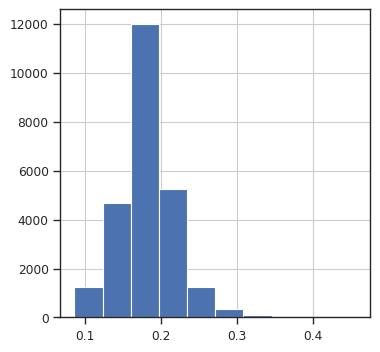

In [59]:
df_corr_exp["std"].hist()

In [61]:
df_corr_exp

,TDR126,TDR127,TDR128,TDR118reseq,TDR125reseq,TDR124reseq,delta,mean,std
Gene,,,,,,,,,
ABCA7,-0.028654,-0.032221,0.133851,0.074747,-0.003384,0.065046,0.025270,0.470517,0.164522
ABCC5,0.336015,0.200692,0.176734,0.106647,0.556975,0.625688,0.220960,0.469301,0.192734
ACAP2,0.228901,0.187728,0.193508,0.149988,0.447332,0.275948,0.218431,0.744649,0.199243
ACBD3,0.270768,0.222053,0.324276,0.249215,0.302815,0.030136,0.032047,0.714590,0.213323
ACKR2,-0.001587,-0.069209,0.000000,0.000000,0.157545,0.273560,0.159132,0.279938,0.135362
...,...,...,...,...,...,...,...,...,...
zwilch,0.056113,0.015400,0.199666,-0.010747,0.067298,0.143003,0.011184,0.497991,0.167519
zyg11,0.211680,0.079188,0.158447,0.027212,0.041081,-0.095163,-0.170599,0.361316,0.169169
zyx,0.390007,0.393244,0.626416,0.529219,0.458323,0.261019,0.068316,0.858505,0.236804


In [64]:
df_sorted = df_corr_exp.sort_values(["mean","std","delta"], ascending=False)
df_sorted

,TDR126,TDR127,TDR128,TDR118reseq,TDR125reseq,TDR124reseq,delta,mean,std
Gene,,,,,,,,,
ncam1a,0.763776,0.836420,0.829508,0.848241,0.854835,0.823419,0.091059,1.116362,0.294009
nova2,0.747108,0.799197,0.857342,0.813665,0.843590,0.825348,0.096482,1.109192,0.289702
arid3c,0.839573,0.813425,0.906840,0.844562,0.801692,0.785142,-0.037880,1.105928,0.337320
tox,0.779706,0.794493,0.777728,0.810744,0.858100,0.851587,0.078393,1.105639,0.294343
hoxc3a,0.855958,0.882774,0.854451,0.860595,0.792431,0.765544,-0.063526,1.105359,0.346778
...,...,...,...,...,...,...,...,...,...
mt-co1,-0.416231,-0.566501,-0.623795,0.051198,-0.350259,0.396864,0.065972,0.061916,0.365658
mt-atp6,-0.426800,-0.518224,-0.507385,0.073938,-0.358008,0.182810,0.068793,0.057236,0.299631
mt-co3,-0.437371,-0.592592,-0.587719,0.079632,-0.353815,0.241784,0.083556,0.048164,0.337846


In [ ]:
# Using the differences between the first and the last timepoints to compute the "difference",
# then, use it for the k-means clustering

# Reshape for clustering
# df_diff = df[['Difference']]

# Perform k-means clustering based on the difference
kmeans = KMeans(n_clusters=4, random_state=0)
df_corr_exp['Cluster'] = kmeans.fit_predict(df_corr_exp)

# Sort the DataFrame by cluster labels
df_sorted = df.sort_values('Cluster').drop(columns=['Difference', 'Cluster'])

# Plot the clustermap
sns.clustermap(df_sorted, method='ward', metric='euclidean', cmap='viridis', 
               row_cluster=True, col_cluster=False, 
               xticklabels=False, yticklabels=False, 
               figsize=(3, 10), vmax=1, vmin=-0.1)

plt.show()

In [73]:
df_corr

,TDR126,TDR127,TDR128,TDR118reseq,TDR125reseq,TDR124reseq,delta,mean
Gene,,,,,,,,
ABCA7,-0.028654,-0.032221,0.133851,0.074747,-0.003384,0.065046,0.025270,0.470517
ABCC5,0.336015,0.200692,0.176734,0.106647,0.556975,0.625688,0.220960,0.469301
ACAP2,0.228901,0.187728,0.193508,0.149988,0.447332,0.275948,0.218431,0.744649
ACBD3,0.270768,0.222053,0.324276,0.249215,0.302815,0.030136,0.032047,0.714590
ACKR2,-0.001587,-0.069209,0.000000,0.000000,0.157545,0.273560,0.159132,0.279938
...,...,...,...,...,...,...,...,...
zwilch,0.056113,0.015400,0.199666,-0.010747,0.067298,0.143003,0.011184,0.497991
zyg11,0.211680,0.079188,0.158447,0.027212,0.041081,-0.095163,-0.170599,0.361316
zyx,0.390007,0.393244,0.626416,0.529219,0.458323,0.261019,0.068316,0.858505


In [74]:
df_corr.drop(["delta","mean"], axis=1, inplace=True)

In [15]:
df_corr = df_filled

In [16]:
# Compute the standard deviation of each gene across timepoints
gene_std = df_corr.std(axis=1)

# Select top N most variable genes (adjust as needed)
top_n_genes = 2000
top_genes = gene_std.sort_values(ascending=False).head(top_n_genes).index


In [18]:
bottom_n_genes = 1000
bottom_genes = gene_std.sort_values(ascending=False).tail(bottom_n_genes).index


In [20]:
bottom_genes

Index(['si:ch211-221n20.7', 'tmed6', 'si:ch1073-365p7.2', 'si:dkey-117a8.4',
       'si:ch211-156l18.6', 'pimr169', 'vwa10.1', 'si:dkeyp-75b4.8', 'megf10',
       'si:ch73-380l3.5',
       ...
       'BX649502.12', 'si:dkey-201i2.4', 'diras1b', 'zgc:162060', 'ighv5-4',
       'si:busm1-169i8.11', 'si:dkey-19p15.4', 'soga3a.1', 'htr1fb',
       'si:ch211-226o13.3'],
      dtype='object', name='Gene', length=1000)

In [19]:
list_genes = top_genes.append(bottom_genes)

Index(['mt-co1', 'mt-co2', 'cldni', 'znf1100', 'mt-cyb', 'mt-co3', 'dock5',
       'si:ch73-217b7.1', 'col12a1b', 'slc10a4',
       ...
       'BX649502.12', 'si:dkey-201i2.4', 'diras1b', 'zgc:162060', 'ighv5-4',
       'si:busm1-169i8.11', 'si:dkey-19p15.4', 'soga3a.1', 'htr1fb',
       'si:ch211-226o13.3'],
      dtype='object', name='Gene', length=3000)

Data shape: (24842, 6)


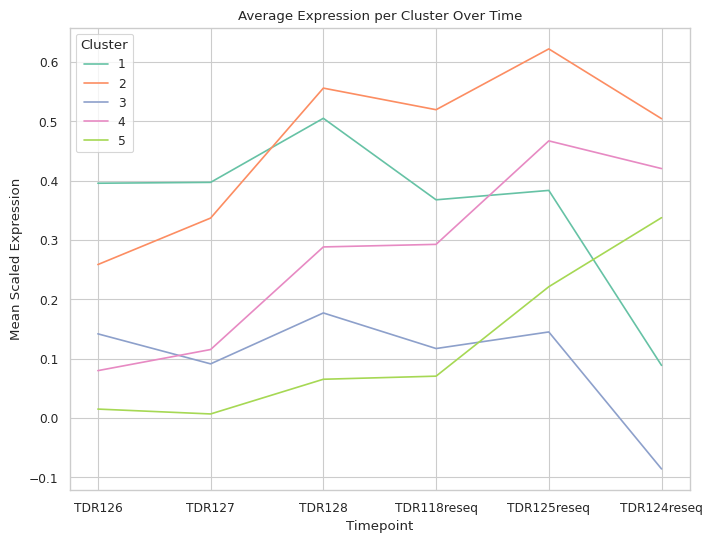

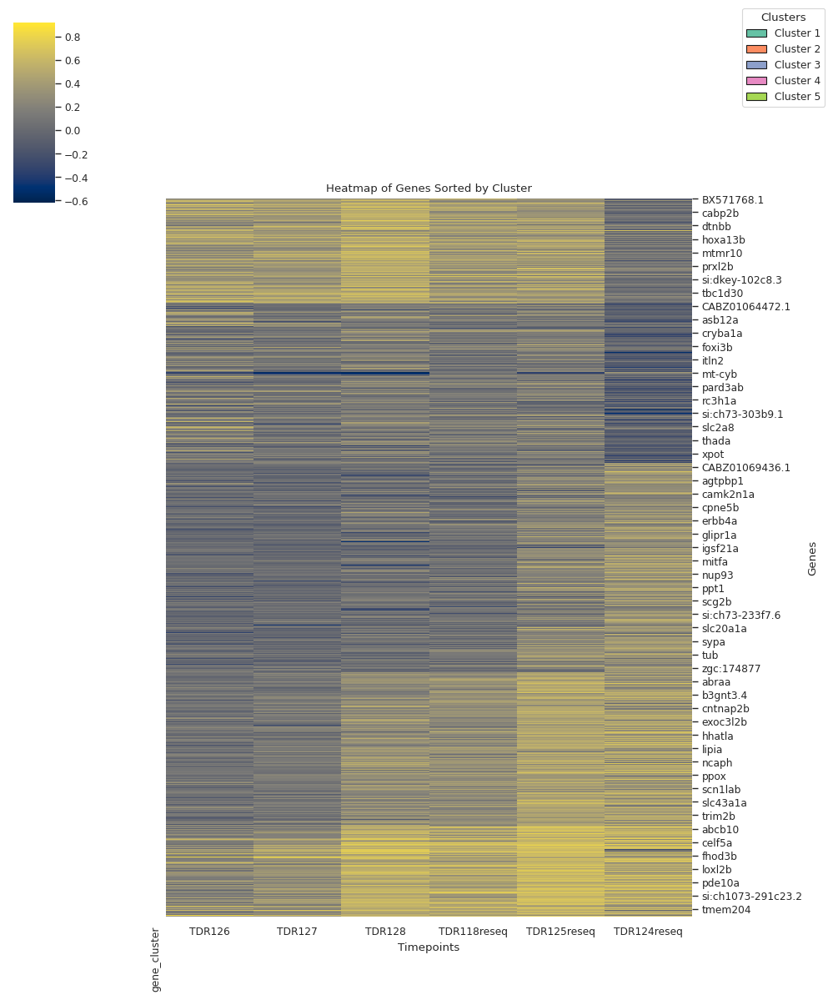

In [219]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import linkage, fcluster
from sklearn.metrics import pairwise_distances
import warnings
warnings.filterwarnings('ignore')

# Step 1: Load your data
# Assuming df_corr is already loaded as a DataFrame with genes as rows and timepoints as columns

# If df_corr is not already loaded, you can load it as follows:
# df_corr = pd.read_csv('your_data.csv', index_col=0)

# Let's print the shape of your data
print(f'Data shape: {df_corr.shape}')

# Step 2: Optional - Select top variable genes
# Compute the standard deviation of each gene across timepoints
gene_std = df_corr.std(axis=1)

# Select top N most variable genes (adjust as needed)
top_n_genes = 3000
top_genes = gene_std.sort_values(ascending=False).head(top_n_genes).index

# bottom_n_genes = 1000
# bottom_genes = gene_std.sort_values(ascending=False).tail(bottom_n_genes).index

# merge the top 2000 and bottom 1000 genes
# list_genes = top_genes.append(bottom_genes)
list_genes = top_genes

df_filtered = df_corr.loc[list_genes]

# Step 3: Scale the data
# Since your data ranges from 0 to 1, scaling might not be necessary, but standardizing can help
# scaler = StandardScaler()
# df_scaled = pd.DataFrame(scaler.fit_transform(df_top), index=df_top.index, columns=df_top.columns)
df_scaled = df_filtered

# Step 4: Clustering
# Since you have only six timepoints, hierarchical clustering might be more appropriate
# Compute the distance matrix (Euclidean distance)
distance_matrix = pairwise_distances(df_scaled, metric='euclidean')

# Perform hierarchical clustering using Ward's method
linked = linkage(distance_matrix, method='ward')

# Decide on the number of clusters
k_clusters = 5  # Adjust based on your data
cluster_labels = fcluster(linked, k_clusters, criterion='maxclust')

# Create a DataFrame with cluster labels
clusts = pd.DataFrame({'Gene': df_scaled.index, 'gene_cluster': cluster_labels})

# Step 5: Plot average expression per cluster over time
# Reshape data to long format
df_long = df_scaled.reset_index().melt(id_vars='Gene', var_name='timepoint', value_name='expression')

# Merge cluster labels
df_long = df_long.merge(clusts, on='Gene')

# Map timepoints to numerical order
timepoint_order = {timepoint: idx for idx, timepoint in enumerate(df_corr.columns)}
df_long['timepoint_num'] = df_long['timepoint'].map(timepoint_order)

# Compute mean expression per cluster per timepoint
cluster_mean = df_long.groupby(['gene_cluster', 'timepoint_num']).mean().reset_index()

# Plotting
plt.figure(figsize=(8, 6))
sns.lineplot(data=cluster_mean, x='timepoint_num', y='expression', hue='gene_cluster', palette='Set2')
plt.xlabel('Timepoint')
plt.xticks(ticks=list(timepoint_order.values()), labels=list(timepoint_order.keys()))
plt.ylabel('Mean Scaled Expression')
plt.title('Average Expression per Cluster Over Time')
plt.legend(title='Cluster')
plt.show()

# Step 6: Create a heatmap with cluster annotations
# Sort genes by cluster
# clusts_sorted = clusts.sort_values(['gene_cluster', 'Gene'])
# genes_sorted = clusts_sorted['Gene']
# Define the desired cluster order
desired_order = ["1", "3", "5", "4", "2"]

# Create a mapping from cluster labels to sort order
sort_order = {cluster: index for index, cluster in enumerate(desired_order)}

# Ensure 'gene_cluster' is of string type
clusts['gene_cluster'] = clusts['gene_cluster'].astype(str)

# Map 'gene_cluster' to sort order
clusts['sort_key'] = clusts['gene_cluster'].map(sort_order)

# Check for any NaN values in 'sort_key' which would indicate clusters not in desired_order
if clusts['sort_key'].isnull().any():
    missing_clusters = clusts[clusts['sort_key'].isnull()]['gene_cluster'].unique()
    print(f"Warning: The following clusters are not in desired_order and will be excluded: {missing_clusters}")
    # Optionally, you can decide how to handle these clusters (e.g., assign them a default order or exclude them)
    # For now, we'll drop these rows
    clusts = clusts.dropna(subset=['sort_key'])

# Sort genes by the custom cluster order and then by gene name
clusts_sorted = clusts.sort_values(['sort_key', 'Gene']).reset_index(drop=True)
genes_sorted = clusts_sorted['Gene']


# # Define the desired cluster order
# desired_order = ["1", "3", "5", "4", "2"]

# # Convert 'gene_cluster' to string type if it's not already
# clusts['gene_cluster'] = clusts['gene_cluster'].astype(str)

# # Convert 'gene_cluster' to a categorical variable with the desired order
# clusts['gene_cluster'] = pd.Categorical(clusts['gene_cluster'], categories=desired_order, ordered=True)

# # Sort genes by the custom cluster order and then by gene name
# clusts_sorted = clusts.sort_values(['gene_cluster', 'Gene']).reset_index(drop=True)
# genes_sorted = clusts_sorted['Gene']

# Sort the data accordingly
# df_sorted = df_scaled.loc[genes_sorted]
df_sorted = df_scaled.loc[genes_sorted]

# Ensure timepoints are in correct order
df_sorted = df_sorted[df_corr.columns]  # Columns in original order

# Create a color map for clusters
k_clusters_unique = clusts_sorted['gene_cluster'].nunique()
cluster_colors = sns.color_palette('Set2', n_colors=k_clusters_unique)
lut = dict(zip(sorted(clusts_sorted['gene_cluster'].unique()), cluster_colors))
row_colors = clusts_sorted['gene_cluster'].map(lut)

# Plot the heatmap
g = sns.clustermap(df_sorted, row_cluster=False, col_cluster=False, row_colors=row_colors,
                   cmap='cividis', figsize=(10, 12))

# Adjust the heatmap
g.ax_heatmap.set_xlabel('Timepoints')
g.ax_heatmap.set_ylabel('Genes')
g.ax_heatmap.set_title('Heatmap of Genes Sorted by Cluster')

# Create legend for clusters
from matplotlib.patches import Patch

handles = [Patch(facecolor=lut[cluster], edgecolor='k', label=f'Cluster {cluster}') 
           for cluster in lut]
plt.legend(handles=handles, title='Clusters', bbox_to_anchor=(1, 1), bbox_transform=plt.gcf().transFigure)

plt.show()

Data shape: (24842, 6)


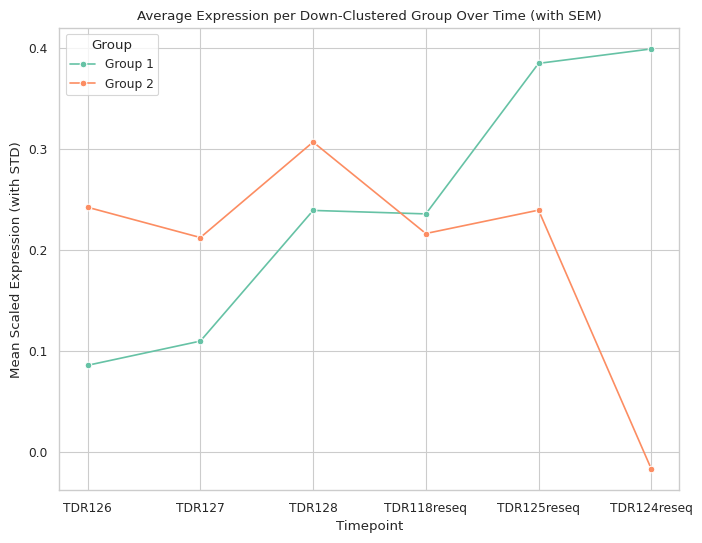

In [223]:
# Define cluster groups
cluster_group_mapping = {
    2: 'Group 1',
    4: 'Group 1',
    5: 'Group 1',
    1: 'Group 2',
    3: 'Group 2'
}

# Step 1: Load your data
# Assuming df_corr is already loaded as a DataFrame with genes as rows and timepoints as columns
print(f'Data shape: {df_corr.shape}')

# Step 2: Select top variable genes
gene_std = df_corr.std(axis=1)
top_n_genes = 3000
top_genes = gene_std.sort_values(ascending=False).head(top_n_genes).index
df_filtered = df_corr.loc[top_genes]

# Step 3: Scale the data (already done)
df_scaled = df_filtered

# Step 4: Clustering (already done)
distance_matrix = pairwise_distances(df_scaled, metric='euclidean')
linked = linkage(distance_matrix, method='ward')
k_clusters = 5
cluster_labels = fcluster(linked, k_clusters, criterion='maxclust')

# Step 5: Create DataFrame with cluster labels
clusts = pd.DataFrame({'Gene': df_scaled.index, 'gene_cluster': cluster_labels})

# Step 6: Map clusters to the two down-clustered groups
clusts['cluster_group'] = clusts['gene_cluster'].map(cluster_group_mapping)

# Step 7: Merge cluster labels with data
df_long = df_scaled.reset_index().melt(id_vars='Gene', var_name='timepoint', value_name='expression')
df_long = df_long.merge(clusts, on='Gene')

# Map timepoints to numerical order
timepoint_order = {timepoint: idx for idx, timepoint in enumerate(df_corr.columns)}
df_long['timepoint_num'] = df_long['timepoint'].map(timepoint_order)

# Step 8: Compute mean and standard error per down-clustered group per timepoint
group_stats = df_long.groupby(['cluster_group', 'timepoint_num']).agg(
    mean_expression=('expression', 'mean'),
    std_dev=('expression', 'std'),
    count=('expression', 'size')
).reset_index()

# Compute the standard error of the mean (SEM)
group_stats['sem'] = group_stats['std_dev'] / np.sqrt(group_stats['count'])

# Step 9: Plot average expression with error bars (SEM) per down-clustered group over time
plt.figure(figsize=(8, 6))

# Plot with error bars (SEM)
sns.lineplot(
    data=group_stats, 
    x='timepoint_num', 
    y='mean_expression', 
    hue='cluster_group', 
    palette='Set2', 
    marker='o',
    ci=None  # Disable automatic confidence intervals since we're adding custom error bars
)

# # Add error bars
# for cluster in group_stats['cluster_group'].unique():
#     cluster_data = group_stats[group_stats['cluster_group'] == cluster]
#     plt.errorbar(
#         cluster_data['timepoint_num'], 
#         cluster_data['mean_expression'], 
#         yerr=cluster_data['std_dev'], 
#         fmt='none', 
#         capsize=5, 
#         capthick=2, 
#         color=sns.color_palette('Set2')[0] if cluster == 'Group 1' else sns.color_palette('Set2')[1]
#     )

plt.xlabel('Timepoint')
plt.xticks(ticks=list(timepoint_order.values()), labels=list(timepoint_order.keys()))
plt.ylabel('Mean Scaled Expression (with STD)')
plt.title('Average Expression per Down-Clustered Group Over Time (with SEM)')
plt.legend(title='Group')
plt.show()


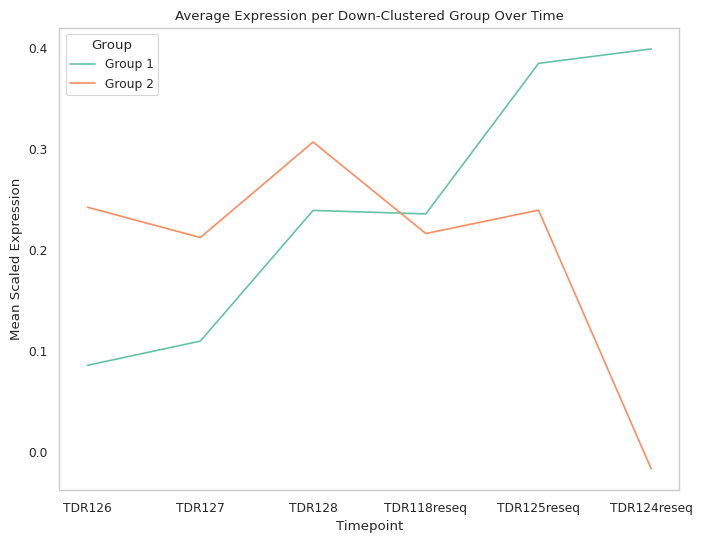

In [226]:
plt.figure(figsize=(8, 6))

# Plot only lines (without error bars)
sns.lineplot(
    data=group_stats, 
    x='timepoint_num', 
    y='mean_expression', 
    hue='cluster_group', 
    palette='Set2', 
    ci=None  # Disable confidence intervals
)

# Remove grid lines
plt.grid(False)

# Set labels and title
plt.xlabel('Timepoint')
plt.xticks(ticks=list(timepoint_order.values()), labels=list(timepoint_order.keys()))
plt.ylabel('Mean Scaled Expression')
plt.title('Average Expression per Down-Clustered Group Over Time')

# Show legend
plt.legend(title='Group')

# Show the plot
plt.savefig(figpath + "gene_cluster_trends_big_groups.pdf")
plt.show()

In [ ]:
# # Plotting
# plt.figure(figsize=(8, 6))
# sns.lineplot(data=cluster_mean, x='timepoint_num', y='expression', hue='gene_cluster', palette='Set2')
# plt.xlabel('Timepoint')
# plt.xticks(ticks=list(timepoint_order.values()), labels=list(timepoint_order.keys()))
# plt.ylabel('Mean Scaled Expression')
# plt.title('Average Expression per Cluster Over Time')
# plt.legend(title='Cluster')
# plt.grid(False)
# plt.savefig(figpath + "gene_cluster_trends.pdf")
# plt.show()


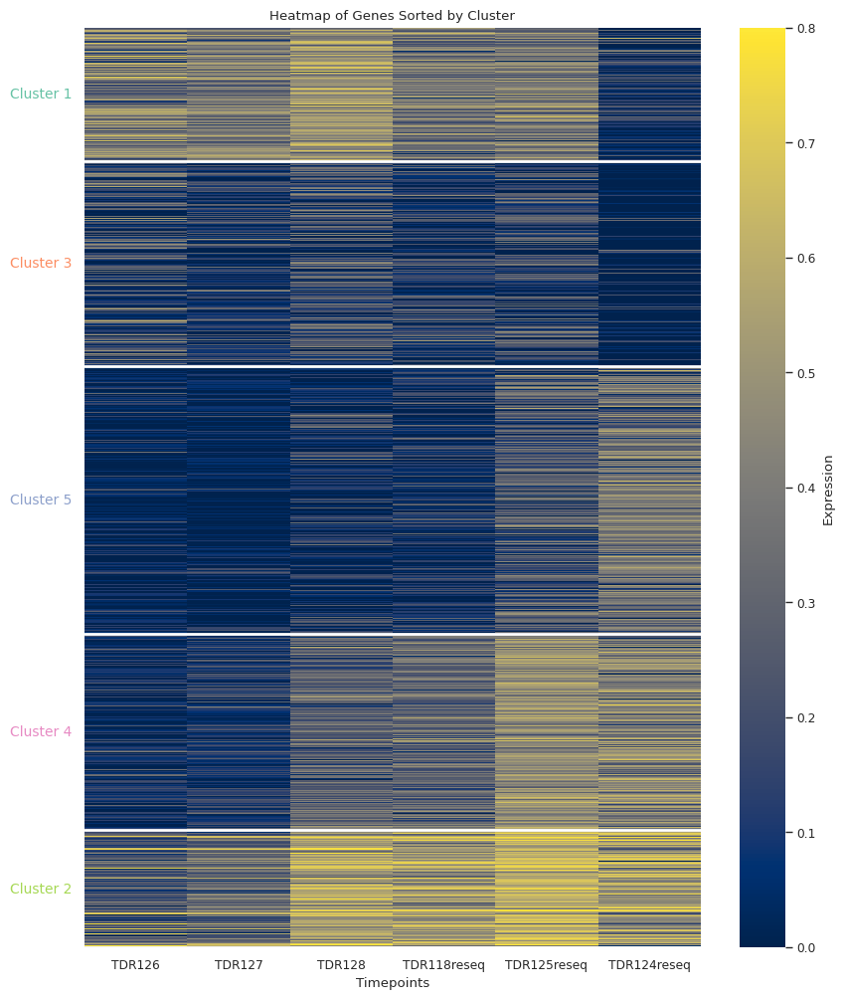

In [227]:
# Ensure 'gene_cluster' is of string type
clusts['gene_cluster'] = clusts['gene_cluster'].astype(str)

# Map 'gene_cluster' to sort order
clusts['sort_key'] = clusts['gene_cluster'].map(sort_order)

# Check for any NaN values in 'sort_key' which would indicate clusters not in desired_order
if clusts['sort_key'].isnull().any():
    missing_clusters = clusts[clusts['sort_key'].isnull()]['gene_cluster'].unique()
    print(f"Warning: The following clusters are not in desired_order and will be excluded: {missing_clusters}")
    clusts = clusts.dropna(subset=['sort_key'])

# Sort genes by the custom cluster order and then by gene name
clusts_sorted = clusts.sort_values(['sort_key', 'Gene']).reset_index(drop=True)
genes_sorted = clusts_sorted['Gene']

# Sort the data accordingly
df_sorted = df_scaled.loc[genes_sorted]

# Ensure timepoints are in correct order
df_sorted = df_sorted[df_corr.columns]  # Columns in original order

# Create a color map for clusters
cluster_colors = sns.color_palette('Set2', n_colors=len(desired_order))
lut = dict(zip(desired_order, cluster_colors))
row_colors = clusts_sorted['gene_cluster'].map(lut)

# Prepare for labeling clusters on y-axis
# Find indices where clusters change
clusts_sorted['cluster_change'] = clusts_sorted['gene_cluster'] != clusts_sorted['gene_cluster'].shift(1)
clusts_sorted['cluster_group'] = clusts_sorted['cluster_change'].cumsum()

# Get start and end indices for each cluster
cluster_boundaries = clusts_sorted.groupby('cluster_group').agg({
    'Gene': ['first', 'last'],
    'gene_cluster': 'first'
}).reset_index()

cluster_boundaries.columns = ['cluster_group', 'start_gene', 'end_gene', 'gene_cluster']

# Get the positions to place cluster labels
cluster_positions = []
for _, row in cluster_boundaries.iterrows():
    # Get the start and end index of the cluster
    start_idx = df_sorted.index.get_loc(row['start_gene'])
    end_idx = df_sorted.index.get_loc(row['end_gene'])
    # Compute the center position
    pos = (start_idx + end_idx) / 2
    cluster_positions.append((pos, row['gene_cluster']))

# Plot the heatmap without clustering
plt.figure(figsize=(10, 12))
ax = sns.heatmap(df_sorted, cmap='cividis', cbar_kws={'label': 'Expression'}, yticklabels=False,
                 vmin=0, vmax=0.8)

# Add cluster labels on y-axis
for pos, label in cluster_positions:
    ax.text(-0.02, pos, f'Cluster {label}', ha='right', va='center', fontsize=10, color=lut[label], transform=ax.get_yaxis_transform())

# Add horizontal lines to separate clusters
for _, row in cluster_boundaries.iterrows():
    idx = df_sorted.index.get_loc(row['end_gene'])
    ax.axhline(idx + 0.5, color='white', linewidth=2)

# Adjust the plot
ax.set_xlabel('Timepoints')
ax.set_ylabel('')
ax.set_title('Heatmap of Genes Sorted by Cluster')

# Create a legend for clusters
handles = [Patch(facecolor=lut[cluster], edgecolor='k', label=f'Cluster {cluster}') 
           for cluster in desired_order]
# plt.legend(handles=handles, title='Clusters', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig(figpath + "heatmap_corr_coeff_timepoints_clustered_top3000_cividis.pdf")
plt.show()

In [12]:
df_corr

,TDR126,TDR127,TDR128,TDR118reseq,TDR125reseq,TDR124reseq
Gene,,,,,,
ABCA7,-0.028654,-0.032221,0.133851,0.074747,-0.003384,0.065046
ABCC5,0.336015,0.200692,0.176734,0.106647,0.556975,0.625688
ACAP2,0.228901,0.187728,0.193508,0.149988,0.447332,0.275948
ACBD3,0.270768,0.222053,0.324276,0.249215,0.302815,0.030136
ACKR2,-0.001587,-0.069209,0.000000,0.000000,0.157545,0.273560
...,...,...,...,...,...,...
zwilch,0.056113,0.015400,0.199666,-0.010747,0.067298,0.143003
zyg11,0.211680,0.079188,0.158447,0.027212,0.041081,-0.095163
zyx,0.390007,0.393244,0.626416,0.529219,0.458323,0.261019


## Step 5. Compute the driving cell-type for each gene

- From the correlation scatter plots, we learned that there are driving celltypes for each gene's correlation patterns (the highest ATAC/RNA levels among the metacells).

- We will compute the driving cell-type for each gene (top 2?), then compute a dataframe of genes-by-celltypes

In [252]:
# Function to compute the top 3 cell types driving the patterns from adata.X
def compute_top_celltypes_by_expression(meta_ad, top_n=3):
    # First, convert sparse matrix in .X to dense if necessary
    if sci.sparse.issparse(meta_ad.X):
        expr_values = pd.DataFrame(meta_ad.X.toarray(), index=meta_ad.obs.index, columns=meta_ad.var.index)
    else:
        expr_values = pd.DataFrame(meta_ad.X, index=meta_ad.obs.index, columns=meta_ad.var.index)

    # Group expression values by 'celltype' and compute the mean for each cell type
    expr_values["celltype"] = meta_ad.obs["celltype"]
    mean_values_by_celltype = expr_values.groupby("celltype").mean().mean(axis=1)

    # Get top N cell types by mean expression
    top_celltypes = mean_values_by_celltype.nlargest(top_n).index

    return top_celltypes

In [253]:
compute_top_celltypes_by_expression(rna_meta_ad, top_n=2)

Index(['endocrine_pancreas', 'differentiating_neurons'], dtype='object', name='celltype')

In [255]:
# Function to compute the top cell type based on combined RNA + ATAC expression
def compute_top_celltype_by_combined_expression(rna_meta_ad, atac_meta_ad):
    # Convert sparse matrices to dense if necessary
    if sci.sparse.issparse(rna_meta_ad.X):
        rna_expr_values = pd.DataFrame(rna_meta_ad.X.toarray(), index=rna_meta_ad.obs.index, columns=rna_meta_ad.var.index)
    else:
        rna_expr_values = pd.DataFrame(rna_meta_ad.X, index=rna_meta_ad.obs.index, columns=rna_meta_ad.var.index)

    if sci.sparse.issparse(atac_meta_ad.X):
        atac_expr_values = pd.DataFrame(atac_meta_ad.X.toarray(), index=atac_meta_ad.obs.index, columns=atac_meta_ad.var.index)
    else:
        atac_expr_values = pd.DataFrame(atac_meta_ad.X, index=atac_meta_ad.obs.index, columns=atac_meta_ad.var.index)

    # Add the RNA and ATAC expression values for each gene
    combined_expr_values = rna_expr_values + atac_expr_values
    
    # Add the cell type information to the combined expression matrix
    combined_expr_values["celltype"] = rna_meta_ad.obs["celltype"]

    # Compute the mean expression of the combined values by cell type for each gene
    mean_combined_expr_by_celltype = combined_expr_values.groupby("celltype").mean().T  # Transpose to make genes the rows

    # For each gene, find the cell type with the highest combined RNA + ATAC expression
    top_celltype_per_gene = mean_combined_expr_by_celltype.idxmax(axis=1)

    return top_celltype_per_gene

# Initialize a DataFrame to store the results for all genes and cell types
results_df = pd.DataFrame()

# Loop through each data_id
for i, data_id in enumerate(list_data):
    # Import the RNA and ATAC adata objects (aggregated over metacells)
    data_name = data_id.strip("reseq")
    rna_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_name}_RNA_seacells_aggre.h5ad")
    atac_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_name}_ATAC_seacells_aggre.h5ad")
    
    # Import the RNA adata (not aggregated) to compute prevalent cell types
    rna_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_name}_RNA_seacells.h5ad")
    
    # Compute the most prevalent cell type for each metacell
    prevalent_celltypes = compute_prevalent_celltype_per_metacell(rna_ad, celltype_key="annotation_ML_coarse", metacell_key="SEACell")
    
    # Subset the features that are shared between RNA and ATAC (gene names)
    shared_genes = np.intersect1d(rna_meta_ad.var_names, atac_meta_ad.var_names)
    print(f"Number of shared genes: {len(shared_genes)}")

    # Subset the RNA and ATAC objects for the shared genes
    rna_meta_ad = rna_meta_ad[:, shared_genes]
    atac_meta_ad = atac_meta_ad[:, shared_genes]
    
    # Map the prevalent cell types to each metacell in the obs
    rna_meta_ad.obs["celltype"] = rna_meta_ad.obs_names.map(prevalent_celltypes)
    atac_meta_ad.obs["celltype"] = atac_meta_ad.obs_names.map(prevalent_celltypes)
    
    # Compute the top cell type based on combined RNA and ATAC values for each gene
    top_combined_celltype = compute_top_celltype_by_combined_expression(rna_meta_ad, atac_meta_ad)
    
    # Create a DataFrame to store the results for the current data_id
    temp_df = pd.DataFrame({
        'gene': shared_genes,
        f'top_combined_celltype_{data_name}': top_combined_celltype
    }).reset_index(drop=True)
    
    # Merge with the results DataFrame
    if results_df.empty:
        results_df = temp_df
    else:
        results_df = results_df.merge(temp_df, on='gene', how='outer')

# Display the final results DataFrame
print(results_df)

Number of shared genes: 24942
Number of shared genes: 24943
Number of shared genes: 24936
Number of shared genes: 24923
Number of shared genes: 24940
Number of shared genes: 24889
                   gene top_combined_celltype_TDR126  \
0                 ABCA7    hematopoietic_vasculature   
1                 ABCC5                      somites   
2                 ACAP2    hematopoietic_vasculature   
3                 ACBD3               hatching_gland   
4                 ACKR2  midbrain_hindbrain_boundary   
...                 ...                          ...   
24964  si:dkey-258f14.3                          NaN   
24965   si:dkeyp-82h4.1                          NaN   
24966  si:dkey-30g5.1.2                          NaN   
24967    si:dkey-79c1.1                          NaN   
24968  si:ch211-208g1.1                          NaN   

      top_combined_celltype_TDR127 top_combined_celltype_TDR128  \
0                  enteric_neurons                    notochord   
1            

In [260]:
results_df.set_index("gene", inplace=True)
results_df

,top_combined_celltype_TDR126,top_combined_celltype_TDR127,top_combined_celltype_TDR128,top_combined_celltype_TDR118,top_combined_celltype_TDR125,top_combined_celltype_TDR124
gene,,,,,,
ABCA7,hematopoietic_vasculature,enteric_neurons,notochord,pronephros,floor_plate,pharyngeal_arches
ABCC5,somites,somites,notochord,notochord,muscle,hemangioblasts
ACAP2,hematopoietic_vasculature,primordial_germ_cells,enteric_neurons,enteric_neurons,enteric_neurons,differentiating_neurons
ACBD3,hatching_gland,hatching_gland,hatching_gland,hatching_gland,hatching_gland,PSM
ACKR2,midbrain_hindbrain_boundary,primordial_germ_cells,hematopoietic_vasculature,notochord,hematopoietic_vasculature,lateral_plate_mesoderm
...,...,...,...,...,...,...
si:dkey-258f14.3,NaN,NaN,NaN,hemangioblasts,NaN,NaN
si:dkeyp-82h4.1,NaN,NaN,NaN,notochord,NaN,NaN
si:dkey-30g5.1.2,NaN,NaN,NaN,NaN,hematopoietic_vasculature,NaN


In [262]:
results_df.loc[list_genes]

,top_combined_celltype_TDR126,top_combined_celltype_TDR127,top_combined_celltype_TDR128,top_combined_celltype_TDR118,top_combined_celltype_TDR125,top_combined_celltype_TDR124
Gene,,,,,,
mt-co1,neural_crest,primordial_germ_cells,NMPs,hemangioblasts,enteric_neurons,neural_telencephalon
mt-co2,neural_crest,primordial_germ_cells,NMPs,hemangioblasts,enteric_neurons,optic_cup
cldni,epidermis,epidermis,epidermis,epidermis,epidermis,endocrine_pancreas
znf1100,hindbrain,hemangioblasts,PSM,spinal_cord,spinal_cord,optic_cup
mt-cyb,neural_crest,primordial_germ_cells,NMPs,hemangioblasts,enteric_neurons,optic_cup
...,...,...,...,...,...,...
coq5,hematopoietic_vasculature,primordial_germ_cells,muscle,neural_posterior,midbrain_hindbrain_boundary,midbrain_hindbrain_boundary
zgc:162612,hematopoietic_vasculature,hemangioblasts,lateral_plate_mesoderm,muscle,neural_crest,lateral_plate_mesoderm
elk4,PSM,differentiating_neurons,NMPs,hatching_gland,neural,endocrine_pancreas


In [265]:
results_df_filtered = results_df.loc[list_genes]
results_df_filtered

,top_combined_celltype_TDR126,top_combined_celltype_TDR127,top_combined_celltype_TDR128,top_combined_celltype_TDR118,top_combined_celltype_TDR125,top_combined_celltype_TDR124
Gene,,,,,,
mt-co1,neural_crest,primordial_germ_cells,NMPs,hemangioblasts,enteric_neurons,neural_telencephalon
mt-co2,neural_crest,primordial_germ_cells,NMPs,hemangioblasts,enteric_neurons,optic_cup
cldni,epidermis,epidermis,epidermis,epidermis,epidermis,endocrine_pancreas
znf1100,hindbrain,hemangioblasts,PSM,spinal_cord,spinal_cord,optic_cup
mt-cyb,neural_crest,primordial_germ_cells,NMPs,hemangioblasts,enteric_neurons,optic_cup
...,...,...,...,...,...,...
coq5,hematopoietic_vasculature,primordial_germ_cells,muscle,neural_posterior,midbrain_hindbrain_boundary,midbrain_hindbrain_boundary
zgc:162612,hematopoietic_vasculature,hemangioblasts,lateral_plate_mesoderm,muscle,neural_crest,lateral_plate_mesoderm
elk4,PSM,differentiating_neurons,NMPs,hatching_gland,neural,endocrine_pancreas


In [ ]:
results_df_filtered.loc["meox1"]

In [267]:
from collections import Counter

# Function to compute the top 2 cell types based on combined RNA + ATAC expression
def compute_top_two_celltypes_by_combined_expression(rna_meta_ad, atac_meta_ad):
    # Convert sparse matrices to dense if necessary
    if sci.sparse.issparse(rna_meta_ad.X):
        rna_expr_values = pd.DataFrame(rna_meta_ad.X.toarray(), index=rna_meta_ad.obs.index, columns=rna_meta_ad.var.index)
    else:
        rna_expr_values = pd.DataFrame(rna_meta_ad.X, index=rna_meta_ad.obs.index, columns=rna_meta_ad.var.index)

    if sci.sparse.issparse(atac_meta_ad.X):
        atac_expr_values = pd.DataFrame(atac_meta_ad.X.toarray(), index=atac_meta_ad.obs.index, columns=atac_meta_ad.var.index)
    else:
        atac_expr_values = pd.DataFrame(atac_meta_ad.X, index=atac_meta_ad.obs.index, columns=atac_meta_ad.var.index)

    # Add the RNA and ATAC expression values for each gene
    combined_expr_values = rna_expr_values + atac_expr_values
    
    # Add the cell type information to the combined expression matrix
    combined_expr_values["celltype"] = rna_meta_ad.obs["celltype"]

    # Compute the mean expression of the combined values by cell type for each gene
    mean_combined_expr_by_celltype = combined_expr_values.groupby("celltype").mean().T  # Transpose to make genes the rows

    # For each gene, find the top 2 cell types by combined RNA + ATAC expression
    top_two_celltypes_per_gene = mean_combined_expr_by_celltype.apply(lambda row: row.nlargest(2).index.tolist(), axis=1)

    return top_two_celltypes_per_gene

# Initialize a dictionary to store the cell type counts for each gene
celltype_counts = {}

# Loop through each data_id (representing each timepoint)
for i, data_id in enumerate(list_data):
    # Import the RNA and ATAC adata objects (aggregated over metacells)
    data_name = data_id.strip("reseq")
    rna_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_name}_RNA_seacells_aggre.h5ad")
    atac_meta_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_name}_ATAC_seacells_aggre.h5ad")
    
    # Import the RNA adata (not aggregated) to compute prevalent cell types
    rna_ad = sc.read_h5ad(metacell_path + f"{data_id}/{data_name}_RNA_seacells.h5ad")
    
    # Compute the most prevalent cell type for each metacell
    prevalent_celltypes = compute_prevalent_celltype_per_metacell(rna_ad, celltype_key="annotation_ML_coarse", metacell_key="SEACell")
    
    # Subset the features that are shared between RNA and ATAC (gene names)
    shared_genes = np.intersect1d(rna_meta_ad.var_names, atac_meta_ad.var_names)
    print(f"Number of shared genes: {len(shared_genes)}")

    # Subset the RNA and ATAC objects for the shared genes
    rna_meta_ad = rna_meta_ad[:, shared_genes]
    atac_meta_ad = atac_meta_ad[:, shared_genes]
    
    # Map the prevalent cell types to each metacell in the obs
    rna_meta_ad.obs["celltype"] = rna_meta_ad.obs_names.map(prevalent_celltypes)
    atac_meta_ad.obs["celltype"] = atac_meta_ad.obs_names.map(prevalent_celltypes)
    
    # Compute the top 2 cell types based on combined RNA and ATAC values for each gene at the current timepoint
    top_two_celltypes = compute_top_two_celltypes_by_combined_expression(rna_meta_ad, atac_meta_ad)
    
    # For each gene, count the top 2 cell types across all timepoints
    for gene, celltypes in top_two_celltypes.items():
        if gene not in celltype_counts:
            celltype_counts[gene] = []
        # Append the top 2 cell types for this gene and this timepoint
        celltype_counts[gene].extend(celltypes)

# After processing all timepoints, find the top 2 most prevalent cell types across all timepoints for each gene
final_results = {}

for gene, celltypes in celltype_counts.items():
    # Count the frequency of each cell type
    celltype_counter = Counter(celltypes)
    # Get the top 2 most common cell types
    top_two_celltypes = celltype_counter.most_common(2)
    final_results[gene] = [ct[0] for ct in top_two_celltypes]

# Convert the final results to a DataFrame
final_df = pd.DataFrame.from_dict(final_results, orient='index', columns=['top_celltype_1', 'top_celltype_2'])

# Display the final results DataFrame
print(final_df)


Number of shared genes: 24942
Number of shared genes: 24943
Number of shared genes: 24936
Number of shared genes: 24923
Number of shared genes: 24940
Number of shared genes: 24889
                             top_celltype_1           top_celltype_2
ABCA7             hematopoietic_vasculature               pronephros
ABCC5                                muscle                notochord
ACAP2                       enteric_neurons  differentiating_neurons
ACBD3                        hatching_gland                notochord
ACKR2             hematopoietic_vasculature                notochord
...                                     ...                      ...
si:dkey-258f14.3             hemangioblasts              fast_muscle
si:dkeyp-82h4.1                   notochord           hemangioblasts
si:dkey-30g5.1.2  hematopoietic_vasculature                     NMPs
si:dkey-79c1.1                          PSM     neural_telencephalon
si:ch211-208g1.1                  hindbrain                  

In [270]:
df_marker_celltypes = final_df.loc[list_genes]
df_marker_celltypes

,top_celltype_1,top_celltype_2
Gene,,
mt-co1,neural_crest,PSM
mt-co2,optic_cup,neural_crest
cldni,epidermis,enteric_neurons
znf1100,spinal_cord,hindbrain
mt-cyb,neural_crest,PSM
...,...,...
coq5,midbrain_hindbrain_boundary,muscle
zgc:162612,lateral_plate_mesoderm,hematopoietic_vasculature
elk4,PSM,tail_bud


In [283]:
df_marker_celltypes.top_celltype_1.unique()

array(['neural_crest', 'optic_cup', 'epidermis', 'spinal_cord',
       'hatching_gland', 'pharyngeal_arches', 'hemangioblasts',
       'fast_muscle', 'enteric_neurons', 'hematopoietic_vasculature',
       'neural', 'neural_telencephalon', 'somites', 'endocrine_pancreas',
       'lateral_plate_mesoderm', 'NMPs', 'floor_plate',
       'heart_myocardium', 'hindbrain', 'differentiating_neurons',
       'tail_bud', 'pronephros', 'midbrain_hindbrain_boundary', 'muscle',
       'PSM', 'neurons', 'notochord', 'neural_posterior',
       'neural_floor_plate', 'endoderm', 'neural_optic'], dtype=object)

In [289]:
# Slice the DataFrame where "top_celltype_1" is "NMPs"
df_subset = df_marker_celltypes[df_marker_celltypes['top_celltype_2'] == 'NMPs']

# Display the filtered DataFrame
df_subset

,top_celltype_1,top_celltype_2
Gene,,
anp32b,tail_bud,NMPs
fth1a,enteric_neurons,NMPs
szl,tail_bud,NMPs
phkg2,tail_bud,NMPs
hmbsa,hemangioblasts,NMPs
...,...,...
slc1a6,hindbrain,NMPs
znf652,notochord,NMPs
lypd6b,endoderm,NMPs


In [310]:
df_marker_celltypes.loc["cdx1a"]

top_celltype_1    tail_bud
top_celltype_2        NMPs
mean_corr         0.443502
Name: cdx1a, dtype: object

In [290]:
df_corr

,TDR126,TDR127,TDR128,TDR118reseq,TDR125reseq,TDR124reseq
Gene,,,,,,
ABCA7,-0.028654,-0.032221,0.133851,0.074747,-0.003384,0.065046
ABCC5,0.336015,0.200692,0.176734,0.106647,0.556975,0.625688
ACAP2,0.228901,0.187728,0.193508,0.149988,0.447332,0.275948
ACBD3,0.270768,0.222053,0.324276,0.249215,0.302815,0.030136
ACKR2,-0.001587,-0.069209,0.000000,0.000000,0.157545,0.273560
...,...,...,...,...,...,...
zwilch,0.056113,0.015400,0.199666,-0.010747,0.067298,0.143003
zyg11,0.211680,0.079188,0.158447,0.027212,0.041081,-0.095163
zyx,0.390007,0.393244,0.626416,0.529219,0.458323,0.261019


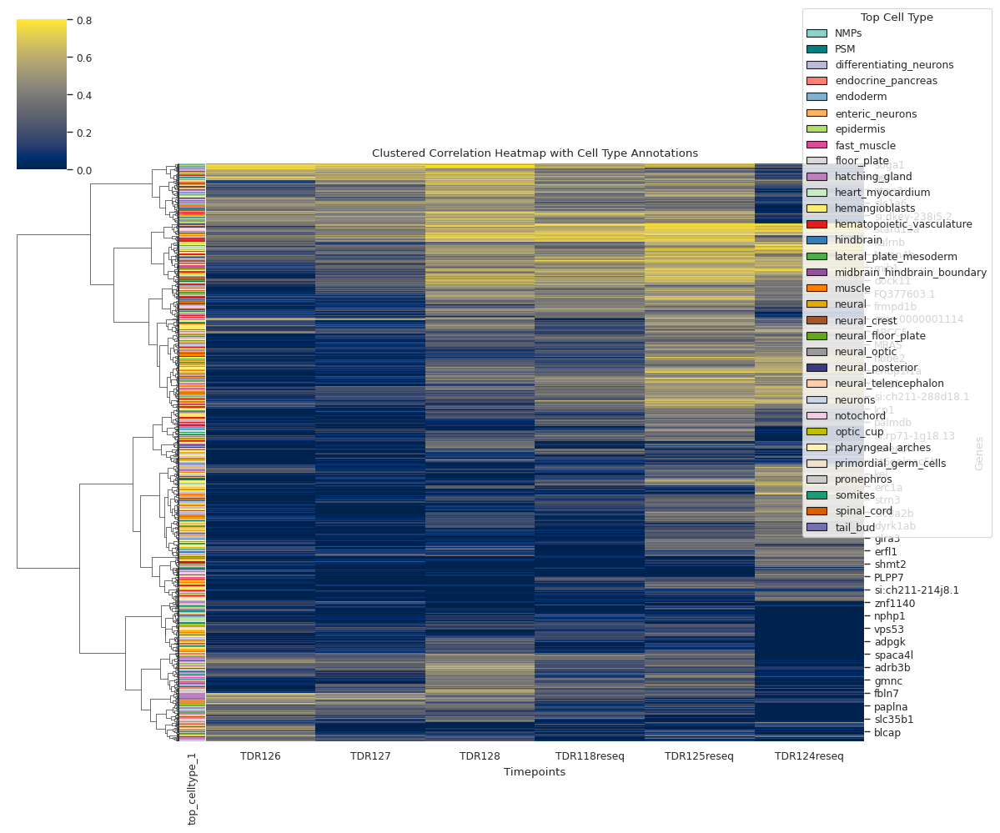

In [328]:
# Step 1: Ensure indices are aligned between df_corr and df_marker_celltypes
# Filter df_corr to contain only the genes present in df_marker_celltypes
df_corr_filtered = df_corr.loc[df_marker_celltypes.index]

# Step 2: Sort the genes by top_celltype_1 in df_marker_celltypes
df_marker_celltypes_sorted = df_marker_celltypes.sort_values(by='top_celltype_1')

# Reorder the df_corr_filtered based on the sorted cell types
df_corr_sorted = df_corr_filtered.loc[df_marker_celltypes_sorted.index]

# Step 3: Prepare row_colors for cell type annotations
unique_celltypes = df_marker_celltypes['top_celltype_1'].unique()
# celltype_palette = sns.color_palette('Set2', n_colors=len(unique_celltypes))
# lut = dict(zip(unique_celltypes, celltype_palette))

# Map the top_celltype_1 column to the color palette
row_colors = df_marker_celltypes_sorted['top_celltype_1'].map(cell_type_color_dict)

# Step 4: Perform hierarchical clustering on the temporal trends (rows)
# We are clustering the genes based on their temporal similarity
# Use 'ward' linkage (or another method like 'average' or 'complete') for clustering
linkage_matrix = linkage(df_corr_sorted, method='ward')

# Step 4: Plot the clustermap with only column clustering (timepoints)
g = sns.clustermap(
    df_corr_sorted,  # Correlation data sorted by cell type
    row_linkage=linkage_matrix,
    # row_cluster=False,  # Disable clustering on rows (genes)
    col_cluster=False,  # Enable clustering on columns (timepoints)
    cmap='cividis',  # Colormap for correlations
    row_colors=row_colors,  # Annotate rows with cell types
    figsize=(12, 10), vmin=0, vmax=0.8  # Adjust the size
)

# Adjust labels and plot
g.ax_heatmap.set_xlabel('Timepoints')
g.ax_heatmap.set_ylabel('Genes')
g.ax_heatmap.set_title('Clustered Correlation Heatmap with Cell Type Annotations')

# Create legend for the row_colors (cell types)
from matplotlib.patches import Patch
handles = [Patch(facecolor=cell_type_color_dict[celltype], edgecolor='k', label=celltype) for celltype in cell_type_color_dict]
plt.legend(handles=handles, title='Top Cell Type', bbox_to_anchor=(1, 1), bbox_transform=plt.gcf().transFigure)

plt.show()

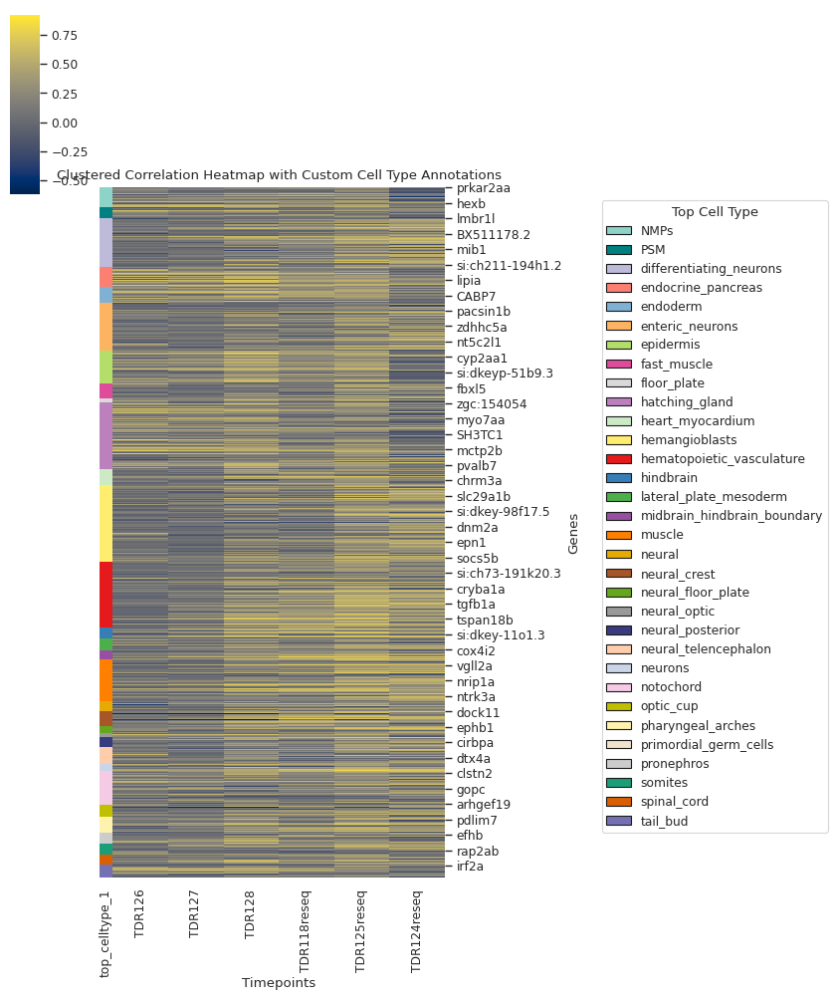

In [319]:
# Step 1: Ensure indices are aligned between df_corr and df_marker_celltypes
# Filter df_corr to contain only the genes present in df_marker_celltypes
df_corr_filtered = df_corr.loc[df_marker_celltypes.index]

# Step 2: Sort the genes by top_celltype_1 in df_marker_celltypes
df_marker_celltypes_sorted = df_marker_celltypes.sort_values(by='top_celltype_1')

# Reorder the df_corr_filtered based on the sorted cell types
df_corr_sorted = df_corr_filtered.loc[df_marker_celltypes_sorted.index]

# Step 3: Prepare row_colors for cell type annotations using the custom palette (cell_type_color_dict)
# Map the top_celltype_1 column to the color palette defined in `cell_type_color_dict`
row_colors = df_marker_celltypes_sorted['top_celltype_1'].map(cell_type_color_dict)

# Step 4: Perform hierarchical clustering on the temporal trends (rows)
# Use 'ward' linkage (or another method like 'average' or 'complete') for clustering based on gene similarity over timepoints
# linkage_matrix = linkage(df_corr_sorted, method='ward')

# Step 5: Plot the clustermap with only column clustering (timepoints)
g = sns.clustermap(
    df_corr_sorted,  # Correlation data sorted by cell type
    # row_linkage=linkage_matrix,  # Use the linkage matrix for row clustering
    row_cluster=False,
    col_cluster=False,  # Disable clustering on columns (timepoints)
    cmap='cividis',  # Colormap for correlations
    row_colors=row_colors,  # Annotate rows with cell types using custom color palette
    figsize=(6, 10)  # Adjust the size of the plot
)

# Adjust labels and plot
g.ax_heatmap.set_xlabel('Timepoints')
g.ax_heatmap.set_ylabel('Genes')
g.ax_heatmap.set_title('Clustered Correlation Heatmap with Custom Cell Type Annotations')

# Create legend for the row_colors (cell types) using the custom color palette
from matplotlib.patches import Patch
handles = [Patch(facecolor=cell_type_color_dict[celltype], edgecolor='k', label=celltype) for celltype in cell_type_color_dict.keys()]
plt.legend(handles=handles, title='Top Cell Type', bbox_to_anchor=(1.4, 0.8), bbox_transform=plt.gcf().transFigure)

# Show the plot
plt.show()

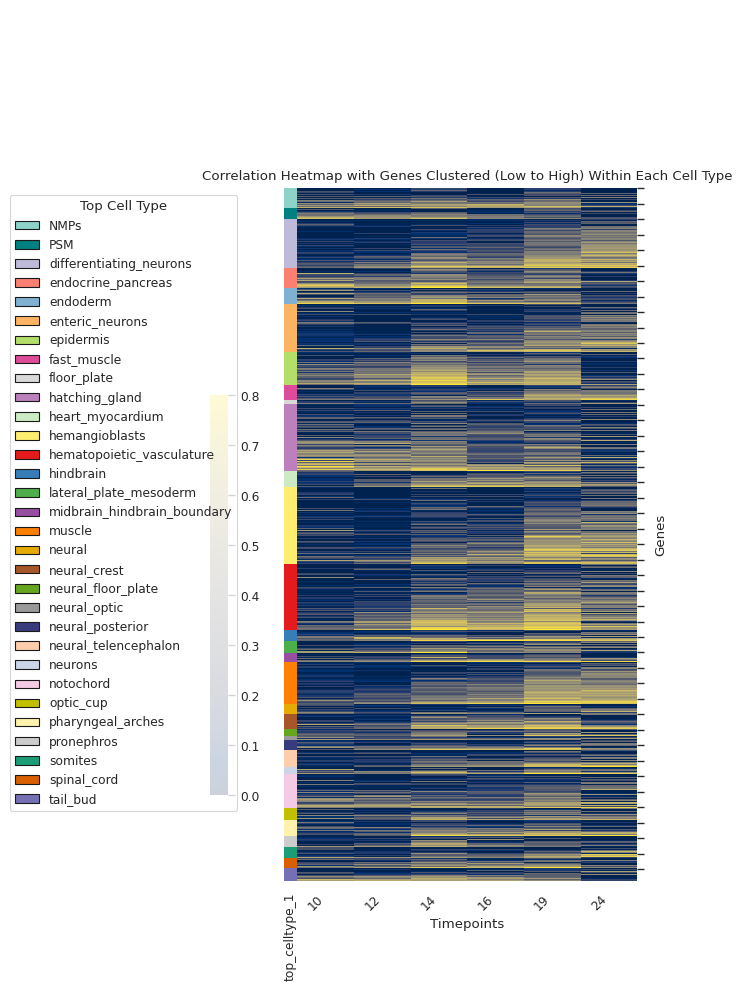

In [347]:
# Step 1: Ensure indices are aligned between df_corr and df_marker_celltypes
# Filter df_corr to contain only the genes present in df_marker_celltypes
df_corr_filtered = df_corr.loc[df_marker_celltypes.index]

# Step 2: Sort the genes by top_celltype_1 in df_marker_celltypes
df_marker_celltypes_sorted = df_marker_celltypes.sort_values(by='top_celltype_1')

# Step 3: Initialize a list to store the reordered indices
reordered_gene_indices = []

# For each cell type, cluster genes based on their mean expression (low to high)
for celltype in df_marker_celltypes_sorted['top_celltype_1'].unique():
    # Subset the genes for the current cell type
    genes_in_celltype = df_marker_celltypes_sorted[df_marker_celltypes_sorted['top_celltype_1'] == celltype].index
    
    # Subset the correlation data for the current cell type
    df_corr_subset = df_corr_filtered.loc[genes_in_celltype]
    
    # Compute the mean expression of each gene across all timepoints
    mean_expression_per_gene = df_corr_subset.mean(axis=1)
    
    # Sort the genes based on their mean expression (low to high)
    sorted_genes_in_celltype = mean_expression_per_gene.sort_values(ascending=True).index
    
    # Add the sorted genes for this cell type to the reordered_gene_indices list
    reordered_gene_indices.extend(sorted_genes_in_celltype)

# Reorder the full DataFrame (df_corr_filtered) based on the new gene order
df_corr_reordered = df_corr_filtered.loc[reordered_gene_indices]

# Step 4: Prepare row_colors for cell type annotations using the custom palette (cell_type_color_dict)
row_colors = df_marker_celltypes.loc[reordered_gene_indices]['top_celltype_1'].map(cell_type_color_dict)

# Step 5: Plot the heatmap with the genes clustered within each cell type (low to high expression)
g = sns.clustermap(
    df_corr_reordered,  # Reordered correlation data
    row_cluster=False,  # Disable row clustering (we are manually ordering the rows)
    col_cluster=False,  # Cluster columns (timepoints)
    cmap='cividis',  # Colormap for correlations
    row_colors=row_colors,  # Annotate rows with cell types using custom color palette
    figsize=(6, 10),  # Adjust the size of the plot
    vmin=0, vmax=0.8, 
)


# Set custom x-tick labels (timepoints)
g.ax_heatmap.set_xticklabels([10, 12, 14, 16, 19, 24], rotation=45, ha='right')
# Remove y-tick labels (gene labels)
g.ax_heatmap.set_yticklabels([])

# Adjust labels and plot
g.ax_heatmap.set_xlabel('Timepoints')
g.ax_heatmap.set_ylabel('Genes')
g.ax_heatmap.set_title('Correlation Heatmap with Genes Clustered (Low to High) Within Each Cell Type')

# # Create legend for the row_colors (cell types), move it outside of the plot to avoid overlap
# from matplotlib.patches import Patch
# handles = [Patch(facecolor=cell_type_color_dict[celltype], edgecolor='k', label=celltype) for celltype in df_marker_celltypes_sorted['top_celltype_1'].unique()]
# plt.legend(handles=handles, title='Top Cell Type', bbox_to_anchor=(1.5, 1), loc='upper left', borderaxespad=0)
# Create legend for the row_colors (cell types), move it farther to the right to avoid overlap
from matplotlib.patches import Patch
handles = [Patch(facecolor=cell_type_color_dict[celltype], edgecolor='k', label=celltype) for celltype in df_marker_celltypes_sorted['top_celltype_1'].unique()]

# # Adjust the bbox_to_anchor for the legend to move it farther to the right
# plt.legend(handles=handles, title='Top Cell Type', bbox_to_anchor=(1.5, 1.5), loc='upper right', borderaxespad=0)

# # Adjust the colorbar position
# g.cax.set_position([0.05, 0.2, 0.03, 0.4])  # Move the colorbar lower
# Adjust the bbox_to_anchor for the legend to move it farther to the right
plt.legend(handles=handles, title='Top Cell Type', bbox_to_anchor=(1.5, 1.5), loc='upper right', borderaxespad=0)

# Move the colorbar to the right side of the heatmap
g.cax.set_position([0.05, 0.2, 0.03, 0.4])  # [x, y, width, height], move to the right side

# Show the plot
plt.savefig(figpath + "heatmap_corr_coeff_timepoints_clustered_celltypes_top3000_cividis.pdf")
plt.show()

In [353]:
df_marker_celltypes

,top_celltype_1,top_celltype_2,mean_corr
Gene,,,
mt-co1,neural_crest,PSM,-0.251454
mt-co2,optic_cup,neural_crest,-0.223060
cldni,epidermis,enteric_neurons,0.383705
znf1100,spinal_cord,hindbrain,0.159551
mt-cyb,neural_crest,PSM,-0.298894
...,...,...,...
coq5,midbrain_hindbrain_boundary,muscle,0.129263
zgc:162612,lateral_plate_mesoderm,hematopoietic_vasculature,0.141330
elk4,PSM,tail_bud,0.014076


<Figure size 800x600 with 0 Axes>

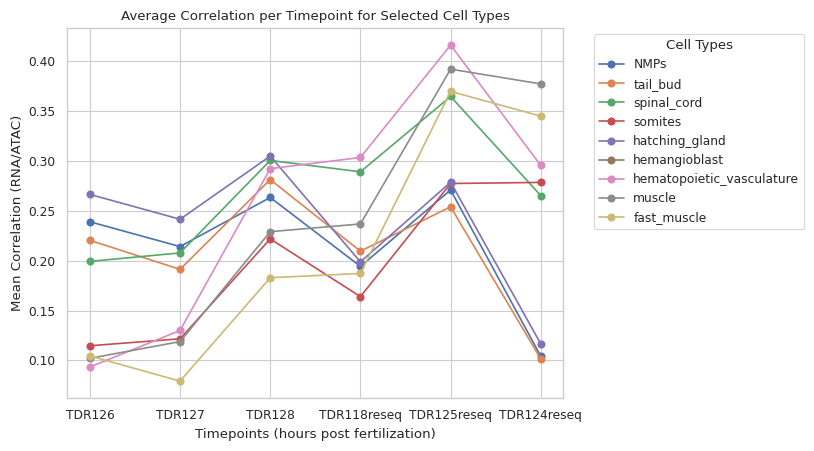

In [358]:
# Step 1: Ensure indices are aligned between df_corr and df_marker_celltypes
# Remove duplicate genes from df_marker_celltypes
df_marker_celltypes = df_marker_celltypes[~df_marker_celltypes.index.duplicated(keep='first')]

# Remove duplicate genes from df_corr
df_corr = df_corr[~df_corr.index.duplicated(keep='first')]

# Filter df_corr to contain only the genes present in df_marker_celltypes
df_corr_filtered = df_corr.loc[df_marker_celltypes.index]

# Step 2: Filter for the selected cell types
df_marker_selected = df_marker_celltypes[df_marker_celltypes['top_celltype_1'].isin(selected_celltypes)]

# Step 3: Initialize an empty DataFrame to store the mean correlations (celltype-by-timepoints)
mean_corr_df = pd.DataFrame(index=selected_celltypes, columns=df_corr.columns)

# Compute the mean correlation for each cell type and timepoint
for celltype in selected_celltypes:
    # Subset the genes for the current cell type
    genes_in_celltype = df_marker_selected[df_marker_selected['top_celltype_1'] == celltype].index
    
    # Subset the correlation data for these genes
    df_corr_subset = df_corr_filtered.loc[genes_in_celltype]
    
    # Compute the mean correlation across all genes for each timepoint
    mean_corr_per_timepoint = df_corr_subset.mean(axis=0)
    
    # Store the result in the mean_corr_df DataFrame
    mean_corr_df.loc[celltype] = mean_corr_per_timepoint

# Step 4: Plot the data as a lineplot
plt.figure(figsize=(8, 6))
mean_corr_df.T.plot(kind='line', marker='o')

# Customize the plot
plt.xlabel('Timepoints (hours post fertilization)')
plt.ylabel('Mean Correlation (RNA/ATAC)')
plt.title('Average Correlation per Timepoint for Selected Cell Types')
plt.legend(title='Cell Types', bbox_to_anchor=(1.05, 1), loc='upper left')

# Show the plot
plt.show()

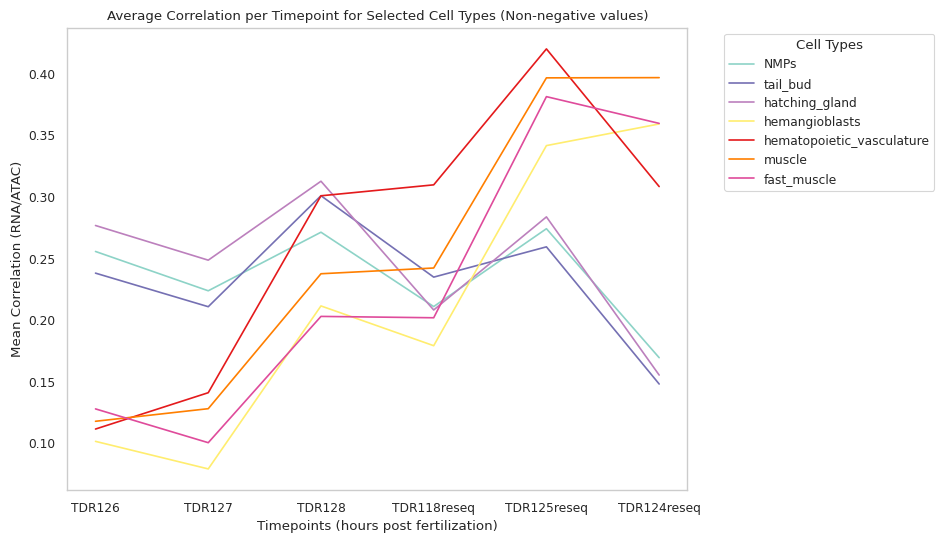

In [370]:
# List of selected cell types
selected_celltypes = ['NMPs', 'tail_bud', 'hatching_gland', 
                      'hemangioblasts', 'hematopoietic_vasculature', 'muscle', 'fast_muscle']

# Step 1: Ensure indices are aligned between df_corr and df_marker_celltypes
# Remove duplicate genes from df_marker_celltypes
df_marker_celltypes = df_marker_celltypes[~df_marker_celltypes.index.duplicated(keep='first')]

# Remove duplicate genes from df_corr
df_corr = df_corr[~df_corr.index.duplicated(keep='first')]

# Filter df_corr to contain only the genes present in df_marker_celltypes
df_corr_filtered = df_corr.loc[df_marker_celltypes.index]

# Step 2: Filter for the selected cell types
df_marker_selected = df_marker_celltypes[df_marker_celltypes['top_celltype_1'].isin(selected_celltypes)]

# Step 3: Initialize an empty DataFrame to store the mean correlations (celltype-by-timepoints)
mean_corr_df = pd.DataFrame(index=selected_celltypes, columns=df_corr.columns)

# Compute the mean correlation for each cell type and timepoint, replacing negative values with 0
for celltype in selected_celltypes:
    # Subset the genes for the current cell type
    genes_in_celltype = df_marker_selected[df_marker_selected['top_celltype_1'] == celltype].index
    
    # Subset the correlation data for these genes
    df_corr_subset = df_corr_filtered.loc[genes_in_celltype]
    
    # Replace negative correlations with 0
    df_corr_subset = df_corr_subset.applymap(lambda x: max(0, x))
    
    # Compute the mean correlation across all genes for each timepoint
    mean_corr_per_timepoint = df_corr_subset.mean(axis=0)
    
    # Store the result in the mean_corr_df DataFrame
    mean_corr_df.loc[celltype] = mean_corr_per_timepoint

# Step 4: Plot the data as a lineplot
# plt.figure(figsize=(8, 6))
# mean_corr_df.T.plot(kind='line', marker='o')
plt.figure(figsize=(8, 6))
sns.lineplot(data=mean_corr_df.T, palette=cell_type_color_dict, dashes=False, markers=None)

# Customize the plot
plt.xlabel('Timepoints (hours post fertilization)')
plt.ylabel('Mean Correlation (RNA/ATAC)')
plt.title('Average Correlation per Timepoint for Selected Cell Types (Non-negative values)')
plt.legend(title='Cell Types', bbox_to_anchor=(1.05, 1), loc='upper left')

# Show the plot
plt.grid(False)
plt.savefig(figpath + "marker_genes_per_celltype_patterns.pdf")
plt.show()

In [364]:
df_marker_celltypes

,top_celltype_1,top_celltype_2,mean_corr
Gene,,,
mt-co1,neural_crest,PSM,-0.251454
mt-co2,optic_cup,neural_crest,-0.223060
cldni,epidermis,enteric_neurons,0.383705
znf1100,spinal_cord,hindbrain,0.159551
mt-cyb,neural_crest,PSM,-0.298894
...,...,...,...
coq5,midbrain_hindbrain_boundary,muscle,0.129263
zgc:162612,lateral_plate_mesoderm,hematopoietic_vasculature,0.141330
elk4,PSM,tail_bud,0.014076


In [366]:
df_marker_celltypes[df_marker_celltypes["top_celltype_1"]=="NMPs"].index

Index(['grm2b', 'wu:fc23c09', 'tomm5', 'skap2', 'prtgb', 'eea1', 'polb',
       'si:ch73-303b9.1', 'cdx4', 'acin1a', 'si:dkey-67c22.2', 'selenon',
       'sfrp2l', 'hoxd11a', 'dao.3', 'vent', 'si:dkey-235d18.5', 'cmtr1',
       'hmgn2', 'wdr27', 'hoxb10a', 'hexb', 'rc3h1a', 'tbxtb', 'gad1a',
       'hepacama', 'depdc7a', 'znf1042', 'hnrnpa0l.1', 'nlgn3b',
       'si:cabz01071912.2', 'kcnj5', 'psd3l', 'aebp1', 'mea1', 'srsf2a',
       'si:dkey-253d23.9', 'lrrc8db', 'mis18bp1', 'adamts18', 'mta3',
       'hoxa13a', 'rims3', 'cyp26a1', 'grk5', 'hoxa13b', 'cep97', 'hoxc8a',
       'kdm7aa', 'ubl3a', 'hoxc13b', 'smarcd3b', 'thbs2a', 'wnt2bb',
       'slc12a7b', 'hoxd10a', 'meaf6', 'akr1b1.1', 'si:ch211-119e14.1',
       'syngap1a', 'prkar2aa', 'slc25a32a', 'arhgef40', 'si:ch211-199b20.3',
       'prom2', 'si:dkey-27p23.3', 'CABZ01046980.1', 'wdr92', 'gpcpd1',
       'clip2', 'si:dkey-92i17.2', 'smc2', 'mphosph8', 'hoxa10b', 'dek',
       'lrriq1', 'srrm1', 'znf1140', 'bmp7a', 'tmpoa', 'wls'

In [361]:
cell_type_color_dict

{'NMPs': '#8dd3c7',
 'PSM': '#008080',
 'differentiating_neurons': '#bebada',
 'endocrine_pancreas': '#fb8072',
 'endoderm': '#80b1d3',
 'enteric_neurons': '#fdb462',
 'epidermis': '#b3de69',
 'fast_muscle': '#df4b9b',
 'floor_plate': '#d9d9d9',
 'hatching_gland': '#bc80bd',
 'heart_myocardium': '#ccebc5',
 'hemangioblasts': '#ffed6f',
 'hematopoietic_vasculature': '#e41a1c',
 'hindbrain': '#377eb8',
 'lateral_plate_mesoderm': '#4daf4a',
 'midbrain_hindbrain_boundary': '#984ea3',
 'muscle': '#ff7f00',
 'neural': '#e6ab02',
 'neural_crest': '#a65628',
 'neural_floor_plate': '#66a61e',
 'neural_optic': '#999999',
 'neural_posterior': '#393b7f',
 'neural_telencephalon': '#fdcdac',
 'neurons': '#cbd5e8',
 'notochord': '#f4cae4',
 'optic_cup': '#c0c000',
 'pharyngeal_arches': '#fff2ae',
 'primordial_germ_cells': '#f1e2cc',
 'pronephros': '#cccccc',
 'somites': '#1b9e77',
 'spinal_cord': '#d95f02',
 'tail_bud': '#7570b3'}

### gene set enrichment analysis (GSEA)

- we will use the Enrichr implemented in GSEApy



In [229]:
genes_clust_1 = clusts[clusts.gene_cluster=="1"].Gene.to_list()

In [230]:
clusts[clusts.gene_cluster=="1"].Gene

7         si:ch73-217b7.1
18                   snd1
19                 cyp2y3
36                  he1.1
43        si:dkey-269i1.4
              ...        
2939                 myf5
2946                kmt2a
2950    si:ch211-204c21.1
2965                tbxta
2990                gfpt2
Name: Gene, Length: 437, dtype: object

In [239]:
# Filter for the row where the Gene column is 'slc4a1a'
gene_row = clusts[clusts['Gene'] == 'slc4a1a']

# Display the result
print(gene_row)

       Gene gene_cluster cluster_group  sort_key
13  slc4a1a            4       Group 1         3


In [240]:
# Filter for the row where the Gene column is 'cdx1a'
gene_row = clusts[clusts['Gene'] == 'cdx1a']

# Display the result
print(gene_row)

      Gene gene_cluster cluster_group  sort_key
536  cdx1a            1       Group 2         0


In [232]:
print("slc4a1a" in genes_clust_1)
print("myf5" in genes_clust_1)
print("tbxta" in genes_clust_1)

False
True
True


In [36]:
# gene_cluster 1
genes_clust_1 = clusts[clusts.gene_cluster=="1"].Gene.to_list()

# save as a txt file
with open("genes_clust_1.txt", 'w') as output:
    for row in genes_clust_1:
        output.write(str(row) + '\n')

In [43]:
# gene_cluster 2
genes_clust_2 = clusts[clusts.gene_cluster=="2"].Gene.to_list()

# save as a txt file
with open("genes_clust_2.txt", 'w') as output:
    for row in genes_clust_2:
        output.write(str(row) + '\n')

In [45]:
# gene_cluster 3
genes_clust_3 = clusts[clusts.gene_cluster=="3"].Gene.to_list()

# save as a txt file
with open("genes_clust_3.txt", 'w') as output:
    for row in genes_clust_3:
        output.write(str(row) + '\n')

In [47]:
# gene_cluster 4
genes_clust_4 = clusts[clusts.gene_cluster=="4"].Gene.to_list()

# save as a txt file
with open("genes_clust_4.txt", 'w') as output:
    for row in genes_clust_4:
        output.write(str(row) + '\n')

In [49]:
# gene_cluster 5
genes_clust_5 = clusts[clusts.gene_cluster=="5"].Gene.to_list()

# save as a txt file
with open("genes_clust_5.txt", 'w') as output:
    for row in genes_clust_5:
        output.write(str(row) + '\n')

In [ ]:
hbbe1

In [57]:
clusts[clusts.Gene=="hbbe1.1"]

,Gene,gene_cluster,sort_key
471,hbbe1.1,5,2


In [23]:
markers_endo = ["fgfrl1b","col2a1a","ptprfa","emid1","nr5a2","ism2a","pawr","mmp15b","foxa3","onecut1"]
markers_meso = ["msgn1","meox1","tbx6","tbxta","fgf8a","her1"]
markers_neuro = ["pax7a","pax6a","pax6b","col18a1a","en2b","znf536","gpm6aa","gli3","chl1a"]
markers_hemato = ["lmo2","etv2","tal1","sox17"]
manual_markers = ["hbbe3","sox2","myf5","meis1a","meis3","nr2f5"]

import itertools

list_markers = list(itertools.chain(markers_endo, markers_meso, markers_neuro, markers_hemato, manual_markers))
list_markers

['fgfrl1b',
 'col2a1a',
 'ptprfa',
 'emid1',
 'nr5a2',
 'ism2a',
 'pawr',
 'mmp15b',
 'foxa3',
 'onecut1',
 'msgn1',
 'meox1',
 'tbx6',
 'tbxta',
 'fgf8a',
 'her1',
 'pax7a',
 'pax6a',
 'pax6b',
 'col18a1a',
 'en2b',
 'znf536',
 'gpm6aa',
 'gli3',
 'chl1a',
 'lmo2',
 'etv2',
 'tal1',
 'sox17',
 'hbbe3',
 'sox2',
 'myf5',
 'meis1a',
 'meis3',
 'nr2f5']

In [346]:
list_genes = [
 #'fgfrl1b',
 #'col2a1a',
 #'foxa3',
 'msgn1',
 #'meox1',
 'tbx6',
 #'tbxta',
 #'fgf8a',
 #'her1',
 'pax7a',
 #'pax6a',
 #'pax6b',
 #'en2b',
 'gli3',
 #'lmo2',
 #'sox17',
 'hbbe3',
 #'sox2',
 'myf5',
 'foxd3']

In [24]:
df_exp_sorted.head(30).index

Index(['zgc:163057', 'mt-co1', 'znf1100', 'mt-cyb', 'col1a1b', 'prdx3',
       'col12a1b', 'antxr2b', 'add2', 'dab1a', 'hbbe3', 'usp10', 'kcnh3',
       'mt-co2', 'atp5pb', 'si:dkey-261o4.1', 'cpne5b', 'slc43a3a', 'klf1',
       'susd1', 'hbae5', 'rfesd', 'ncanb', 'ripor3', 'xpr1a', 'uncx', 'gabrb4',
       'mt-co3', 'nkain2', 'pcdh9'],
      dtype='object', name='Gene')

In [47]:
list_dynamic_genes = ["hbbe3","hbae5","slc4a1a",
                      "hoxc8a","myo9b","sox17","cdx1a","wnt9b",
                      "myf5","msgn1","tbx6","myl1","six7"]

In [481]:
for marker in list_markers:
    print(df.loc[marker])

TDR126         0.790356
TDR127         0.702925
TDR128         0.746649
TDR118reseq    0.714063
TDR125reseq    0.616443
TDR124reseq    0.436586
Name: fgfrl1b, dtype: float64
TDR126         0.653300
TDR127         0.682510
TDR128         0.675558
TDR118reseq    0.518834
TDR125reseq    0.628697
TDR124reseq    0.424681
Name: col2a1a, dtype: float64
TDR126         0.473055
TDR127         0.588734
TDR128         0.735480
TDR118reseq    0.679762
TDR125reseq    0.698590
TDR124reseq    0.484946
Name: ptprfa, dtype: float64
TDR126         0.620364
TDR127         0.511505
TDR128         0.686849
TDR118reseq    0.513715
TDR125reseq    0.440821
TDR124reseq    0.130672
Name: emid1, dtype: float64
TDR126         0.409816
TDR127         0.323083
TDR128         0.510578
TDR118reseq    0.354760
TDR125reseq    0.393828
TDR124reseq    0.296510
Name: nr5a2, dtype: float64
TDR126         0.601150
TDR127         0.588160
TDR128         0.598050
TDR118reseq    0.464652
TDR125reseq    0.519978
TDR124reseq    

In [26]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Normalize the data (z-score normalization)
scaler = StandardScaler()
df_normalized = pd.DataFrame(scaler.fit_transform(df_corr.T).T, index=df_corr.index, columns=df_corr.columns)

# Perform k-means clustering
kmeans = KMeans(n_clusters=4, random_state=0)
df_corr['Cluster'] = kmeans.fit_predict(df_normalized)

# Sort the DataFrame by cluster labels
df_sorted = df_corr.sort_values('Cluster').drop(columns='Cluster')

/home/yang-joon.kim/.conda/envs/seacells/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [28]:
df_sorted

,TDR126,TDR127,TDR128,TDR118reseq,TDR125reseq,TDR124reseq
Gene,,,,,,
hibch,-0.105315,-0.123084,0.050120,0.042803,-0.178043,0.085691
olfm3b,0.022692,0.079672,0.002740,-0.038438,-0.021624,0.087171
si:dkey-100n23.3,0.112221,-0.215410,0.000964,-0.011008,-0.048770,0.245327
cenpl,0.095427,0.053097,-0.088133,0.090130,0.184033,0.173244
cenpk,0.155995,0.017471,0.321338,0.065982,0.269907,0.348435
...,...,...,...,...,...,...
cux1a,0.277339,0.422638,0.610372,0.483305,0.674395,0.682674
si:ch211-120e1.7,-0.015252,0.099021,0.032904,0.138248,0.192179,0.227417
si:ch211-121a2.2,0.033326,-0.020639,0.150668,0.093618,0.156004,0.202410


In [401]:
# df_diff.sort_values("Difference",ascending=False)

,Difference
Gene,
mt-cyb,3.437307
mt-co3,3.422718
mt-atp6,3.408053
si:ch211-262h13.5,3.359598
mt-co2,3.349133
...,...
ptprfb,-0.811751
sulf1,-0.813864
rarga,-0.835975


In [405]:
# df.sort_values("Difference")

,TDR126,TDR127,TDR128,TDR118reseq,TDR125reseq,TDR124reseq,Cluster,Difference
Gene,,,,,,,,
ctslb,0.629542,0.608623,0.408236,0.116157,0.193177,-0.133200,3,-0.762742
itpr3,0.625878,0.472737,0.426993,0.337389,0.320953,-0.109910,3,-0.735788
farp1,0.636553,0.505866,0.540656,0.375316,0.270483,-0.084698,3,-0.721250
cdh12a,0.503523,0.225896,0.334638,0.171263,0.228214,-0.210056,3,-0.713578
alpi.1,0.452611,0.516790,0.493583,0.277868,0.395016,-0.257381,3,-0.709992
...,...,...,...,...,...,...,...,...
si:dkey-93h22.7,-0.256474,-0.198250,0.012947,0.110166,0.202051,0.531708,1,0.788182
kank4,-0.040675,0.139235,0.383044,0.501808,0.518129,0.751455,1,0.792130
si:dkey-261o4.1,-0.008710,-0.014897,-0.006849,-0.015220,-0.020341,0.831309,1,0.840018


/home/yang-joon.kim/.conda/envs/seacells/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/home/yang-joon.kim/.local/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


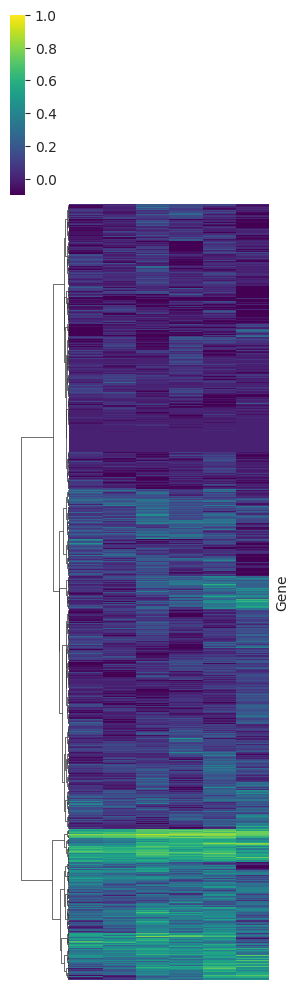

In [428]:
# Using the differences between the first and the last timepoints to compute the "difference",
# then, use it for the k-means clustering
df['Difference'] = df_corr.iloc[:, -3] - df_corr.iloc[:, 0]

# Reshape for clustering
df_diff = df[['Difference']]

# Perform k-means clustering based on the difference
kmeans = KMeans(n_clusters=4, random_state=0)
df['Cluster'] = kmeans.fit_predict(df_diff)

# Sort the DataFrame by cluster labels
df_sorted = df.sort_values('Cluster').drop(columns=['Difference', 'Cluster'])

# Plot the clustermap
sns.clustermap(df_sorted, method='ward', metric='euclidean', cmap='viridis', 
               row_cluster=True, col_cluster=False, 
               xticklabels=False, yticklabels=False, 
               figsize=(3, 10), vmax=1, vmin=-0.1)

plt.show()

In [562]:
most_prevalent
prevalent_count

SEACell
SEACell-0       69
SEACell-1       16
SEACell-2       71
SEACell-3       29
SEACell-4       75
              ... 
SEACell-194     53
SEACell-195     87
SEACell-196     62
SEACell-197     29
SEACell-198    119
Name: annotation_ML_coarse, Length: 199, dtype: int64

In [560]:
total_counts

SEACell
SEACell-0       94
SEACell-1       16
SEACell-2       74
SEACell-3       40
SEACell-4       87
              ... 
SEACell-194     53
SEACell-195     87
SEACell-196     62
SEACell-197     31
SEACell-198    122
Name: annotation_ML_coarse, Length: 199, dtype: int64

In [564]:
'/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/05_SEACells_processed/'

'/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/05_SEACells_processed/'

In [30]:
# check the RNA/ATAC correlation at each timepoint as the scatter plot

# define the list of datasets (data_id)
list_datasets = ['TDR126', 'TDR127', 'TDR128',
                'TDR118reseq', 'TDR125reseq', 'TDR124reseq']

# first, import all datasets (adata) and save in a dictionary
dict_meta_ad = {}

# define the directory for the data path
seacellpath = "/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/05_SEACells_processed/"

for data_id in list_datasets:
    # define the sample_id (withou "reseq" in the handle)
    sample_id = data_id.replace("reseq","")
    
    # improt the single-cell adata's annotation (with adata.obs["SEACell"] annotation)
    df_seacells = pd.read_csv(seacellpath + f"{data_id}_seacells_obs_annotation_ML_coarse.csv", index_col=0)
    
    # Group by SEACell and find the most prevalent annotation for each SEACell
    most_prevalent = df_seacells.groupby('SEACell')['annotation_ML_coarse'].agg(lambda x: x.value_counts().idxmax())
    prevalent_count = df_seacells.groupby('SEACell')['annotation_ML_coarse'].agg(lambda x: x.value_counts().max())
    total_counts = df_seacells.groupby('SEACell')['annotation_ML_coarse'].count()
    prevalent_freq = prevalent_count/total_counts

    # define a dataframe
    df_prevalent = pd.DataFrame({
        'SEACell': most_prevalent.index,
        'most_prevalent_annotation': most_prevalent.values,
        'prevalent_frequency': prevalent_freq.values
    })

    df_prevalent.set_index("SEACell", inplace=True)
    df_prevalent

    # Convert the result to a dictionary
    seacell_to_annotation = df_prevalent["most_prevalent_annotation"].to_dict()
    # print(seacell_to_annotation)

    # import RNA adata (aggregated over seacells)
    rna_meta_ad = sc.read_h5ad(seacellpath + f"{data_id}/{sample_id}_RNA_seacells_aggre.h5ad")
    #import ATAC adata (aggregated over seacells)
    atac_meta_ad = sc.read_h5ad(seacellpath + f"{data_id}/{sample_id}_ATAC_seacells_aggre.h5ad")
    
    # First, we'll subset the features that are shared between RNA and ATAC (gene names)
    shared_genes = np.intersect1d(rna_meta_ad.var_names, atac_meta_ad.var_names)
    print(f"Number of shared genes: {len(shared_genes)}")

    # subset the RNA and ATAC objects for the shared genes
    rna_meta_ad = rna_meta_ad[:, shared_genes]
    atac_meta_ad = atac_meta_ad[:, shared_genes]
    
    # transfer the "most prevalent celltype" annotation to the aggregated objects
    rna_meta_ad.obs["celltype"] = rna_meta_ad.obs_names.map(seacell_to_annotation)
    atac_meta_ad.obs["celltype"] = atac_meta_ad.obs_names.map(seacell_to_annotation)
    
    # save in a dictionary
    dict_meta_ad[f"{sample_id}_rna"] = rna_meta_ad
    dict_meta_ad[f"{sample_id}_atac"] = atac_meta_ad
    

    

Number of shared genes: 24942


/tmp/ipykernel_277282/3818054345.py:54: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  rna_meta_ad.obs["celltype"] = rna_meta_ad.obs_names.map(seacell_to_annotation)
/tmp/ipykernel_277282/3818054345.py:55: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  atac_meta_ad.obs["celltype"] = atac_meta_ad.obs_names.map(seacell_to_annotation)


Number of shared genes: 24943


/tmp/ipykernel_277282/3818054345.py:54: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  rna_meta_ad.obs["celltype"] = rna_meta_ad.obs_names.map(seacell_to_annotation)
/tmp/ipykernel_277282/3818054345.py:55: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  atac_meta_ad.obs["celltype"] = atac_meta_ad.obs_names.map(seacell_to_annotation)


Number of shared genes: 24936


/tmp/ipykernel_277282/3818054345.py:54: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  rna_meta_ad.obs["celltype"] = rna_meta_ad.obs_names.map(seacell_to_annotation)
/tmp/ipykernel_277282/3818054345.py:55: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  atac_meta_ad.obs["celltype"] = atac_meta_ad.obs_names.map(seacell_to_annotation)


Number of shared genes: 24923


/tmp/ipykernel_277282/3818054345.py:54: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  rna_meta_ad.obs["celltype"] = rna_meta_ad.obs_names.map(seacell_to_annotation)
/tmp/ipykernel_277282/3818054345.py:55: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  atac_meta_ad.obs["celltype"] = atac_meta_ad.obs_names.map(seacell_to_annotation)


Number of shared genes: 24940


/tmp/ipykernel_277282/3818054345.py:54: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  rna_meta_ad.obs["celltype"] = rna_meta_ad.obs_names.map(seacell_to_annotation)
/tmp/ipykernel_277282/3818054345.py:55: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  atac_meta_ad.obs["celltype"] = atac_meta_ad.obs_names.map(seacell_to_annotation)


Number of shared genes: 24889


/tmp/ipykernel_277282/3818054345.py:54: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  rna_meta_ad.obs["celltype"] = rna_meta_ad.obs_names.map(seacell_to_annotation)
/tmp/ipykernel_277282/3818054345.py:55: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  atac_meta_ad.obs["celltype"] = atac_meta_ad.obs_names.map(seacell_to_annotation)


In [31]:
dict_meta_ad.keys()

dict_keys(['TDR126_rna', 'TDR126_atac', 'TDR127_rna', 'TDR127_atac', 'TDR128_rna', 'TDR128_atac', 'TDR118_rna', 'TDR118_atac', 'TDR125_rna', 'TDR125_atac', 'TDR124_rna', 'TDR124_atac'])

In [32]:
# colormap
# Define the timepoints
timepoints = ['TDR126', 'TDR127', 'TDR128', 'TDR118', 'TDR125', 'TDR124']

# Load the "viridis" colormap
viridis = plt.cm.get_cmap('viridis', 256)

# Select a subset of the colormap to ensure that "30 somites" is yellow
# You can adjust the start and stop indices to shift the colors
start = 50
stop = 256
colors = viridis(np.linspace(start/256, stop/256, len(timepoints)))

# Create a dictionary to map timepoints to colors
color_dict = dict(zip(timepoints, colors))
color_dict

/tmp/ipykernel_277282/3521874674.py:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  viridis = plt.cm.get_cmap('viridis', 256)


{'TDR126': array([0.255645, 0.260703, 0.528312, 1.      ]),
 'TDR127': array([0.180629, 0.429975, 0.557282, 1.      ]),
 'TDR128': array([0.123463, 0.581687, 0.547445, 1.      ]),
 'TDR118': array([0.226397, 0.728888, 0.462789, 1.      ]),
 'TDR125': array([0.575563, 0.844566, 0.256415, 1.      ]),
 'TDR124': array([0.993248, 0.906157, 0.143936, 1.      ])}

In [33]:
# A module to define the color palettes used in this paper
import matplotlib.pyplot as plt
import seaborn as sns

# a color palette for the "coarse" grained celltype annotation ("annotation_ML_coarse")
cell_type_color_dict = {
    'NMPs': '#8dd3c7',
    'PSM': '#008080',
    'differentiating_neurons': '#bebada',
    'endocrine_pancreas': '#fb8072',
    'endoderm': '#80b1d3',
    'enteric_neurons': '#fdb462',
    'epidermis': '#b3de69',
    'fast_muscle': '#df4b9b',
    'floor_plate': '#d9d9d9',
    'hatching_gland': '#bc80bd',
    'heart_myocardium': '#ccebc5',
    'hemangioblasts': '#ffed6f',
    'hematopoietic_vasculature': '#e41a1c',
    'hindbrain': '#377eb8',
    'lateral_plate_mesoderm': '#4daf4a',
    'midbrain_hindbrain_boundary': '#984ea3',
    'muscle': '#ff7f00',
    'neural': '#e6ab02',
    'neural_crest': '#a65628',
    'neural_floor_plate': '#66a61e',
    'neural_optic': '#999999',
    'neural_posterior': '#393b7f',
    'neural_telencephalon': '#fdcdac',
    'neurons': '#cbd5e8',
    'notochord': '#f4cae4',
    'optic_cup': '#c0c000',
    'pharyngeal_arches': '#fff2ae',
    'primordial_germ_cells': '#f1e2cc',
    'pronephros': '#cccccc',
    'somites': '#1b9e77',
    'spinal_cord': '#d95f02',
    'tail_bud': '#7570b3'
}


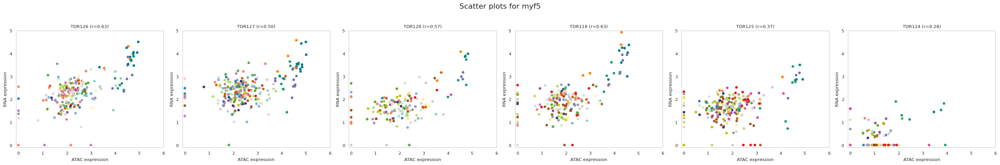

In [41]:
list_timepoints = ['TDR126', 'TDR127', 'TDR128', 'TDR118', 'TDR125', 'TDR124']

# for each gene, generate the time-resolved scatter plots for the RNA/ATAC correlation
for gene in ["myf5"]:
    fig, axs = plt.subplots(1, 6, figsize=(30,5))
    # loop over all timepoints
    for index, sample_id in enumerate(list_timepoints):
        # extract the rna_ad and atac_ad
        rna_ad = dict_meta_ad[f"{sample_id}_rna"]
        atac_ad = dict_meta_ad[f"{sample_id}_atac"]
        
        # compute the correlation between RNA and ATAC
        expr_rna = rna_ad[:, gene].X.toarray().flatten()
        expr_atac = atac_ad[:, gene].X.toarray().flatten()
        
        # if either exp1 or expr2 are "constant", then
        if np.all(expr_rna == expr_rna[0]) or np.all(expr_atac == expr_atac[0]):
            correlation = np.nan
        else:
            correlation, _ = pearsonr(expr_atac, expr_rna)
        
        # Get the cell type for each cell
        cell_types = rna_ad.obs["celltype"]
        
        # Map the cell type to colors
        colors = cell_types.map(cell_type_color_dict)
        
        # Plot the scatter plot for the current timepoint
        axs[index].scatter(expr_atac, expr_rna, c=colors)
        axs[index].set_title(f"{sample_id} (r={correlation:.2f})")
        axs[index].set_xlabel('ATAC expression')
        axs[index].set_ylabel('RNA expression')
        axs[index].grid(False)
        axs[index].set_xlim([-0.1, 6])
        axs[index].set_ylim([-0.1, 5])
    
    plt.suptitle(f"Scatter plots for {gene}", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to fit the main title

    # plt.savefig(figpath + f"scatter_atac_rna_{gene}.png")
    # plt.savefig(figpath + f"scatter_atac_rna_{gene}.pdf")
    plt.show()
        

In [44]:
figpath = "/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/zebrahub-multiome-analysis/figures/RNA_ATAC_corr_seacells/"

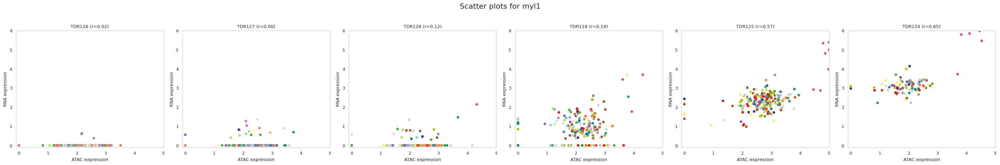

In [45]:
# for each gene, generate the time-resolved scatter plots for the RNA/ATAC correlation
for gene in ["myl1"]:
    fig, axs = plt.subplots(1, 6, figsize=(30,5))
    # loop over all timepoints
    for index, sample_id in enumerate(list_timepoints):
        # extract the rna_ad and atac_ad
        rna_ad = dict_meta_ad[f"{sample_id}_rna"]
        atac_ad = dict_meta_ad[f"{sample_id}_atac"]
        
        # compute the correlation between RNA and ATAC
        expr_rna = rna_ad[:, gene].X.toarray().flatten()
        expr_atac = atac_ad[:, gene].X.toarray().flatten()
        
        # if either exp1 or expr2 are "constant", then
        if np.all(expr_rna == expr_rna[0]) or np.all(expr_atac == expr_atac[0]):
            correlation = np.nan
        else:
            correlation, _ = pearsonr(expr_atac, expr_rna)
        
        # Get the cell type for each cell
        cell_types = rna_ad.obs["celltype"]
        
        # Map the cell type to colors
        colors = cell_types.map(cell_type_color_dict)
        
        # Plot the scatter plot for the current timepoint
        axs[index].scatter(expr_atac, expr_rna, color=colors)
        axs[index].set_title(f"{sample_id} (r={correlation:.2f})")
        axs[index].set_xlabel('ATAC expression')
        axs[index].set_ylabel('RNA expression')
        axs[index].grid(False)
        axs[index].set_xlim([-0.1, 5])
        axs[index].set_ylim([-0.1, 6])
    
    plt.suptitle(f"Scatter plots for {gene}", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to fit the main title

    plt.savefig(figpath + f"scatter_atac_rna_{gene}.png")
    plt.savefig(figpath + f"scatter_atac_rna_{gene}.pdf")
    plt.show()

In [512]:
df_exp_sorted.head(100).index

Index(['zgc:163057', 'mt-co1', 'znf1100', 'mt-cyb', 'col1a1b', 'prdx3',
       'col12a1b', 'antxr2b', 'add2', 'dab1a', 'hbbe3', 'usp10', 'kcnh3',
       'mt-co2', 'atp5pb', 'si:dkey-261o4.1', 'cpne5b', 'slc43a3a', 'klf1',
       'susd1', 'hbae5', 'rfesd', 'ncanb', 'ripor3', 'xpr1a', 'uncx', 'gabrb4',
       'mt-co3', 'nkain2', 'pcdh9', 'slc4a1a', 'cspg4', 'tfr1a',
       'CABZ01065328.1', 'kank4', 'rasip1', 'myhz2', 'ephb6', 'mapk10',
       'efcc1', 'si:ch211-26b3.4', 'ehbp1l1a', 'dscamb', 'col1a1a', 'KCNB2',
       'fabp7a', 'glipr2', 'plac8l1', 'myl1', 'bcas2', 'si:ch73-236e11.2',
       'tbx5a', 'apc2', 'si:dkey-31f5.11', 'anp32b', 'hbbe2', 'gabbr1b',
       'acer2', 'vwa7', 'ecscr', 'aqp8a.2', 'si:ch211-227m13.1', 'mt-atp6',
       'pcdh2ab9', 'nid1a', 'NRXN2', 'kcnq3', 'camta1', 'prtgb', 'lingo4b',
       'dipk2b', 'celf5a', 'abcc8', 'blvrb', 'scn4ab', 'magi3b', 'clic2',
       'stx1b', 'tubb1', 'alpk3b', 'usp13', 'jak2a', 'mt-nd4', 'SRCIN1',
       'slc40a1', 'gpm6aa', 'hif1al2'

In [49]:
list_genes_test = ['tbx5a', 'apc2', 'si:dkey-31f5.11', 'anp32b', 'hbbe2', 'gabbr1b',
       'acer2', 'vwa7', 'ecscr', 'aqp8a.2', 'si:ch211-227m13.1', 'mt-atp6',
       'pcdh2ab9', 'nid1a', 'NRXN2', 'kcnq3', 'camta1', 'prtgb', 'lingo4b',
       'dipk2b', 'celf5a', 'abcc8', 'blvrb', 'scn4ab', 'magi3b', 'clic2',
       'stx1b', 'tubb1', 'alpk3b', 'usp13', 'jak2a', 'mt-nd4', 'SRCIN1',
       'slc40a1', 'gpm6aa', 'hif1al2', 'cpox', 'ikzf1', 'pip5kl1', 'rhag',
       'magixb', 'kel', 'tnk2b', 'ptprua', 'vax2', 'slc17a6a', 'ryr1b',
       'si:dkey-25o1.7.1', 'sgcd']

In [521]:
# rna_ad = sc.read_h5ad("/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/data/processed_data/05_SEACells_processed/TDR118reseq_seacells_annotation_ML_coarse.h5ad")
# rna_ad

AnnData object with n_obs × n_vars = 13568 × 485357
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'nCount_ATAC', 'nFeature_ATAC', 'nucleosome_signal', 'nucleosome_percentile', 'TSS.enrichment', 'TSS.percentile', 'nCount_SCT', 'nFeature_SCT', 'global_annotation', 'nCount_peaks_bulk', 'nFeature_peaks_bulk', 'nCount_peaks_celltype', 'nFeature_peaks_celltype', 'nCount_peaks_merged', 'nFeature_peaks_merged', 'SCT.weight', 'peaks_merged.weight', 'nCount_Gene.Activity', 'nFeature_Gene.Activity', 'annotation_ML', 'scANVI_zscape', 'annotation_ML_coarse', 'dev_stage', 'SEACell'
    var: 'count', 'percentile'
    uns: 'neighbors'
    obsm: 'X_lsi', 'X_umap.atac', 'X_umap.joint', 'X_umap.rna'
    varm: 'LSI'
    obsp: 'connectivities', 'distances'

In [523]:
# rna_ad.obs[["SEACell","annotation_ML_coarse"]]


,SEACell,annotation_ML_coarse
index,,
AAACAGCCACCTAAGC-1,SEACell-85,epidermis
AAACAGCCAGGGAGGA-1,SEACell-45,pronephros
AAACAGCCATAGACCC-1,SEACell-178,hindbrain
AAACATGCAAACTCAT-1,SEACell-34,spinal_cord
AAACATGCAAGGACCA-1,SEACell-128,neural_optic
...,...,...
TTTGTTGGTCGACTCC-1,SEACell-166,neural_crest
TTTGTTGGTGATTTGG-1,SEACell-138,endocrine_pancreas
TTTGTTGGTTCACCCA-1,SEACell-89,optic_cup


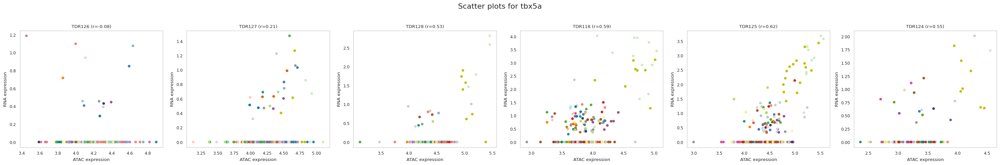

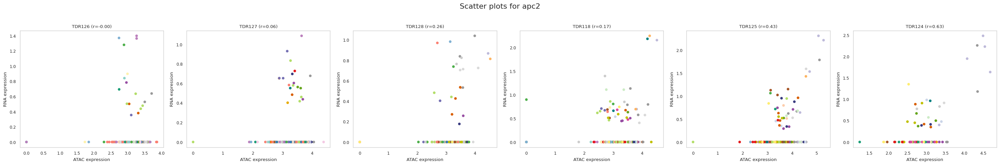

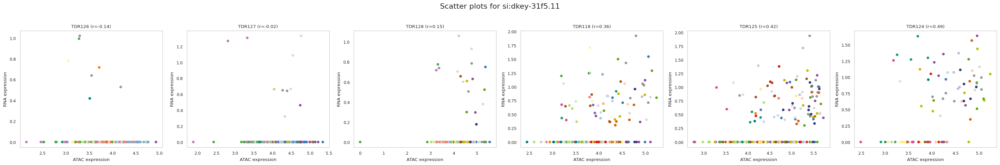

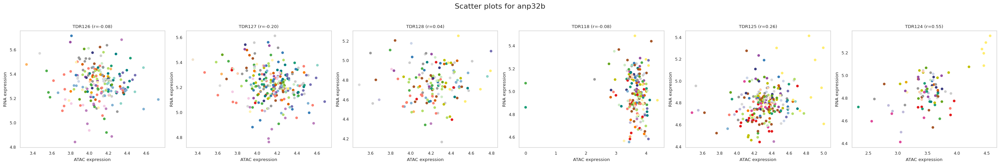

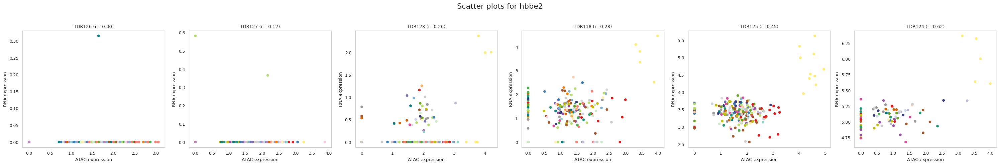

...

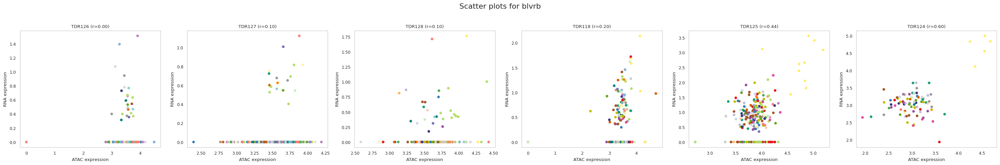

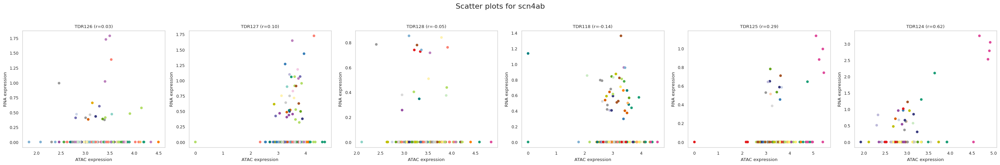

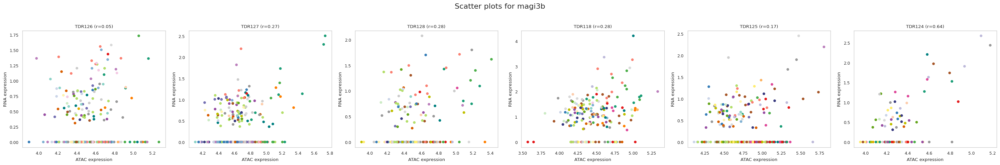

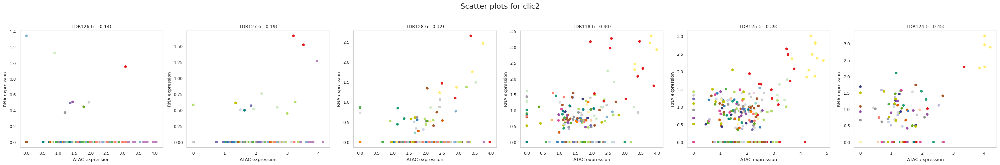

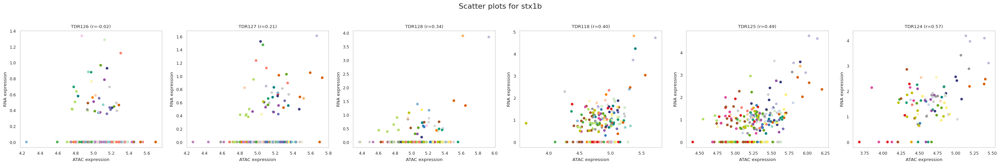

/home/yang-joon.kim/.conda/envs/seacells/lib/python3.8/site-packages/scipy/stats/_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


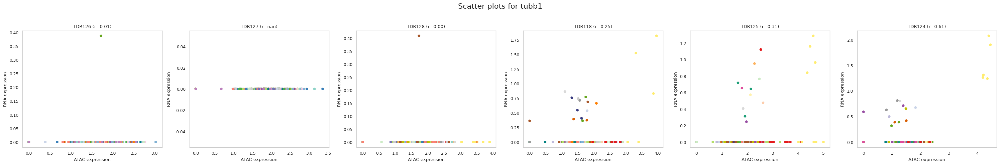

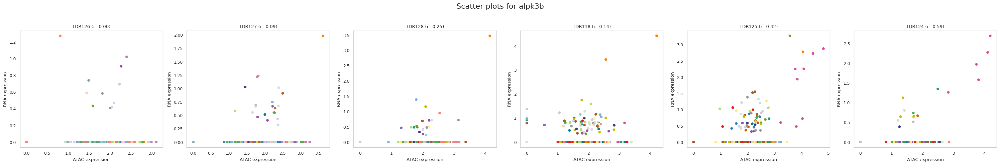

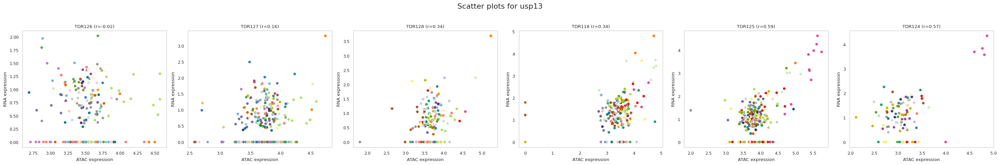

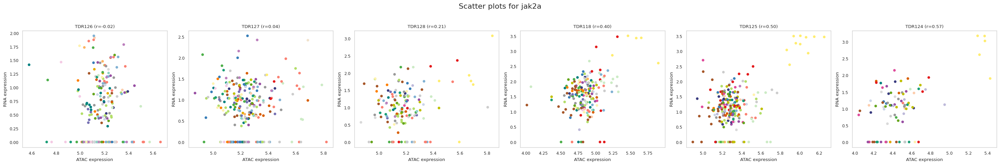

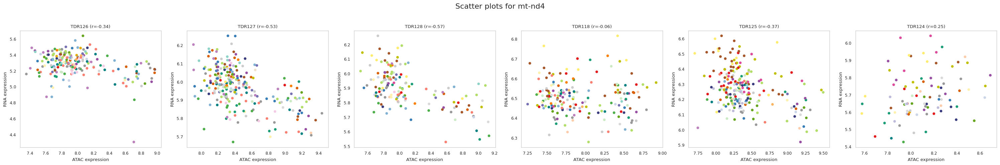

...

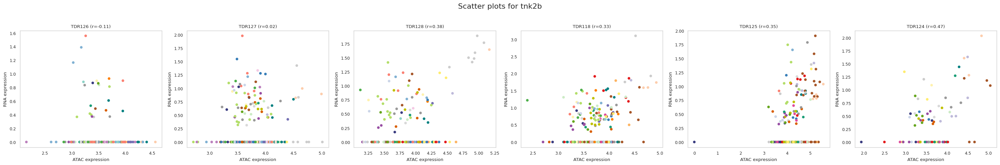

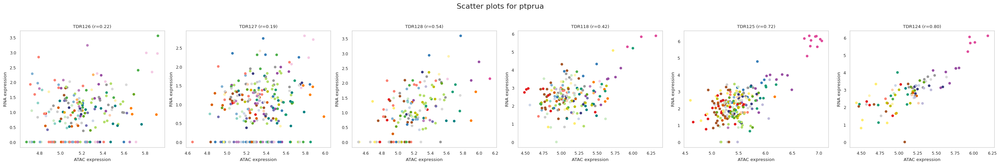

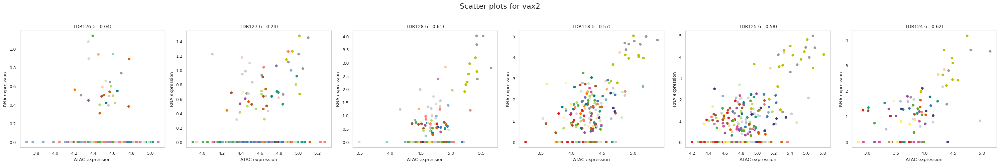

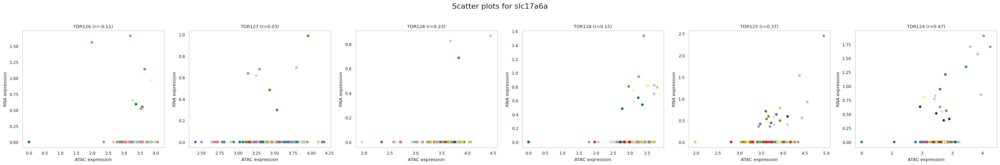

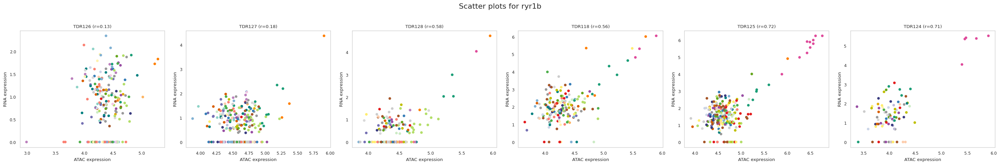

/home/yang-joon.kim/.conda/envs/seacells/lib/python3.8/site-packages/scipy/stats/_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/home/yang-joon.kim/.conda/envs/seacells/lib/python3.8/site-packages/scipy/stats/_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/home/yang-joon.kim/.conda/envs/seacells/lib/python3.8/site-packages/scipy/stats/_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


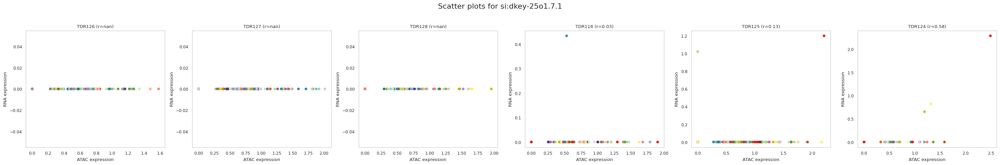

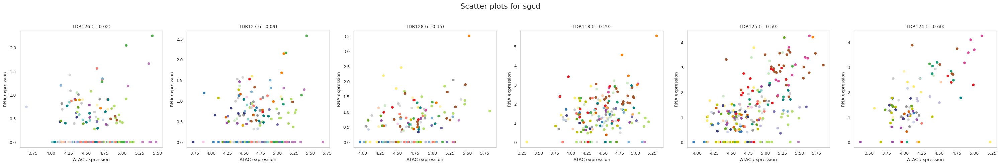

In [576]:
# for each gene, generate the time-resolved scatter plots for the RNA/ATAC correlation
for gene in list_genes_test:
    fig, axs = plt.subplots(1, 6, figsize=(30,5))
    # loop over all timepoints
    for index, sample_id in enumerate(list_timepoints):
        # extract the rna_ad and atac_ad
        rna_ad = dict_meta_ad[f"{sample_id}_rna"]
        atac_ad = dict_meta_ad[f"{sample_id}_atac"]
        
        # compute the correlation between RNA and ATAC
        expr_rna = rna_ad[:, gene].X.toarray().flatten()
        expr_atac = atac_ad[:, gene].X.toarray().flatten()
        
        # if either exp1 or expr2 are "constant", then
        if np.all(expr1 == expr1[0]) or np.all(expr2 == expr2[0]):
            correlation = np.nan
        else:
            correlation, _ = pearsonr(expr_atac, expr_rna)
        
        # Get the cell type for each cell
        cell_types = rna_ad.obs["celltype"]
        
        # Map the cell type to colors
        colors = cell_types.map(cell_type_color_dict)
        
        # Plot the scatter plot for the current timepoint
        axs[index].scatter(expr_atac, expr_rna, color=colors)
        axs[index].set_title(f"{sample_id} (r={correlation:.2f})")
        axs[index].set_xlabel('ATAC expression')
        axs[index].set_ylabel('RNA expression')
        axs[index].grid(False)
        # axs[index].set_xlim([-0.1, 5])
        # axs[index].set_ylim([-0.1, 4])
    
    plt.suptitle(f"Scatter plots for {gene}", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to fit the main title
    plt.savefig(figpath + f"scatter_atac_rna_{gene}.png")
    plt.savefig(figpath + f"scatter_atac_rna_{gene}.pdf")
    plt.show()

In [502]:
# list_dynamic_genes = ['hbbe3',
#  'hbae5',
#  'slc4a1a',
#  'hoxc8a',
#  'myo9b',
#  'sox17',
#  'cdx1a',
#  'wnt9b',
#  'myf5',
#  'msgn1',
#  'tbx6', 'myl1']

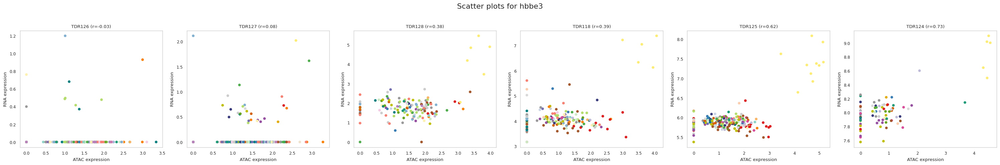

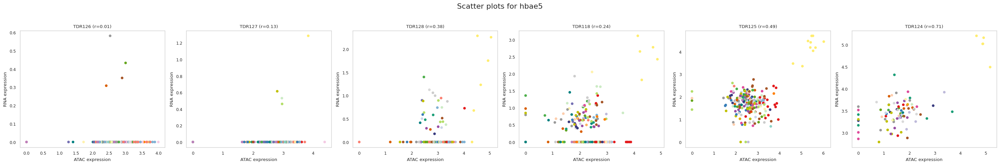

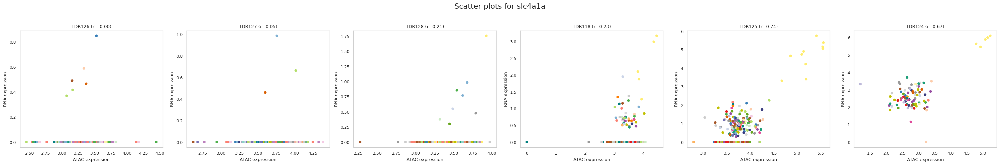

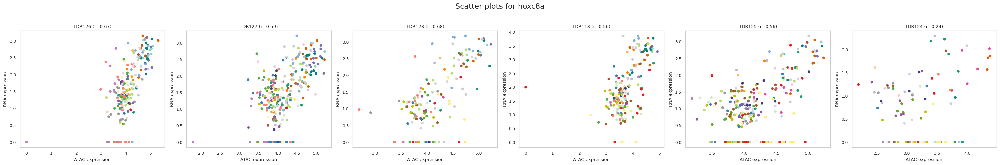

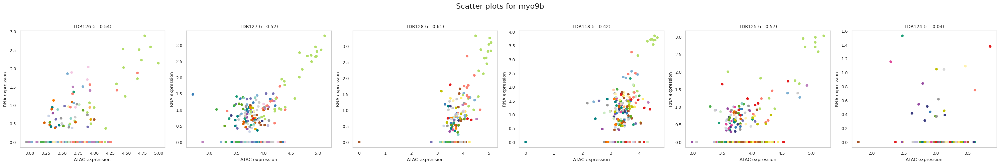

...

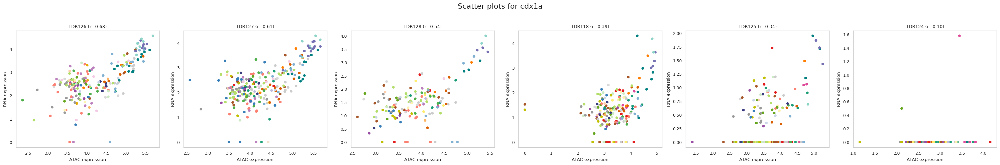

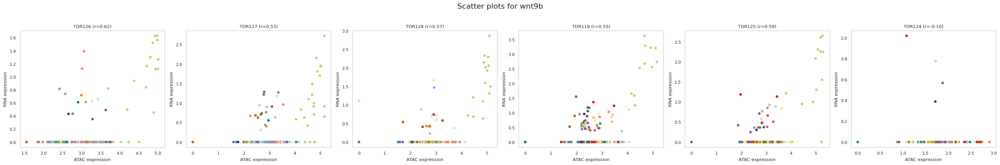

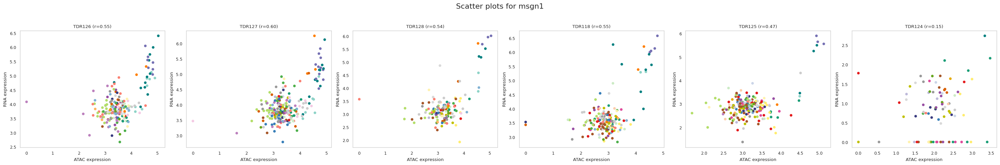

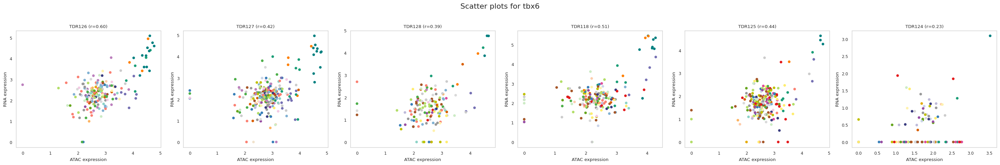

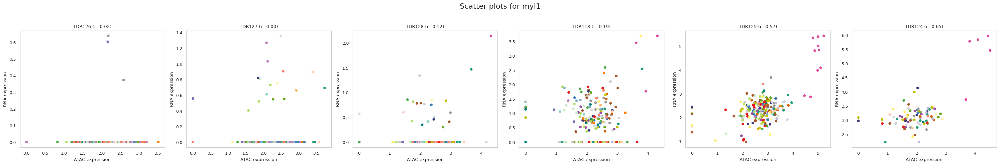

In [575]:
# for each gene, generate the time-resolved scatter plots for the RNA/ATAC correlation
for gene in list_dynamic_genes:
    fig, axs = plt.subplots(1, 6, figsize=(30,5))
    # loop over all timepoints
    for index, sample_id in enumerate(list_timepoints):
        # extract the rna_ad and atac_ad
        rna_ad = dict_meta_ad[f"{sample_id}_rna"]
        atac_ad = dict_meta_ad[f"{sample_id}_atac"]
        
        # compute the correlation between RNA and ATAC
        expr_rna = rna_ad[:, gene].X.toarray().flatten()
        expr_atac = atac_ad[:, gene].X.toarray().flatten()
        
        # if either exp1 or expr2 are "constant", then
        if np.all(expr1 == expr1[0]) or np.all(expr2 == expr2[0]):
            correlation = np.nan
        else:
            correlation, _ = pearsonr(expr_atac, expr_rna)
        
        # Get the cell type for each cell
        cell_types = rna_ad.obs["celltype"]
        
        # Map the cell type to colors
        colors = cell_types.map(cell_type_color_dict)
        
        # Plot the scatter plot for the current timepoint
        axs[index].scatter(expr_atac, expr_rna, color=colors)
        axs[index].set_title(f"{sample_id} (r={correlation:.2f})")
        axs[index].set_xlabel('ATAC expression')
        axs[index].set_ylabel('RNA expression')
        axs[index].grid(False)
        # axs[index].set_xlim([-0.1, 5])
        # axs[index].set_ylim([-0.1, 4])
    
    plt.suptitle(f"Scatter plots for {gene}", fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust layout to fit the main title

    plt.savefig(figpath + f"scatter_atac_rna_{gene}.png")
    plt.savefig(figpath + f"scatter_atac_rna_{gene}.pdf")
    plt.show()

In [586]:
color_dict

{'TDR126': array([0.255645, 0.260703, 0.528312, 1.      ]),
 'TDR127': array([0.180629, 0.429975, 0.557282, 1.      ]),
 'TDR128': array([0.123463, 0.581687, 0.547445, 1.      ]),
 'TDR118': array([0.226397, 0.728888, 0.462789, 1.      ]),
 'TDR125': array([0.575563, 0.844566, 0.256415, 1.      ]),
 'TDR124': array([0.993248, 0.906157, 0.143936, 1.      ])}

Sample ID: TDR126, Gene: hbbe3
RNA expression: [0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.3716678  0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.9308795  0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.48720947 0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.         0.         0.         0.         0.
 0.         0.40032065 0.         0.         0.         0.
 0.         0.         0.         0.         0.4165776  0.
 0.      

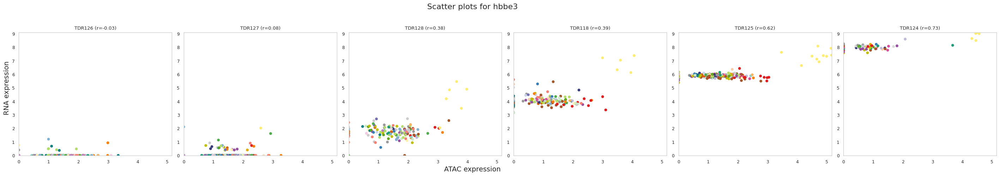

In [587]:
# For each gene, generate the time-resolved scatter plots for the RNA/ATAC correlation
for gene in ["hbbe3"]:
    fig, axs = plt.subplots(1, len(list_timepoints), figsize=(30, 5))
    
    # Initialize lists to collect min and max values
    all_expr_rna = []
    all_expr_atac = []
    
    # Loop over all timepoints
    for index, sample_id in enumerate(list_timepoints):
        # Extract the rna_ad and atac_ad
        rna_ad = dict_meta_ad[f"{sample_id}_rna"]
        atac_ad = dict_meta_ad[f"{sample_id}_atac"]
        
        # Compute the correlation between RNA and ATAC
        expr_rna = rna_ad[:, gene].X.toarray().flatten()
        expr_atac = atac_ad[:, gene].X.toarray().flatten()
        
        # Debugging prints
        print(f"Sample ID: {sample_id}, Gene: {gene}")
        print(f"RNA expression: {expr_rna}")
        print(f"ATAC expression: {expr_atac}")
        
        # Collect values for global min and max calculation
        all_expr_rna.extend(expr_rna)
        all_expr_atac.extend(expr_atac)
        
        # Get the cell type for each cell
        cell_types = rna_ad.obs["celltype"]
        
        # Debugging prints
        print(f"Cell types: {cell_types}")
        
        # Map the cell type to colors
        colors = cell_types.map(cell_type_color_dict)
        
        # Debugging prints
        print(f"Colors: {colors}")
        
        # If either expr_rna or expr_atac are "constant"
        if np.all(expr_rna == expr_rna[0]) or np.all(expr_atac == expr_atac[0]):
            correlation = np.nan
        else:
            correlation, _ = pearsonr(expr_atac, expr_rna)
        
        # Plot the scatter plot for the current timepoint
        scatter = axs[index].scatter(expr_atac, expr_rna, c=colors)
        axs[index].set_title(f"{sample_id} (r={correlation:.2f})")
        axs[index].grid(False)
    
    # Calculate global min and max values for xlim and ylim
    x_min, x_max = min(all_expr_atac), max(all_expr_atac)
    y_min, y_max = min(all_expr_rna), max(all_expr_rna)
    
    # Set consistent xlim and ylim for all subplots
    for ax in axs:
        ax.set_xlim([x_min, x_max])
        ax.set_ylim([y_min, y_max])
        ax.xaxis.set_major_locator(plt.MaxNLocator(integer=True))
        ax.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
        ax.set_xlabel('')
        ax.set_ylabel('')
    
    # Set global x-axis and y-axis labels
    fig.text(0.5, 0.04, 'ATAC expression', ha='center', va='center', fontsize=14)
    fig.text(0.06, 0.5, 'RNA expression', ha='center', va='center', rotation='vertical', fontsize=14)
    
    plt.suptitle(f"Scatter plots for {gene}", fontsize=16)
    plt.tight_layout(rect=[0.06, 0.04, 1, 0.95])  # Adjust layout to fit the main title

    plt.savefig(figpath + f"scatter_atac_rna_{gene}.png")
    plt.savefig(figpath + f"scatter_atac_rna_{gene}.pdf")
    plt.show()

In [46]:
list_markers

['fgfrl1b',
 'col2a1a',
 'ptprfa',
 'emid1',
 'nr5a2',
 'ism2a',
 'pawr',
 'mmp15b',
 'foxa3',
 'onecut1',
 'msgn1',
 'meox1',
 'tbx6',
 'tbxta',
 'fgf8a',
 'her1',
 'pax7a',
 'pax6a',
 'pax6b',
 'col18a1a',
 'en2b',
 'znf536',
 'gpm6aa',
 'gli3',
 'chl1a',
 'lmo2',
 'etv2',
 'tal1',
 'sox17',
 'hbbe3',
 'sox2',
 'myf5',
 'meis1a',
 'meis3',
 'nr2f5']

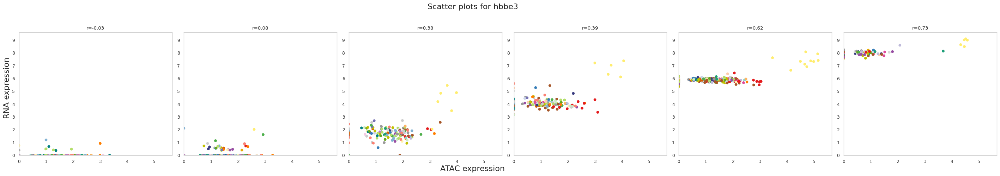

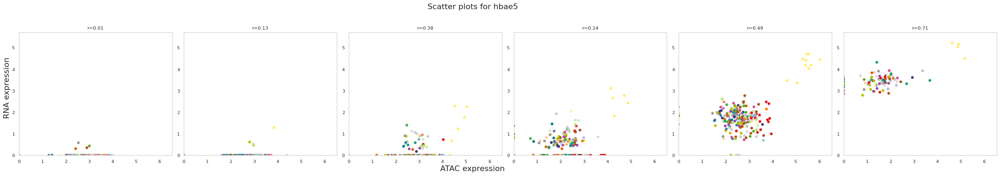

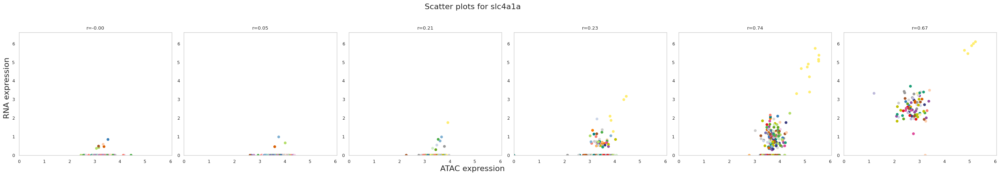

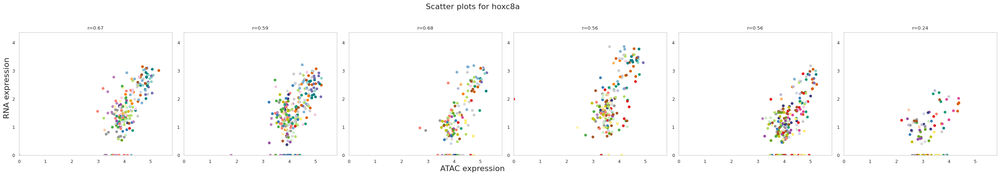

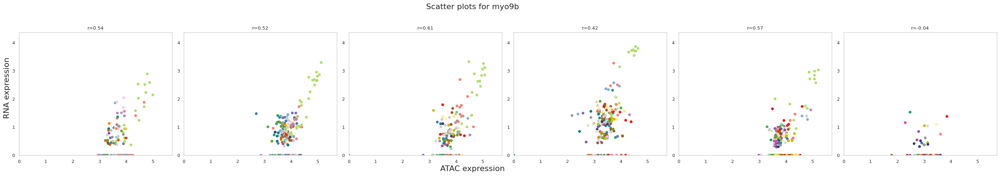

...

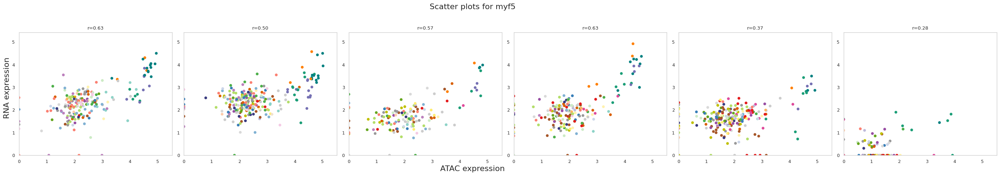

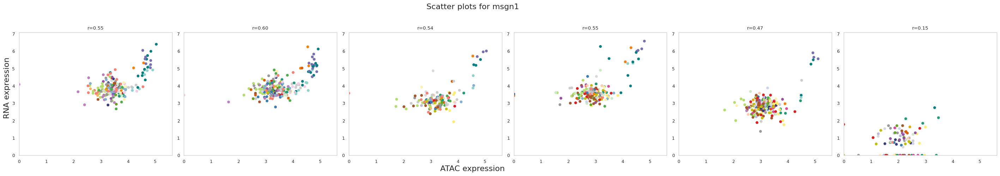

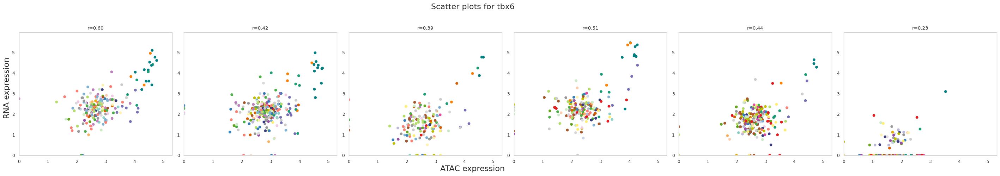

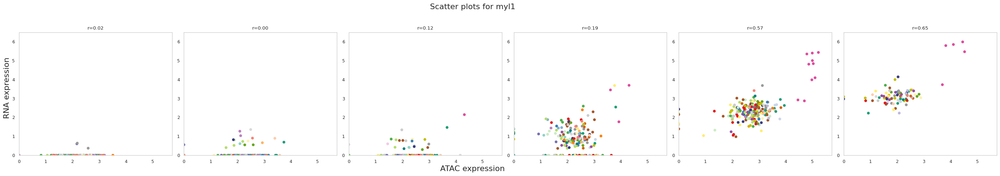

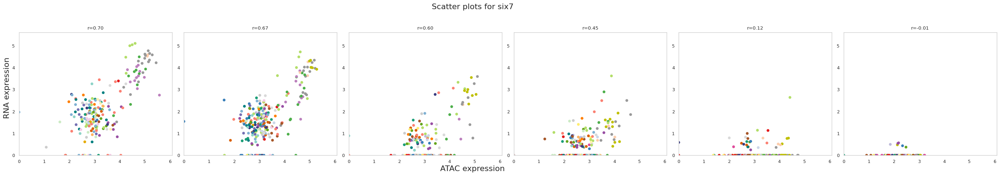

In [51]:
# For each gene, generate the time-resolved scatter plots for the RNA/ATAC correlation
for gene in list_dynamic_genes:
    fig, axs = plt.subplots(1, len(list_timepoints), figsize=(30, 5))
    
    # Initialize lists to collect min and max values
    all_expr_rna = []
    all_expr_atac = []
    
    # Loop over all timepoints
    for index, sample_id in enumerate(list_timepoints):
        # Extract the rna_ad and atac_ad
        rna_ad = dict_meta_ad[f"{sample_id}_rna"]
        atac_ad = dict_meta_ad[f"{sample_id}_atac"]
        
        # Compute the correlation between RNA and ATAC
        expr_rna = rna_ad[:, gene].X.toarray().flatten()
        expr_atac = atac_ad[:, gene].X.toarray().flatten()
        
        # Collect values for global min and max calculation
        all_expr_rna.extend(expr_rna)
        all_expr_atac.extend(expr_atac)
        
        # Get the cell type for each cell
        cell_types = rna_ad.obs["celltype"]
        
        # Map the cell type to colors
        colors = cell_types.map(cell_type_color_dict)
        
        # If either expr_rna or expr_atac are "constant"
        if np.all(expr_rna == expr_rna[0]) or np.all(expr_atac == expr_atac[0]):
            correlation = np.nan
        else:
            correlation, _ = pearsonr(expr_atac, expr_rna)
        
        # Plot the scatter plot for the current timepoint
        axs[index].scatter(expr_atac, expr_rna, c=colors)
        axs[index].set_title(f"r={correlation:.2f}")
        axs[index].grid(False)
    
    # Calculate global min and max values for xlim and ylim
    x_min, x_max = min(all_expr_atac), max(all_expr_atac)
    y_min, y_max = min(all_expr_rna), max(all_expr_rna)
    
    # Set consistent xlim and ylim for all subplots
    for ax in axs:
        ax.set_xlim([x_min, x_max+0.5])
        ax.set_ylim([y_min, y_max+0.5])
        ax.xaxis.set_major_locator(plt.MaxNLocator(integer=True))
        ax.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
        ax.set_xlabel('')
        ax.set_ylabel('')
    
    # Set global x-axis and y-axis labels
    fig.text(0.5, 0.04, 'ATAC expression', ha='center', va='center', fontsize=16)
    fig.text(0.06, 0.5, 'RNA expression', ha='center', va='center', rotation='vertical', fontsize=16)
    
    plt.suptitle(f"Scatter plots for {gene}", fontsize=16)
    plt.tight_layout(rect=[0.06, 0.04, 1, 0.95])  # Adjust layout to fit the main title
    plt.savefig(figpath + f"scatter_atac_rna_{gene}.png")
    plt.savefig(figpath + f"scatter_atac_rna_{gene}.pdf")
    plt.show()

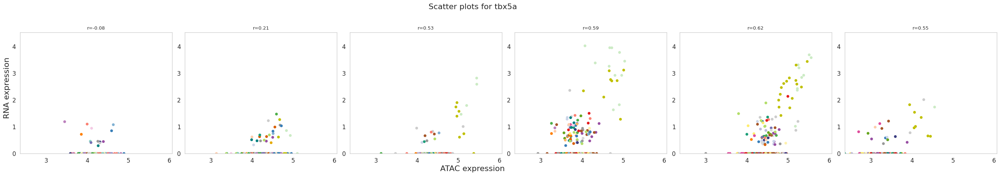

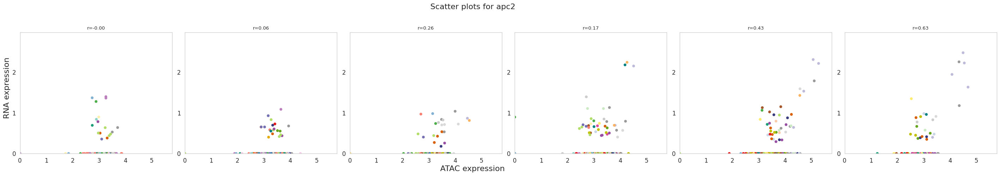

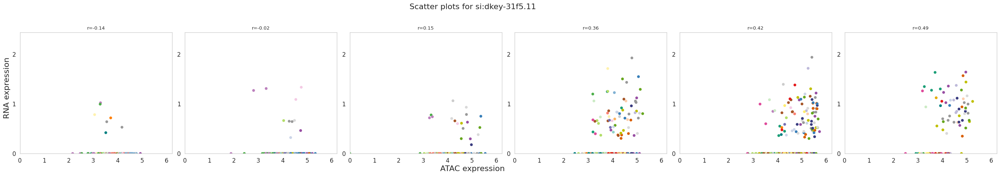

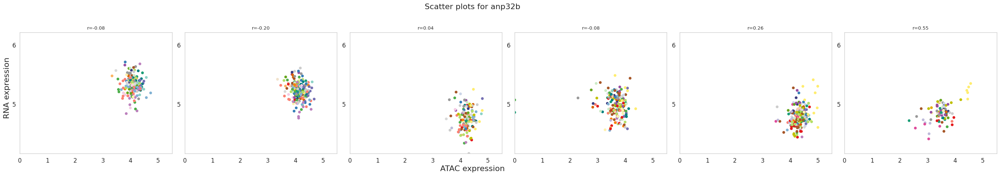

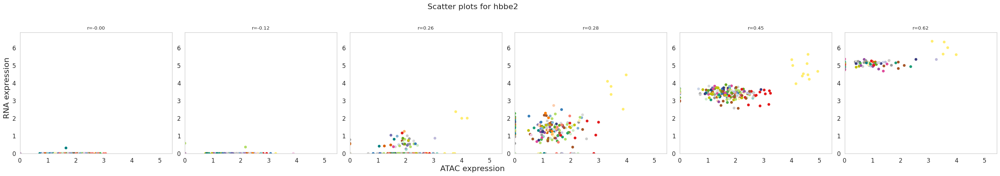

...

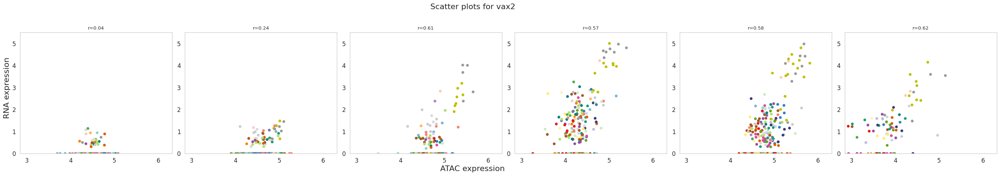

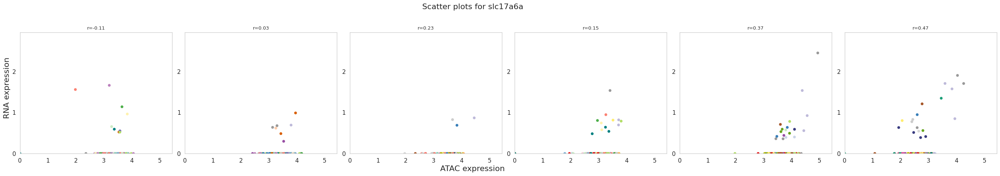

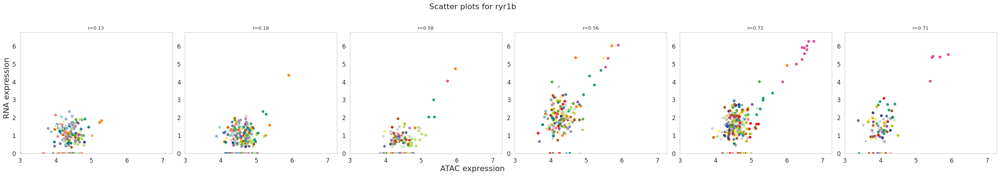

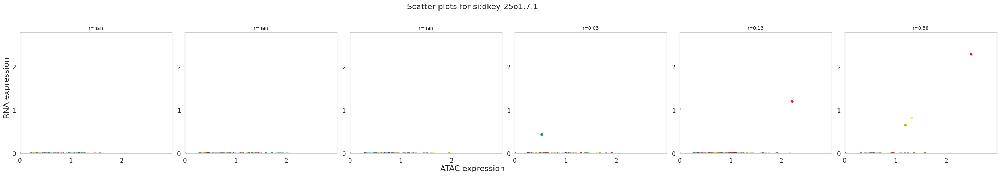

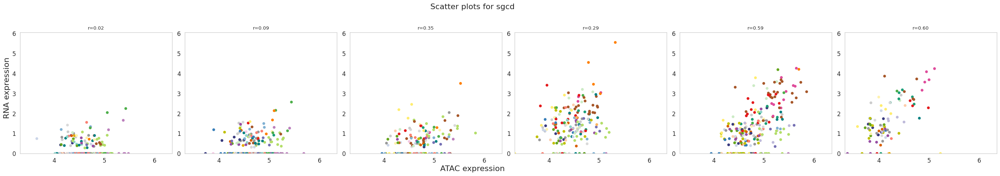

In [55]:
# For each gene, generate the time-resolved scatter plots for the RNA/ATAC correlation
for gene in list_genes_test:
    fig, axs = plt.subplots(1, len(list_timepoints), figsize=(30, 5))
    
    # Initialize lists to collect min and max values
    all_expr_rna = []
    all_expr_atac = []
    
    # Loop over all timepoints
    for index, sample_id in enumerate(list_timepoints):
        # Extract the rna_ad and atac_ad
        rna_ad = dict_meta_ad[f"{sample_id}_rna"]
        atac_ad = dict_meta_ad[f"{sample_id}_atac"]
        
        # Compute the correlation between RNA and ATAC
        expr_rna = rna_ad[:, gene].X.toarray().flatten()
        expr_atac = atac_ad[:, gene].X.toarray().flatten()
        
        # Collect values for global min and max calculation
        all_expr_rna.extend(expr_rna)
        all_expr_atac.extend(expr_atac)
        
        # Get the cell type for each cell
        cell_types = rna_ad.obs["celltype"]
        
        # Map the cell type to colors
        colors = cell_types.map(cell_type_color_dict)
        
        # If either expr_rna or expr_atac are "constant"
        if np.all(expr_rna == expr_rna[0]) or np.all(expr_atac == expr_atac[0]):
            correlation = np.nan
        else:
            correlation, _ = pearsonr(expr_atac, expr_rna)
        
        # Plot the scatter plot for the current timepoint
        axs[index].scatter(expr_atac, expr_rna, c=colors)
        axs[index].set_title(f"r={correlation:.2f}")
        axs[index].tick_params(axis='x', labelsize=12)
        axs[index].tick_params(axis='y', labelsize=12)
        axs[index].grid(False)
    
    # Calculate global min and max values for xlim and ylim
    x_min, x_max = min(all_expr_atac), max(all_expr_atac)
    y_min, y_max = min(all_expr_rna), max(all_expr_rna)
    
    # Set consistent xlim and ylim for all subplots
    for ax in axs:
        ax.set_xlim([x_min, x_max+0.5])
        ax.set_ylim([y_min, y_max+0.5])
        ax.xaxis.set_major_locator(plt.MaxNLocator(integer=True))
        ax.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
        ax.set_xlabel('')
        ax.set_ylabel('')
    
    # Set global x-axis and y-axis labels
    fig.text(0.5, 0.04, 'ATAC expression', ha='center', va='center', fontsize=16)
    fig.text(0.06, 0.5, 'RNA expression', ha='center', va='center', rotation='vertical', fontsize=16)
    
    plt.suptitle(f"Scatter plots for {gene}", fontsize=16)
    plt.tight_layout(rect=[0.06, 0.04, 1, 0.95])  # Adjust layout to fit the main title
    plt.savefig(figpath + f"scatter_atac_rna_{gene}.png")
    plt.savefig(figpath + f"scatter_atac_rna_{gene}.pdf")
    plt.show()

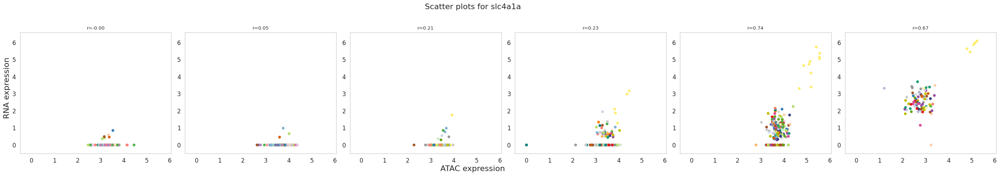

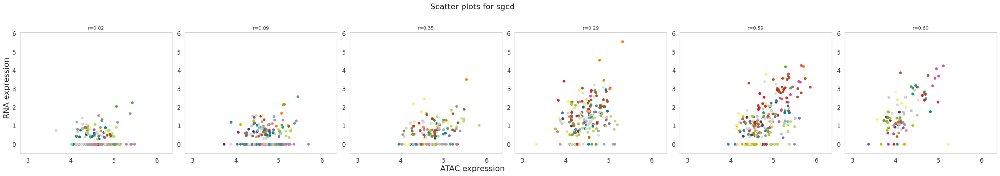

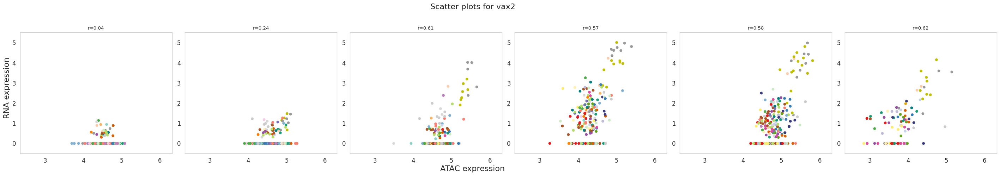

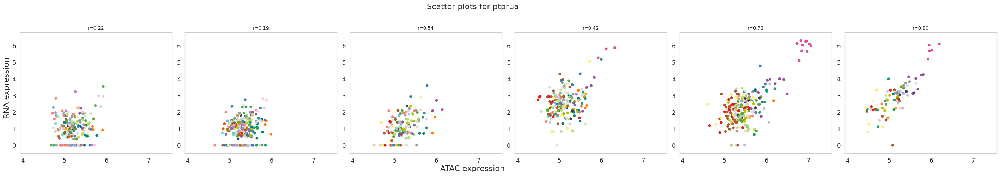

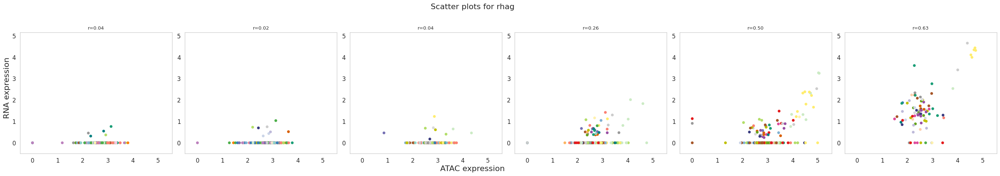

...

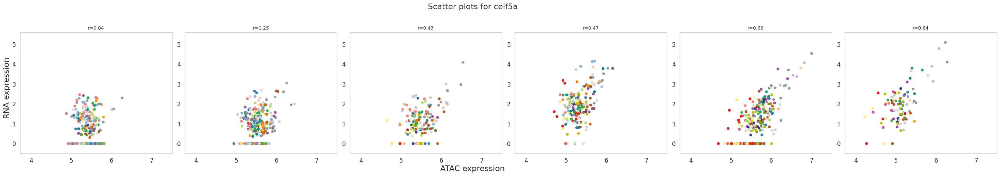

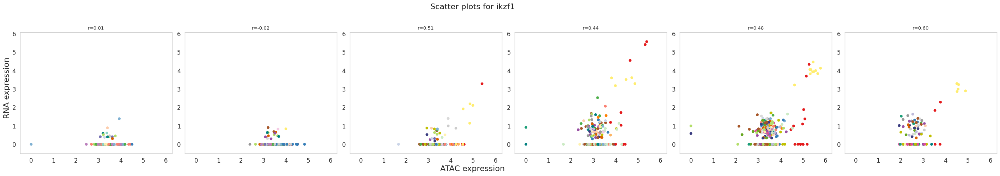

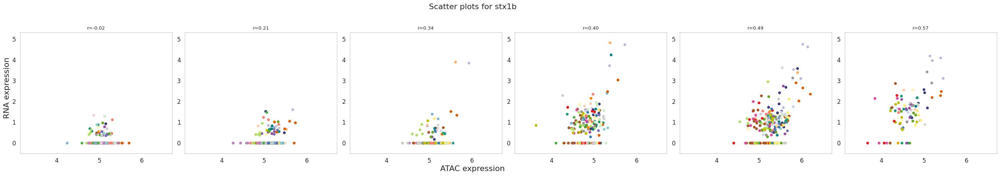

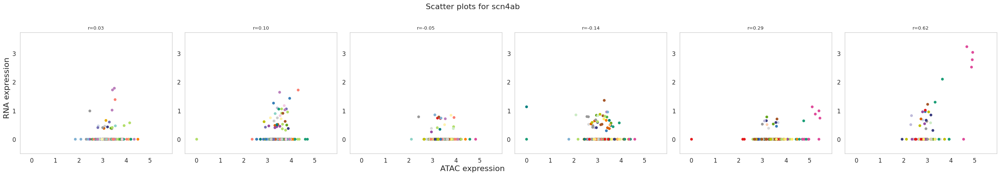

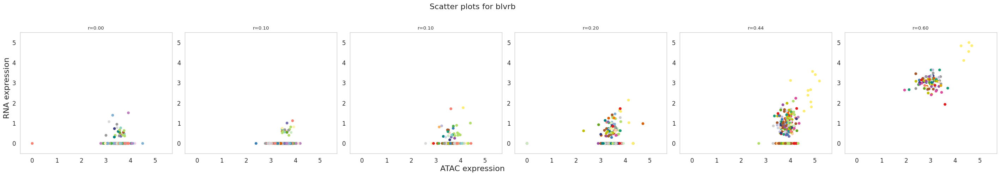

In [61]:
# For each gene, generate the time-resolved scatter plots for the RNA/ATAC correlation

# define the list of genes (increasing correlation)
list_genes_manual = ["slc4a1a","sgcd","vax2","ptprua","rhag",
                     "tbx5a","gabbr1b","vwa7","celf5a","ikzf1",
                     "stx1b","scn4ab","blvrb"]

for gene in list_genes_manual:
    fig, axs = plt.subplots(1, len(list_timepoints), figsize=(30, 5))
    
    # Initialize lists to collect min and max values
    all_expr_rna = []
    all_expr_atac = []
    
    # Loop over all timepoints
    for index, sample_id in enumerate(list_timepoints):
        # Extract the rna_ad and atac_ad
        rna_ad = dict_meta_ad[f"{sample_id}_rna"]
        atac_ad = dict_meta_ad[f"{sample_id}_atac"]
        
        # Compute the correlation between RNA and ATAC
        expr_rna = rna_ad[:, gene].X.toarray().flatten()
        expr_atac = atac_ad[:, gene].X.toarray().flatten()
        
        # Collect values for global min and max calculation
        all_expr_rna.extend(expr_rna)
        all_expr_atac.extend(expr_atac)
        
        # Get the cell type for each cell
        cell_types = rna_ad.obs["celltype"]
        
        # Map the cell type to colors
        colors = cell_types.map(cell_type_color_dict)
        
        # If either expr_rna or expr_atac are "constant"
        if np.all(expr_rna == expr_rna[0]) or np.all(expr_atac == expr_atac[0]):
            correlation = np.nan
        else:
            correlation, _ = pearsonr(expr_atac, expr_rna)
        
        # Plot the scatter plot for the current timepoint
        axs[index].scatter(expr_atac, expr_rna, c=colors)
        axs[index].set_title(f"r={correlation:.2f}")
        axs[index].tick_params(axis='x', labelsize=12)
        axs[index].tick_params(axis='y', labelsize=12)
        axs[index].grid(False)
    
    # Calculate global min and max values for xlim and ylim
    x_min, x_max = min(all_expr_atac)-0.5, max(all_expr_atac)
    y_min, y_max = min(all_expr_rna)-0.5, max(all_expr_rna)
    
    # Set consistent xlim and ylim for all subplots
    for ax in axs:
        ax.set_xlim([x_min, x_max+0.5])
        ax.set_ylim([y_min, y_max+0.5])
        ax.xaxis.set_major_locator(plt.MaxNLocator(integer=True))
        ax.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
        ax.set_xlabel('')
        ax.set_ylabel('')
    
    # Set global x-axis and y-axis labels
    fig.text(0.5, 0.04, 'ATAC expression', ha='center', va='center', fontsize=16)
    fig.text(0.06, 0.5, 'RNA expression', ha='center', va='center', rotation='vertical', fontsize=16)
    
    plt.suptitle(f"Scatter plots for {gene}", fontsize=16)
    plt.tight_layout(rect=[0.06, 0.04, 1, 0.95])  # Adjust layout to fit the main title
    plt.savefig(figpath + f"scatter_atac_rna_{gene}.png")
    plt.savefig(figpath + f"scatter_atac_rna_{gene}.pdf")
    plt.show()

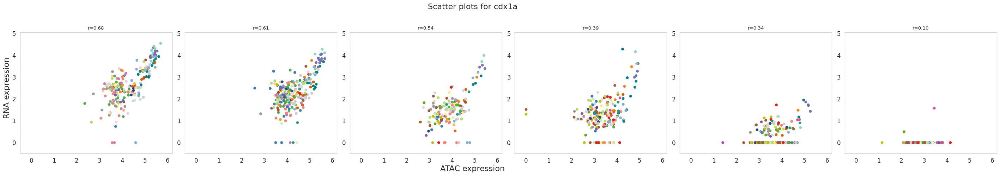

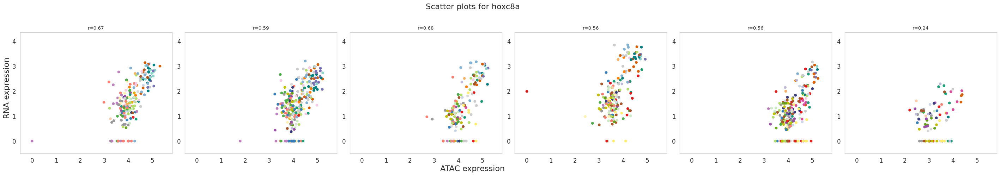

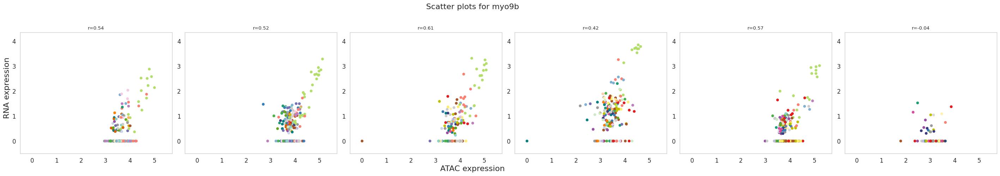

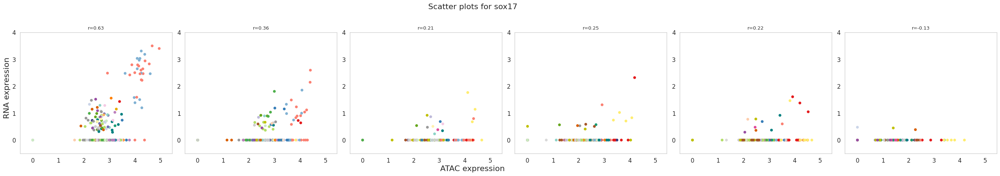

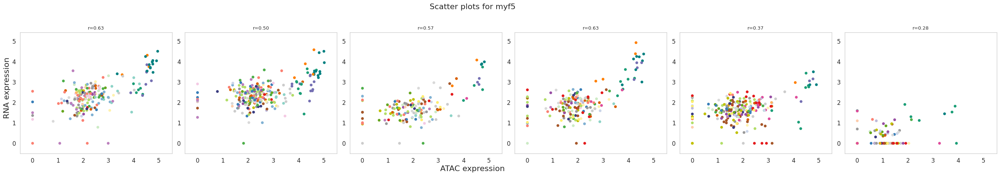

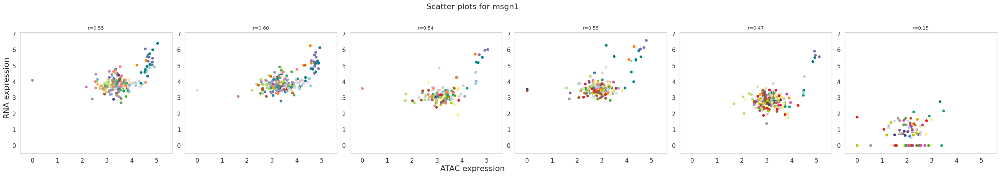

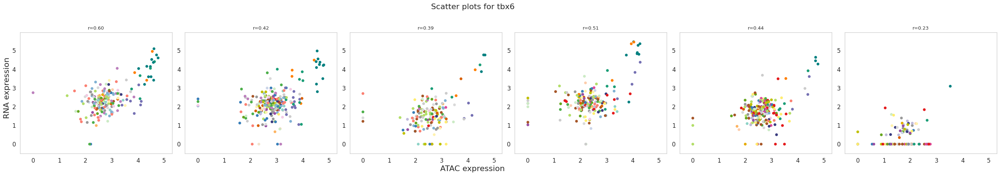

In [60]:
# For each gene, generate the time-resolved scatter plots for the RNA/ATAC correlation

# define the list of genes (increasing correlation)
list_genes_manual_down = ["cdx1a","hoxc8a","myo9b","sox17",
                          "myf5","msgn1","tbx6"]

for gene in list_genes_manual_down:
    fig, axs = plt.subplots(1, len(list_timepoints), figsize=(30, 5))
    
    # Initialize lists to collect min and max values
    all_expr_rna = []
    all_expr_atac = []
    
    # Loop over all timepoints
    for index, sample_id in enumerate(list_timepoints):
        # Extract the rna_ad and atac_ad
        rna_ad = dict_meta_ad[f"{sample_id}_rna"]
        atac_ad = dict_meta_ad[f"{sample_id}_atac"]
        
        # Compute the correlation between RNA and ATAC
        expr_rna = rna_ad[:, gene].X.toarray().flatten()
        expr_atac = atac_ad[:, gene].X.toarray().flatten()
        
        # Collect values for global min and max calculation
        all_expr_rna.extend(expr_rna)
        all_expr_atac.extend(expr_atac)
        
        # Get the cell type for each cell
        cell_types = rna_ad.obs["celltype"]
        
        # Map the cell type to colors
        colors = cell_types.map(cell_type_color_dict)
        
        # If either expr_rna or expr_atac are "constant"
        if np.all(expr_rna == expr_rna[0]) or np.all(expr_atac == expr_atac[0]):
            correlation = np.nan
        else:
            correlation, _ = pearsonr(expr_atac, expr_rna)
        
        # Plot the scatter plot for the current timepoint
        axs[index].scatter(expr_atac, expr_rna, c=colors)
        axs[index].set_title(f"r={correlation:.2f}")
        axs[index].tick_params(axis='x', labelsize=12)
        axs[index].tick_params(axis='y', labelsize=12)
        axs[index].grid(False)
    
    # Calculate global min and max values for xlim and ylim
    x_min, x_max = min(all_expr_atac)-0.5, max(all_expr_atac)
    y_min, y_max = min(all_expr_rna)-0.5, max(all_expr_rna)
    
    # Set consistent xlim and ylim for all subplots
    for ax in axs:
        ax.set_xlim([x_min, x_max+0.5])
        ax.set_ylim([y_min, y_max+0.5])
        ax.xaxis.set_major_locator(plt.MaxNLocator(integer=True))
        ax.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
        ax.set_xlabel('')
        ax.set_ylabel('')
    
    # Set global x-axis and y-axis labels
    fig.text(0.5, 0.04, 'ATAC expression', ha='center', va='center', fontsize=16)
    fig.text(0.06, 0.5, 'RNA expression', ha='center', va='center', rotation='vertical', fontsize=16)
    
    plt.suptitle(f"Scatter plots for {gene}", fontsize=16)
    plt.tight_layout(rect=[0.06, 0.04, 1, 0.95])  # Adjust layout to fit the main title
    plt.savefig(figpath + f"scatter_atac_rna_{gene}.png")
    plt.savefig(figpath + f"scatter_atac_rna_{gene}.pdf")
    plt.show()

### save as a combined pdf doument

In [54]:
from matplotlib.backends.backend_pdf import PdfPages

# Initialize PdfPages object
pdf_pages = PdfPages(figpath + "scatter_atac_rna_up_corr.pdf")

# define the list of genes (increasing correlation)
list_genes_manual = ["slc4a1a","sgcd","vax2","ptprua","rhag",
                     "tbx5a","gabbr1b","vwa7","celf5a","ikzf1",
                     "stx1b","scn4ab","blvrb"]
# For each gene, generate the time-resolved scatter plots for the RNA/ATAC correlation
for gene in list_genes_manual:
    fig, axs = plt.subplots(1, len(list_timepoints), figsize=(30, 5))
    
    # Initialize lists to collect min and max values
    all_expr_rna = []
    all_expr_atac = []
    
    # Loop over all timepoints
    for index, sample_id in enumerate(list_timepoints):
        # Extract the rna_ad and atac_ad
        rna_ad = dict_meta_ad[f"{sample_id}_rna"]
        atac_ad = dict_meta_ad[f"{sample_id}_atac"]
        
        # Compute the correlation between RNA and ATAC
        expr_rna = rna_ad[:, gene].X.toarray().flatten()
        expr_atac = atac_ad[:, gene].X.toarray().flatten()
        
        # Collect values for global min and max calculation
        all_expr_rna.extend(expr_rna)
        all_expr_atac.extend(expr_atac)
        
        # Get the cell type for each cell
        cell_types = rna_ad.obs["celltype"]
        
        # Map the cell type to colors
        colors = cell_types.map(cell_type_color_dict)
        
        # If either expr_rna or expr_atac are "constant"
        if np.all(expr_rna == expr_rna[0]) or np.all(expr_atac == expr_atac[0]):
            correlation = np.nan
        else:
            correlation, _ = pearsonr(expr_atac, expr_rna)
        
        # Plot the scatter plot for the current timepoint
        axs[index].scatter(expr_atac, expr_rna, c=colors)
        axs[index].set_title(f"r={correlation:.2f}")
        axs[index].tick_params(axis='x', labelsize=12)
        axs[index].tick_params(axis='y', labelsize=12)
        axs[index].grid(False)
    
    # Calculate global min and max values for xlim and ylim
    x_min, x_max = min(all_expr_atac), max(all_expr_atac)
    y_min, y_max = min(all_expr_rna), max(all_expr_rna)
    
    # Set consistent xlim and ylim for all subplots
    for ax in axs:
        ax.set_xlim([x_min, x_max+0.5])
        ax.set_ylim([y_min, y_max+0.5])
        ax.xaxis.set_major_locator(plt.MaxNLocator(integer=True))
        ax.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
        ax.set_xlabel('')
        ax.set_ylabel('')
        # ax.tick_params(axis='x', labelsize=12)
        # ax.tick_params(axis='y', labelsize=12)
    
    # Set global x-axis and y-axis labels
    fig.text(0.5, 0.04, 'ATAC expression', ha='center', va='center', fontsize=16)
    fig.text(0.06, 0.5, 'RNA expression', ha='center', va='center', rotation='vertical', fontsize=16)
    
    plt.suptitle(f"Scatter plots for {gene}", fontsize=16)
    plt.tight_layout(rect=[0.06, 0.04, 1, 0.95])  # Adjust layout to fit the main title
    
    # Save the current figure to the PDF file
    pdf_pages.savefig(fig)
    plt.close(fig)
    # plt.savefig(figpath + f"scatter_atac_rna_{gene}.png")
    # plt.savefig(figpath + f"scatter_atac_rna_{gene}.pdf")
    # plt.show()
    
# Close the PDF file
pdf_pages.close()

In [59]:
from matplotlib.backends.backend_pdf import PdfPages

# Initialize PdfPages object
pdf_pages = PdfPages(figpath + "scatter_atac_rna_down_corr.pdf")

# define the list of genes (increasing correlation)
list_genes_manual_down = ["cdx1a","hoxc8a","myo9b","sox17",
                          "myf5","msgn1","tbx6"]
# For each gene, generate the time-resolved scatter plots for the RNA/ATAC correlation
for gene in list_genes_manual_down:
    fig, axs = plt.subplots(1, len(list_timepoints), figsize=(30, 5))
    
    # Initialize lists to collect min and max values
    all_expr_rna = []
    all_expr_atac = []
    
    # Loop over all timepoints
    for index, sample_id in enumerate(list_timepoints):
        # Extract the rna_ad and atac_ad
        rna_ad = dict_meta_ad[f"{sample_id}_rna"]
        atac_ad = dict_meta_ad[f"{sample_id}_atac"]
        
        # Compute the correlation between RNA and ATAC
        expr_rna = rna_ad[:, gene].X.toarray().flatten()
        expr_atac = atac_ad[:, gene].X.toarray().flatten()
        
        # Collect values for global min and max calculation
        all_expr_rna.extend(expr_rna)
        all_expr_atac.extend(expr_atac)
        
        # Get the cell type for each cell
        cell_types = rna_ad.obs["celltype"]
        
        # Map the cell type to colors
        colors = cell_types.map(cell_type_color_dict)
        
        # If either expr_rna or expr_atac are "constant"
        if np.all(expr_rna == expr_rna[0]) or np.all(expr_atac == expr_atac[0]):
            correlation = np.nan
        else:
            correlation, _ = pearsonr(expr_atac, expr_rna)
        
        # Plot the scatter plot for the current timepoint
        axs[index].scatter(expr_atac, expr_rna, c=colors)
        axs[index].set_title(f"r={correlation:.2f}")
        axs[index].tick_params(axis='x', labelsize=12)
        axs[index].tick_params(axis='y', labelsize=12)
        axs[index].grid(False)
    
    # Calculate global min and max values for xlim and ylim
    x_min, x_max = min(all_expr_atac)-0.5, max(all_expr_atac)
    y_min, y_max = min(all_expr_rna)-0.5, max(all_expr_rna)
    
    # Set consistent xlim and ylim for all subplots
    for ax in axs:
        ax.set_xlim([x_min, x_max+0.5])
        ax.set_ylim([y_min, y_max+0.5])
        ax.xaxis.set_major_locator(plt.MaxNLocator(integer=True))
        ax.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
        ax.set_xlabel('')
        ax.set_ylabel('')
        # ax.tick_params(axis='x', labelsize=12)
        # ax.tick_params(axis='y', labelsize=12)
    
    # Set global x-axis and y-axis labels
    fig.text(0.5, 0.04, 'ATAC expression', ha='center', va='center', fontsize=16)
    fig.text(0.06, 0.5, 'RNA expression', ha='center', va='center', rotation='vertical', fontsize=16)
    
    plt.suptitle(f"Scatter plots for {gene}", fontsize=16)
    plt.tight_layout(rect=[0.06, 0.04, 1, 0.95])  # Adjust layout to fit the main title
    
    # Save the current figure to the PDF file
    pdf_pages.savefig(fig)
    plt.close(fig)
    # plt.savefig(figpath + f"scatter_atac_rna_{gene}.png")
    # plt.savefig(figpath + f"scatter_atac_rna_{gene}.pdf")
    # plt.show()
    
# Close the PDF file
pdf_pages.close()

In [299]:
df.sort_values("TDR126", ascending=False).head(50)

,TDR126,TDR127,TDR128,TDR118reseq,TDR125reseq,TDR124reseq
Gene,,,,,,
hoxc3a,0.866139,0.855971,0.847907,0.829136,0.823551,0.727041
fn1b,0.865558,0.832018,0.812008,0.662717,0.570770,0.212720
kif26ab,0.861861,0.822220,0.801570,0.767572,0.768728,0.419436
arid3c,0.844530,0.853274,0.896924,0.797143,0.802247,0.732063
mllt3,0.843240,0.799796,0.830203,0.842943,0.773835,0.547732
zfpm1,0.843073,0.797670,0.861733,0.856681,0.804837,0.721155
rarga,0.835975,0.772564,0.811568,0.822974,0.735902,0.717844
hoxc6b,0.831218,0.741006,0.764294,0.699547,0.662788,0.520796
col18a1a,0.826065,0.746462,0.765877,0.738794,0.681238,0.657542


In [499]:
figpath

'/hpc/projects/data.science/yangjoon.kim/zebrahub_multiome/zebrahub-multiome-analysis/figures/RNA_ATAC_corr_seacells/'

### gene-level analysis



In [67]:
df_corr.drop("Cluster", axis=1, inplace=True)

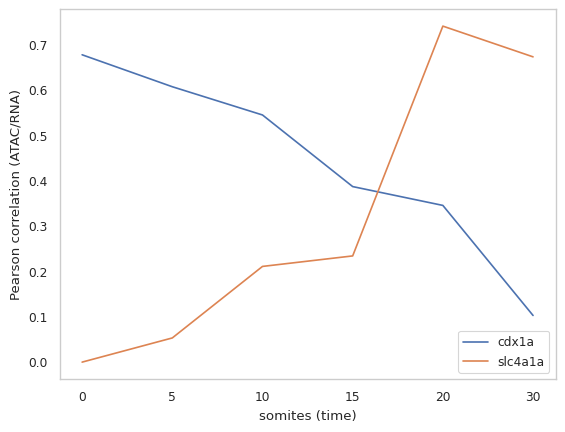

In [73]:
gene1 = "cdx1a"
gene2 = "slc4a1a"

plt.plot(list_timepoints, df_corr.loc["cdx1a"])
plt.plot(list_timepoints, df_corr.loc["slc4a1a"])
# plt.scatter(list_timepoints, df.loc["myf5"])
plt.xticks(ticks = list_timepoints,labels=[0, 5, 10, 15, 20, 30])
plt.xlabel("somites (time)")
plt.ylabel("Pearson correlation (ATAC/RNA)")
plt.legend([f"{gene1}",f"{gene2}"])
plt.grid(False)
plt.savefig(figpath + f"corr_coeff_dynamics_{gene1}_{gene2}.pdf")
plt.show()

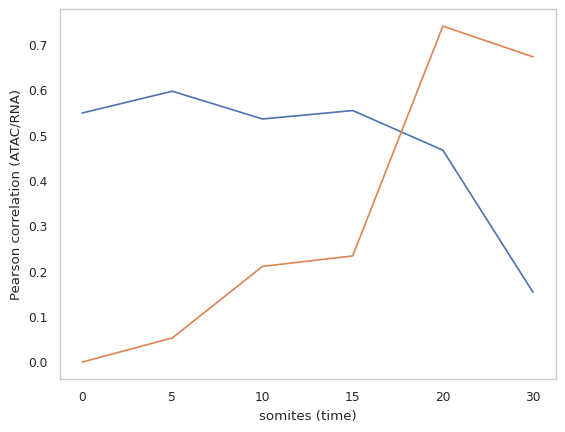

In [501]:
plt.plot(list_timepoints, df.loc["msgn1"])
plt.plot(list_timepoints, df.loc["slc4a1a"])
# plt.scatter(list_timepoints, df.loc["myf5"])
plt.xticks(ticks = list_timepoints,labels=[0, 5, 10, 15, 20, 30])
plt.xlabel("somites (time)")
plt.ylabel("Pearson correlation (ATAC/RNA)")
plt.grid(False)
plt.savefig(figpath + "corr_coeff_dynamics_msgn1_slc4a1a.pdf")
plt.show()